In [1]:
### Prepare module structure ###

import sys
sys.path.append("../")

In [2]:
### IMPORT ###

import numpy as np
import math
import pandas as pd

import torch
import torch.nn as nn
import torch.optim as optim

import time

import matplotlib.pyplot as plt
%matplotlib inline

from util import *
import data
import models

# auto reload imports on local changes
%load_ext autoreload
%autoreload 2
print(torch.__version__)

1.0.0


In [3]:
### Check device ###

USE_GPU = True

dtype = torch.float32

if USE_GPU and torch.cuda.is_available():
    # TODO: Change to CPU used!
    device = torch.device('cuda:0')
else:
    device = torch.device('cpu')

print('using device:', device)

using device: cuda:0


0it [00:00, ?it/s]

cifar


100%|█████████▉| 169730048/170498071 [00:21<00:00, 11399741.41it/s]

Extracting /home/shared/phase-retrieval/data/cifar/cifar-10-python.tar.gz to /home/shared/phase-retrieval/data/cifar
Files already downloaded and verified
Files already downloaded and verified


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


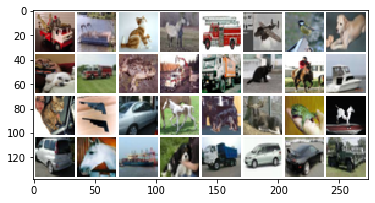

torch.Size([32, 3, 32, 32])


In [4]:
### LOAD DATA ###

dataset = 'cifar'
dataloader, imsize = data.load(dataset, path='/home/shared/phase-retrieval/data/' + dataset, batch_size=32)

sample = next(iter(dataloader['train']))
sample_ft =  torch.rfft(sample, 2, onesided=False)
sample_magnitudes = torch.sqrt(torch.sum(sample_ft ** 2, -1))

plot_grid(sample)
print(sample_magnitudes.shape)

In [5]:
# Function to compute test images

def test_generator(model, device, testloader):
    # put model to eval mode
    model = model.to(device=device)
    model.eval()

    # move test images to device and reduce to magnitude information in fourier space
    test_images = []
    outputs = []
    
    for data in testloader:
        data = data.to(device=device)
        ft = torch.rfft(data, 2, onesided=False)
        magn = torch.sqrt(torch.sum(ft**2, -1))
        ouput = model(magn)

        test_images.append(data.cpu().numpy())
        outputs.append(ouput.cpu().detach().numpy())
    
    return np.concatenate(test_images), np.concatenate(outputs)

In [6]:
# Define loss

def gen_loss(gen_output, x):
    return  torch.mean(torch.abs(gen_output - x))

In [7]:
### Create new models ###

gen = models.ConvNet(imsize=imsize, outsize=imsize, s=64)

Version 0.6
Additional padding to fit 2 exp: (0, 0)
Kern size: 1024


170500096it [00:40, 11399741.41it/s]                               

In [8]:
# Set training parameters

history = []
opt = optim.Adam(gen.parameters(), lr=1e-3)

In [9]:
# Initial loss

gen = gen.to(device)
sample = sample.to(device)
sample_magnitudes = sample_magnitudes.to(device)

gen_out = gen(sample_magnitudes)

loss = gen_loss(gen_out, sample)

print("Generator loss:", loss.item())

Generator loss: 0.2683849334716797


/home/alobe101/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:129: UserWarning: nn.UpsamplingNearest2d is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.{} is deprecated. Use nn.functional.interpolate instead.".format(self.name))


In [22]:
def train_model(gen, opt, device, loader_train, epochs=1):
    """
    Train a the conditional gan
    
    Returns: Loss history per iteration step
    """
    
    # move the model parameters to CPU/GPU
    gen = gen.to(device=device)
    
    # loss history
    history = []
    
    for e in range(epochs):
        for t, (x) in enumerate(loader_train):
            # put model to training mode
            gen.train()
            
            # move x to device and reduce to magnitude information in fourier space
            x = x.to(device=device)
            ft =  torch.rfft(x, 2, onesided=False)
            magnitudes = torch.sqrt(torch.sum(ft**2, -1))
            
            # calculate loss and update generator
            loss = gen_loss(gen(magnitudes), x)
            opt.zero_grad()
            loss.backward()
            opt.step()
            
            history.append(loss.item())

            if t % 100 == 0:
                print("epoch: {:2} \t step:{} \t loss: {:3.4}".format(e+1, t, history[-1]))  
            
        plt.plot(history)
        plt.show()
        
        test_images, test_outputs = test_generator(gen, device, dataloader['val'])

        plot_grid(np.vstack([test_images[:16],test_outputs[:16], test_images[16:32], test_outputs[16:32]]), figsize=(8,8))
        
        mse_val = np.mean((test_outputs - test_images)**2)
        print("Mean squared dist:", mse_val)
        
        #torch.save(gen.state_dict().copy(), "../cache/ConvNet64Cifar10_{0:04d}_{1}_{2:.3f}.sd".format(e+1, time.strftime("%Y%m%d_%H%M%S"), mse_val))
  
    return history

/home/alobe101/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:129: UserWarning: nn.UpsamplingNearest2d is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.{} is deprecated. Use nn.functional.interpolate instead.".format(self.name))


epoch:  1 	 step:0 	 loss: 0.09648
epoch:  1 	 step:100 	 loss: 0.0925
epoch:  1 	 step:200 	 loss: 0.0979
epoch:  1 	 step:300 	 loss: 0.09551
epoch:  1 	 step:400 	 loss: 0.1
epoch:  1 	 step:500 	 loss: 0.09343
epoch:  1 	 step:600 	 loss: 0.0928
epoch:  1 	 step:700 	 loss: 0.09292
epoch:  1 	 step:800 	 loss: 0.08831
epoch:  1 	 step:900 	 loss: 0.09333
epoch:  1 	 step:1000 	 loss: 0.09477
epoch:  1 	 step:1100 	 loss: 0.09564
epoch:  1 	 step:1200 	 loss: 0.09701
epoch:  1 	 step:1300 	 loss: 0.09478
epoch:  1 	 step:1400 	 loss: 0.09362
epoch:  1 	 step:1500 	 loss: 0.09618


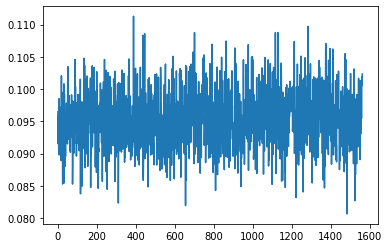

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


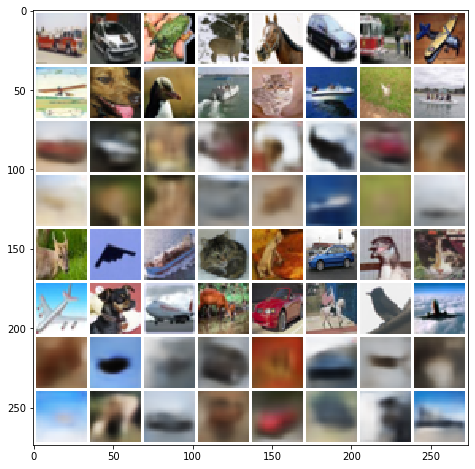

Mean squared dist: 0.044854186
epoch:  2 	 step:0 	 loss: 0.1008
epoch:  2 	 step:100 	 loss: 0.09733
epoch:  2 	 step:200 	 loss: 0.09489
epoch:  2 	 step:300 	 loss: 0.09353
epoch:  2 	 step:400 	 loss: 0.1012
epoch:  2 	 step:500 	 loss: 0.0881
epoch:  2 	 step:600 	 loss: 0.09447
epoch:  2 	 step:700 	 loss: 0.09608
epoch:  2 	 step:800 	 loss: 0.09432
epoch:  2 	 step:900 	 loss: 0.1006
epoch:  2 	 step:1000 	 loss: 0.09522
epoch:  2 	 step:1100 	 loss: 0.09683
epoch:  2 	 step:1200 	 loss: 0.1002
epoch:  2 	 step:1300 	 loss: 0.1026
epoch:  2 	 step:1400 	 loss: 0.09087
epoch:  2 	 step:1500 	 loss: 0.09524


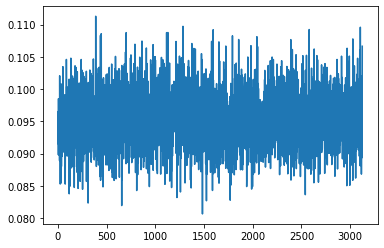

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


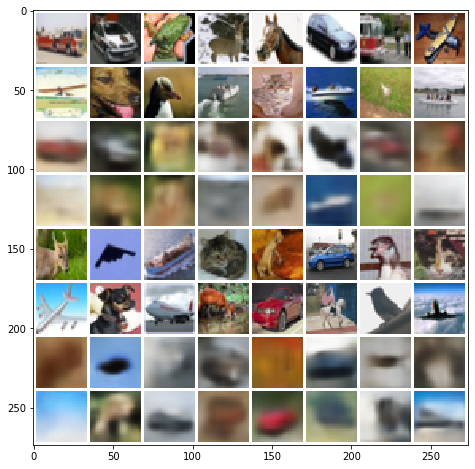

Mean squared dist: 0.04510998
epoch:  3 	 step:0 	 loss: 0.09573
epoch:  3 	 step:100 	 loss: 0.09183
epoch:  3 	 step:200 	 loss: 0.1003
epoch:  3 	 step:300 	 loss: 0.09467
epoch:  3 	 step:400 	 loss: 0.09649
epoch:  3 	 step:500 	 loss: 0.08661
epoch:  3 	 step:600 	 loss: 0.09582
epoch:  3 	 step:700 	 loss: 0.09411
epoch:  3 	 step:800 	 loss: 0.09886
epoch:  3 	 step:900 	 loss: 0.09207
epoch:  3 	 step:1000 	 loss: 0.09053
epoch:  3 	 step:1100 	 loss: 0.08854
epoch:  3 	 step:1200 	 loss: 0.09346
epoch:  3 	 step:1300 	 loss: 0.1002
epoch:  3 	 step:1400 	 loss: 0.09168
epoch:  3 	 step:1500 	 loss: 0.09815


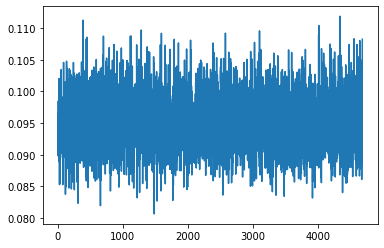

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


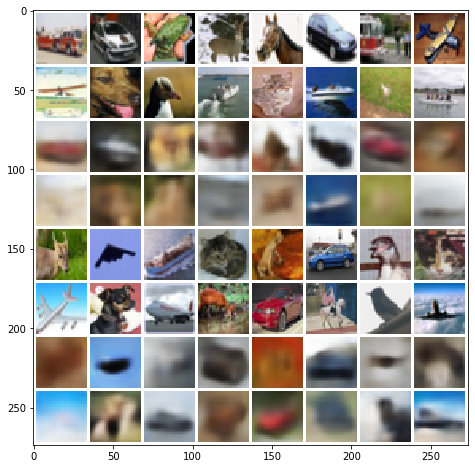

Mean squared dist: 0.04535761
epoch:  4 	 step:0 	 loss: 0.08888
epoch:  4 	 step:100 	 loss: 0.08752
epoch:  4 	 step:200 	 loss: 0.08852
epoch:  4 	 step:300 	 loss: 0.0989
epoch:  4 	 step:400 	 loss: 0.09186
epoch:  4 	 step:500 	 loss: 0.08975
epoch:  4 	 step:600 	 loss: 0.09298
epoch:  4 	 step:700 	 loss: 0.09658
epoch:  4 	 step:800 	 loss: 0.09163
epoch:  4 	 step:900 	 loss: 0.09008
epoch:  4 	 step:1000 	 loss: 0.08732
epoch:  4 	 step:1100 	 loss: 0.1029
epoch:  4 	 step:1200 	 loss: 0.09587
epoch:  4 	 step:1300 	 loss: 0.08967
epoch:  4 	 step:1400 	 loss: 0.1032
epoch:  4 	 step:1500 	 loss: 0.0909


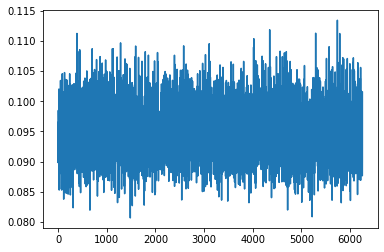

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


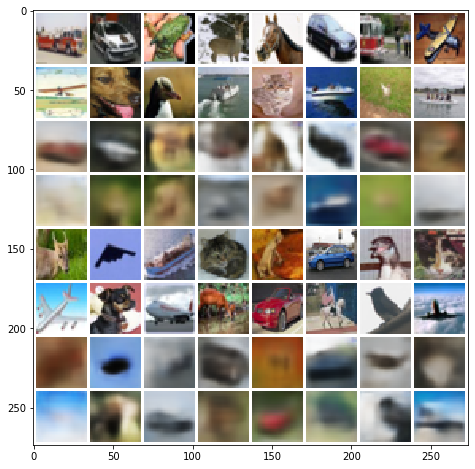

Mean squared dist: 0.045231547
epoch:  5 	 step:0 	 loss: 0.09636
epoch:  5 	 step:100 	 loss: 0.0932
epoch:  5 	 step:200 	 loss: 0.1013
epoch:  5 	 step:300 	 loss: 0.09143
epoch:  5 	 step:400 	 loss: 0.09347
epoch:  5 	 step:500 	 loss: 0.09692
epoch:  5 	 step:600 	 loss: 0.09343
epoch:  5 	 step:700 	 loss: 0.09336
epoch:  5 	 step:800 	 loss: 0.08451
epoch:  5 	 step:900 	 loss: 0.09858
epoch:  5 	 step:1000 	 loss: 0.09565
epoch:  5 	 step:1100 	 loss: 0.09041
epoch:  5 	 step:1200 	 loss: 0.09836
epoch:  5 	 step:1300 	 loss: 0.09423
epoch:  5 	 step:1400 	 loss: 0.09121
epoch:  5 	 step:1500 	 loss: 0.1013


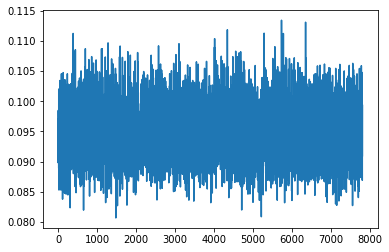

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


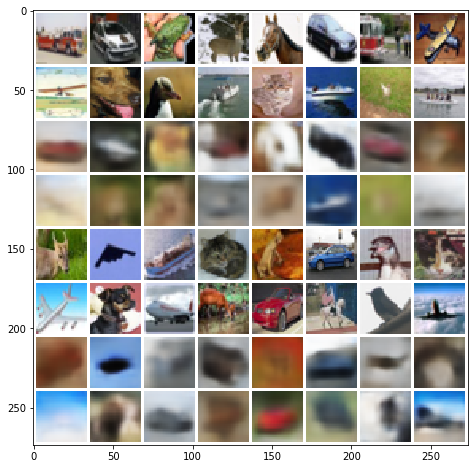

Mean squared dist: 0.04530879
epoch:  6 	 step:0 	 loss: 0.09955
epoch:  6 	 step:100 	 loss: 0.08906
epoch:  6 	 step:200 	 loss: 0.09088
epoch:  6 	 step:300 	 loss: 0.09748
epoch:  6 	 step:400 	 loss: 0.1009
epoch:  6 	 step:500 	 loss: 0.096
epoch:  6 	 step:600 	 loss: 0.09953
epoch:  6 	 step:700 	 loss: 0.09133
epoch:  6 	 step:800 	 loss: 0.0917
epoch:  6 	 step:900 	 loss: 0.08461
epoch:  6 	 step:1000 	 loss: 0.0884
epoch:  6 	 step:1100 	 loss: 0.08978
epoch:  6 	 step:1200 	 loss: 0.08951
epoch:  6 	 step:1300 	 loss: 0.09309
epoch:  6 	 step:1400 	 loss: 0.1016
epoch:  6 	 step:1500 	 loss: 0.1002


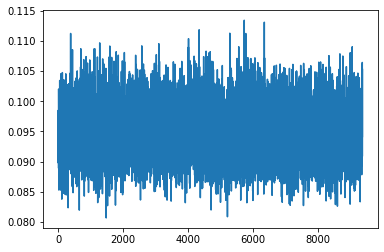

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


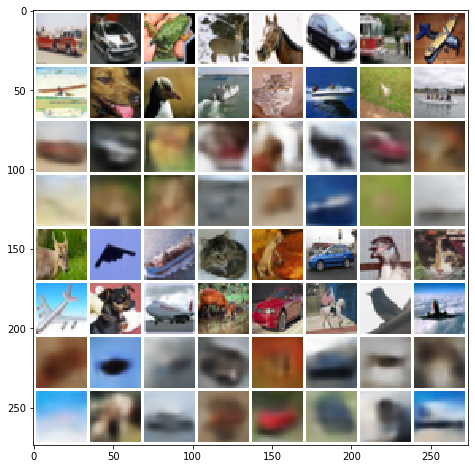

Mean squared dist: 0.045742262
epoch:  7 	 step:0 	 loss: 0.1009
epoch:  7 	 step:100 	 loss: 0.08645
epoch:  7 	 step:200 	 loss: 0.09251
epoch:  7 	 step:300 	 loss: 0.09045
epoch:  7 	 step:400 	 loss: 0.09848
epoch:  7 	 step:500 	 loss: 0.09831
epoch:  7 	 step:600 	 loss: 0.09253
epoch:  7 	 step:700 	 loss: 0.09473
epoch:  7 	 step:800 	 loss: 0.1034
epoch:  7 	 step:900 	 loss: 0.08728
epoch:  7 	 step:1000 	 loss: 0.0942
epoch:  7 	 step:1100 	 loss: 0.094
epoch:  7 	 step:1200 	 loss: 0.09726
epoch:  7 	 step:1300 	 loss: 0.09286
epoch:  7 	 step:1400 	 loss: 0.09451
epoch:  7 	 step:1500 	 loss: 0.09974


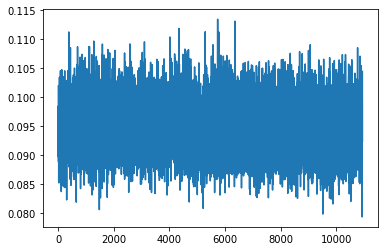

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


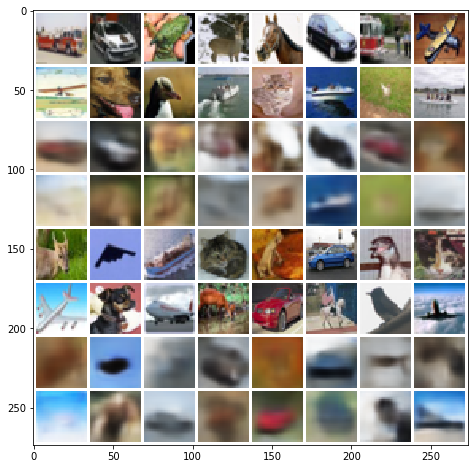

Mean squared dist: 0.044935215
epoch:  8 	 step:0 	 loss: 0.1063
epoch:  8 	 step:100 	 loss: 0.1005
epoch:  8 	 step:200 	 loss: 0.09394
epoch:  8 	 step:300 	 loss: 0.0909
epoch:  8 	 step:400 	 loss: 0.09236
epoch:  8 	 step:500 	 loss: 0.09015
epoch:  8 	 step:600 	 loss: 0.08798
epoch:  8 	 step:700 	 loss: 0.08868
epoch:  8 	 step:800 	 loss: 0.09933
epoch:  8 	 step:900 	 loss: 0.09132
epoch:  8 	 step:1000 	 loss: 0.08901
epoch:  8 	 step:1100 	 loss: 0.09478
epoch:  8 	 step:1200 	 loss: 0.09032
epoch:  8 	 step:1300 	 loss: 0.09273
epoch:  8 	 step:1400 	 loss: 0.09298
epoch:  8 	 step:1500 	 loss: 0.09225


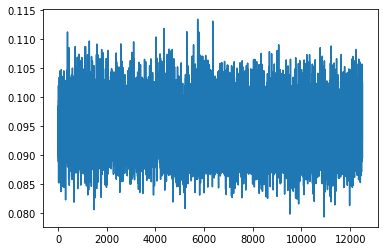

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


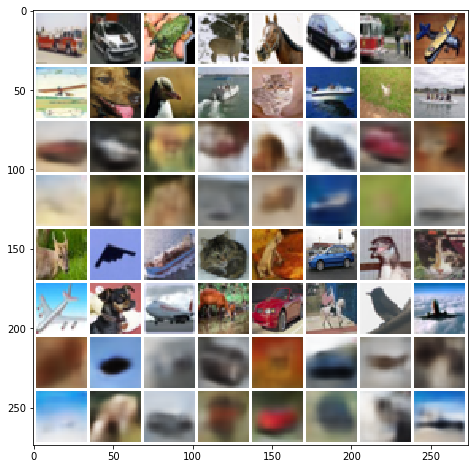

Mean squared dist: 0.046225462
epoch:  9 	 step:0 	 loss: 0.1004
epoch:  9 	 step:100 	 loss: 0.09538
epoch:  9 	 step:200 	 loss: 0.106
epoch:  9 	 step:300 	 loss: 0.09874
epoch:  9 	 step:400 	 loss: 0.09269
epoch:  9 	 step:500 	 loss: 0.09352
epoch:  9 	 step:600 	 loss: 0.1045
epoch:  9 	 step:700 	 loss: 0.09239
epoch:  9 	 step:800 	 loss: 0.08764
epoch:  9 	 step:900 	 loss: 0.08977
epoch:  9 	 step:1000 	 loss: 0.09353
epoch:  9 	 step:1100 	 loss: 0.09714
epoch:  9 	 step:1200 	 loss: 0.09739
epoch:  9 	 step:1300 	 loss: 0.09578
epoch:  9 	 step:1400 	 loss: 0.09346
epoch:  9 	 step:1500 	 loss: 0.08817


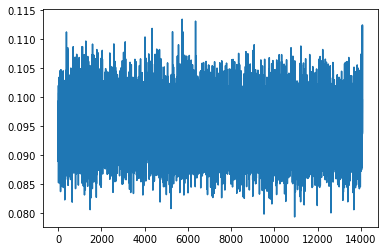

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


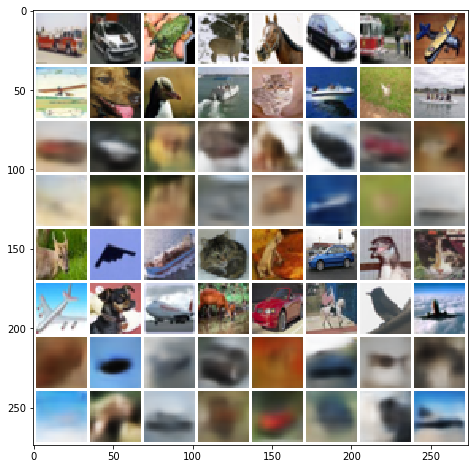

Mean squared dist: 0.045465905
epoch: 10 	 step:0 	 loss: 0.09966
epoch: 10 	 step:100 	 loss: 0.09311
epoch: 10 	 step:200 	 loss: 0.09454
epoch: 10 	 step:300 	 loss: 0.09534
epoch: 10 	 step:400 	 loss: 0.09337
epoch: 10 	 step:500 	 loss: 0.09767
epoch: 10 	 step:600 	 loss: 0.09021
epoch: 10 	 step:700 	 loss: 0.0921
epoch: 10 	 step:800 	 loss: 0.09318
epoch: 10 	 step:900 	 loss: 0.09429
epoch: 10 	 step:1000 	 loss: 0.08791
epoch: 10 	 step:1100 	 loss: 0.09441
epoch: 10 	 step:1200 	 loss: 0.0926
epoch: 10 	 step:1300 	 loss: 0.09388
epoch: 10 	 step:1400 	 loss: 0.1033
epoch: 10 	 step:1500 	 loss: 0.09181


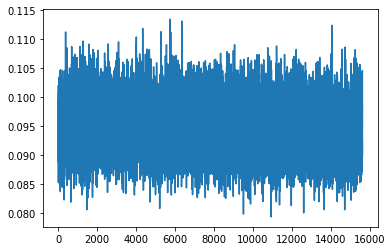

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


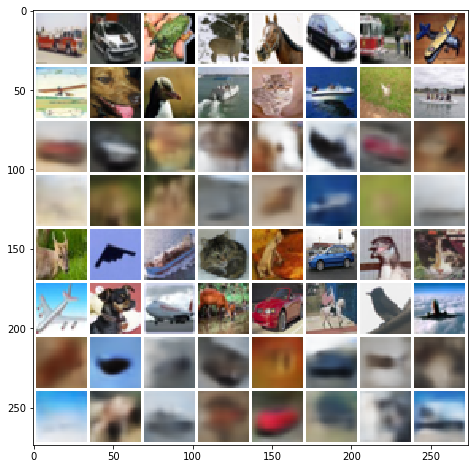

Mean squared dist: 0.04466072
epoch: 11 	 step:0 	 loss: 0.101
epoch: 11 	 step:100 	 loss: 0.08751
epoch: 11 	 step:200 	 loss: 0.0941
epoch: 11 	 step:300 	 loss: 0.09165
epoch: 11 	 step:400 	 loss: 0.09786
epoch: 11 	 step:500 	 loss: 0.09303
epoch: 11 	 step:600 	 loss: 0.101
epoch: 11 	 step:700 	 loss: 0.09233
epoch: 11 	 step:800 	 loss: 0.0916
epoch: 11 	 step:900 	 loss: 0.09355
epoch: 11 	 step:1000 	 loss: 0.09058
epoch: 11 	 step:1100 	 loss: 0.09594
epoch: 11 	 step:1200 	 loss: 0.09982
epoch: 11 	 step:1300 	 loss: 0.08916
epoch: 11 	 step:1400 	 loss: 0.09521
epoch: 11 	 step:1500 	 loss: 0.0946


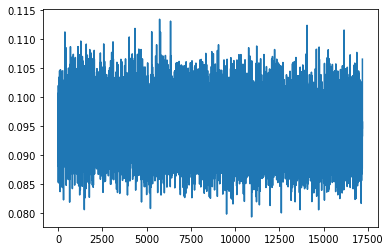

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


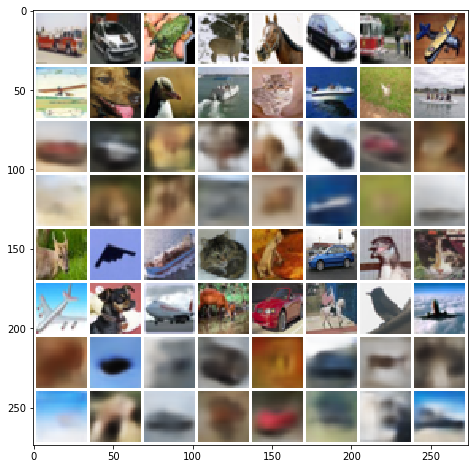

Mean squared dist: 0.045441218
epoch: 12 	 step:0 	 loss: 0.09836
epoch: 12 	 step:100 	 loss: 0.09043
epoch: 12 	 step:200 	 loss: 0.1038
epoch: 12 	 step:300 	 loss: 0.09164
epoch: 12 	 step:400 	 loss: 0.09577
epoch: 12 	 step:500 	 loss: 0.09095
epoch: 12 	 step:600 	 loss: 0.08964
epoch: 12 	 step:700 	 loss: 0.1004
epoch: 12 	 step:800 	 loss: 0.09547
epoch: 12 	 step:900 	 loss: 0.09398
epoch: 12 	 step:1000 	 loss: 0.08999
epoch: 12 	 step:1100 	 loss: 0.09304
epoch: 12 	 step:1200 	 loss: 0.09346
epoch: 12 	 step:1300 	 loss: 0.09431
epoch: 12 	 step:1400 	 loss: 0.09532
epoch: 12 	 step:1500 	 loss: 0.0882


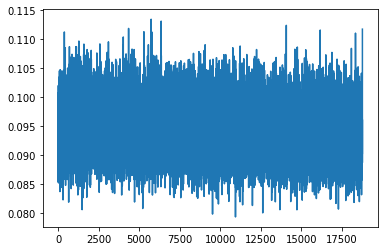

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


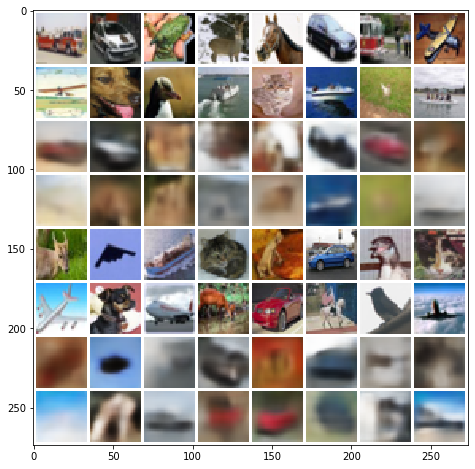

Mean squared dist: 0.04578535
epoch: 13 	 step:0 	 loss: 0.08997
epoch: 13 	 step:100 	 loss: 0.09328
epoch: 13 	 step:200 	 loss: 0.09404
epoch: 13 	 step:300 	 loss: 0.08915
epoch: 13 	 step:400 	 loss: 0.09042
epoch: 13 	 step:500 	 loss: 0.09761
epoch: 13 	 step:600 	 loss: 0.09372
epoch: 13 	 step:700 	 loss: 0.09758
epoch: 13 	 step:800 	 loss: 0.08516
epoch: 13 	 step:900 	 loss: 0.09177
epoch: 13 	 step:1000 	 loss: 0.08997
epoch: 13 	 step:1100 	 loss: 0.09605
epoch: 13 	 step:1200 	 loss: 0.09076
epoch: 13 	 step:1300 	 loss: 0.09599
epoch: 13 	 step:1400 	 loss: 0.09479
epoch: 13 	 step:1500 	 loss: 0.1002


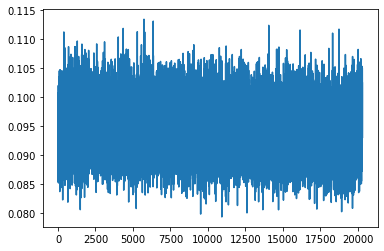

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


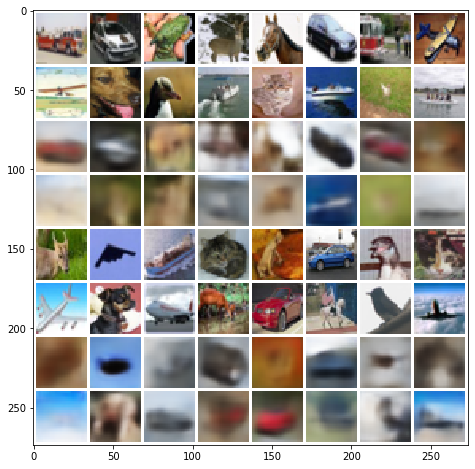

Mean squared dist: 0.04518342
epoch: 14 	 step:0 	 loss: 0.09083
epoch: 14 	 step:100 	 loss: 0.09542
epoch: 14 	 step:200 	 loss: 0.08698
epoch: 14 	 step:300 	 loss: 0.08739
epoch: 14 	 step:400 	 loss: 0.1
epoch: 14 	 step:500 	 loss: 0.0964
epoch: 14 	 step:600 	 loss: 0.08825
epoch: 14 	 step:700 	 loss: 0.09129
epoch: 14 	 step:800 	 loss: 0.08977
epoch: 14 	 step:900 	 loss: 0.09828
epoch: 14 	 step:1000 	 loss: 0.0965
epoch: 14 	 step:1100 	 loss: 0.08902
epoch: 14 	 step:1200 	 loss: 0.09853
epoch: 14 	 step:1300 	 loss: 0.09532
epoch: 14 	 step:1400 	 loss: 0.09238
epoch: 14 	 step:1500 	 loss: 0.0948


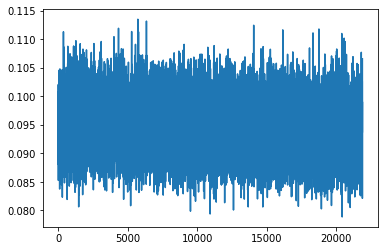

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


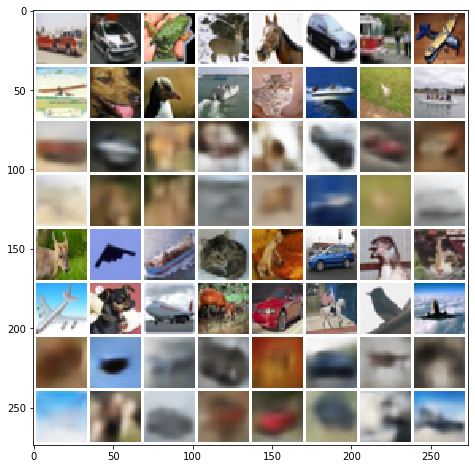

Mean squared dist: 0.04526115
epoch: 15 	 step:0 	 loss: 0.08702
epoch: 15 	 step:100 	 loss: 0.08904
epoch: 15 	 step:200 	 loss: 0.09451
epoch: 15 	 step:300 	 loss: 0.0939
epoch: 15 	 step:400 	 loss: 0.08938
epoch: 15 	 step:500 	 loss: 0.09093
epoch: 15 	 step:600 	 loss: 0.09519
epoch: 15 	 step:700 	 loss: 0.09768
epoch: 15 	 step:800 	 loss: 0.09829
epoch: 15 	 step:900 	 loss: 0.09485
epoch: 15 	 step:1000 	 loss: 0.08906
epoch: 15 	 step:1100 	 loss: 0.09954
epoch: 15 	 step:1200 	 loss: 0.09299
epoch: 15 	 step:1300 	 loss: 0.09522
epoch: 15 	 step:1400 	 loss: 0.08951
epoch: 15 	 step:1500 	 loss: 0.09021


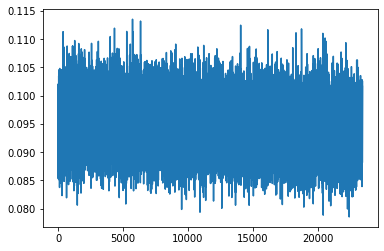

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


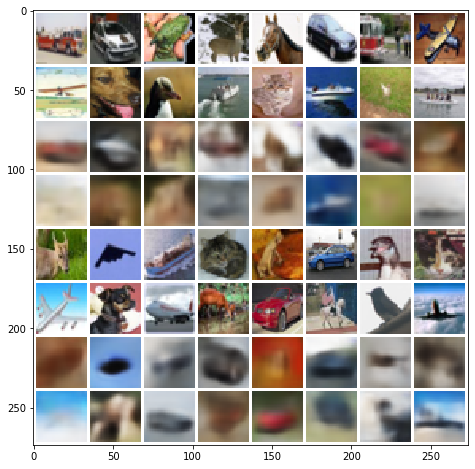

Mean squared dist: 0.04574465
epoch: 16 	 step:0 	 loss: 0.0918
epoch: 16 	 step:100 	 loss: 0.09189
epoch: 16 	 step:200 	 loss: 0.0879
epoch: 16 	 step:300 	 loss: 0.09187
epoch: 16 	 step:400 	 loss: 0.09257
epoch: 16 	 step:500 	 loss: 0.1003
epoch: 16 	 step:600 	 loss: 0.09619
epoch: 16 	 step:700 	 loss: 0.08799
epoch: 16 	 step:800 	 loss: 0.09534
epoch: 16 	 step:900 	 loss: 0.09343
epoch: 16 	 step:1000 	 loss: 0.09067
epoch: 16 	 step:1100 	 loss: 0.09274
epoch: 16 	 step:1200 	 loss: 0.08763
epoch: 16 	 step:1300 	 loss: 0.09058
epoch: 16 	 step:1400 	 loss: 0.09847
epoch: 16 	 step:1500 	 loss: 0.1002


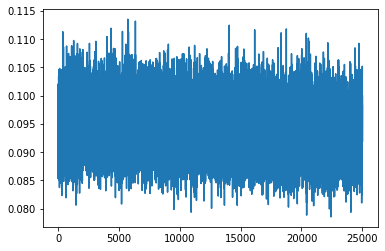

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


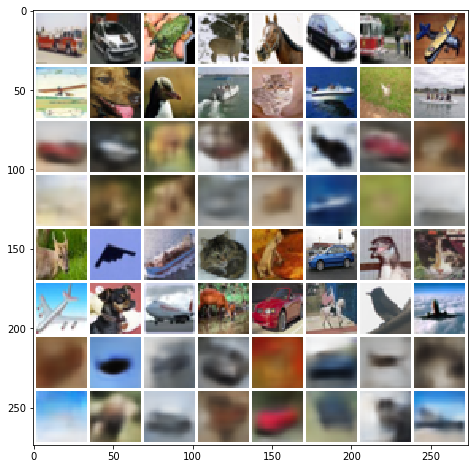

Mean squared dist: 0.04579051
epoch: 17 	 step:0 	 loss: 0.0876
epoch: 17 	 step:100 	 loss: 0.0939
epoch: 17 	 step:200 	 loss: 0.09192
epoch: 17 	 step:300 	 loss: 0.08676
epoch: 17 	 step:400 	 loss: 0.0884
epoch: 17 	 step:500 	 loss: 0.09213
epoch: 17 	 step:600 	 loss: 0.08815
epoch: 17 	 step:700 	 loss: 0.09926
epoch: 17 	 step:800 	 loss: 0.09433
epoch: 17 	 step:900 	 loss: 0.08572
epoch: 17 	 step:1000 	 loss: 0.09013
epoch: 17 	 step:1100 	 loss: 0.08255
epoch: 17 	 step:1200 	 loss: 0.09404
epoch: 17 	 step:1300 	 loss: 0.08815
epoch: 17 	 step:1400 	 loss: 0.09931
epoch: 17 	 step:1500 	 loss: 0.09413


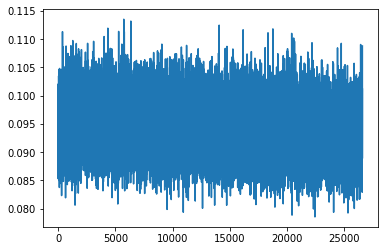

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


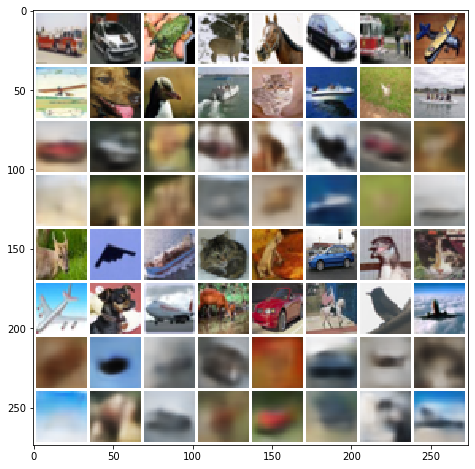

Mean squared dist: 0.04502257
epoch: 18 	 step:0 	 loss: 0.09377
epoch: 18 	 step:100 	 loss: 0.089
epoch: 18 	 step:200 	 loss: 0.09176
epoch: 18 	 step:300 	 loss: 0.09108
epoch: 18 	 step:400 	 loss: 0.09197
epoch: 18 	 step:500 	 loss: 0.08983
epoch: 18 	 step:600 	 loss: 0.09035
epoch: 18 	 step:700 	 loss: 0.09197
epoch: 18 	 step:800 	 loss: 0.09079
epoch: 18 	 step:900 	 loss: 0.1088
epoch: 18 	 step:1000 	 loss: 0.09076
epoch: 18 	 step:1100 	 loss: 0.08818
epoch: 18 	 step:1200 	 loss: 0.1029
epoch: 18 	 step:1300 	 loss: 0.09699
epoch: 18 	 step:1400 	 loss: 0.08966
epoch: 18 	 step:1500 	 loss: 0.08682


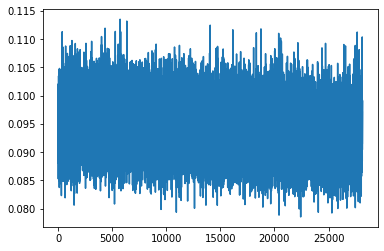

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


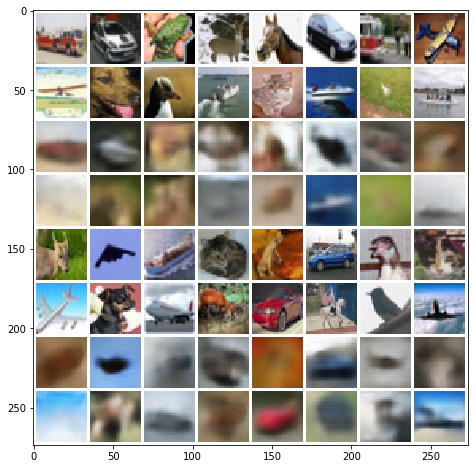

Mean squared dist: 0.044828944
epoch: 19 	 step:0 	 loss: 0.09121
epoch: 19 	 step:100 	 loss: 0.09557
epoch: 19 	 step:200 	 loss: 0.09125
epoch: 19 	 step:300 	 loss: 0.08596
epoch: 19 	 step:400 	 loss: 0.0954
epoch: 19 	 step:500 	 loss: 0.09141
epoch: 19 	 step:600 	 loss: 0.09687
epoch: 19 	 step:700 	 loss: 0.09417
epoch: 19 	 step:800 	 loss: 0.09658
epoch: 19 	 step:900 	 loss: 0.09613
epoch: 19 	 step:1000 	 loss: 0.0949
epoch: 19 	 step:1100 	 loss: 0.09451
epoch: 19 	 step:1200 	 loss: 0.09486
epoch: 19 	 step:1300 	 loss: 0.0888
epoch: 19 	 step:1400 	 loss: 0.08921
epoch: 19 	 step:1500 	 loss: 0.09557


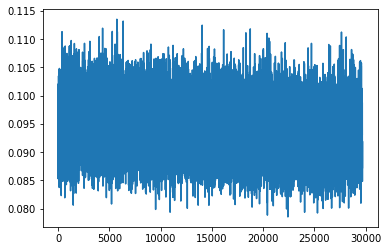

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


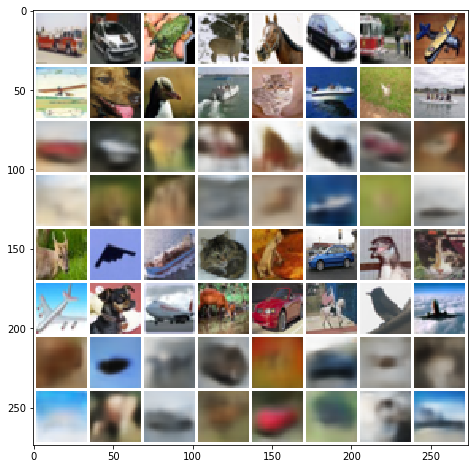

Mean squared dist: 0.04477008
epoch: 20 	 step:0 	 loss: 0.08728
epoch: 20 	 step:100 	 loss: 0.09502
epoch: 20 	 step:200 	 loss: 0.08485
epoch: 20 	 step:300 	 loss: 0.08735
epoch: 20 	 step:400 	 loss: 0.0996
epoch: 20 	 step:500 	 loss: 0.08667
epoch: 20 	 step:600 	 loss: 0.08432
epoch: 20 	 step:700 	 loss: 0.09391
epoch: 20 	 step:800 	 loss: 0.08688
epoch: 20 	 step:900 	 loss: 0.0966
epoch: 20 	 step:1000 	 loss: 0.09491
epoch: 20 	 step:1100 	 loss: 0.09138
epoch: 20 	 step:1200 	 loss: 0.08955
epoch: 20 	 step:1300 	 loss: 0.09094
epoch: 20 	 step:1400 	 loss: 0.09876
epoch: 20 	 step:1500 	 loss: 0.09728


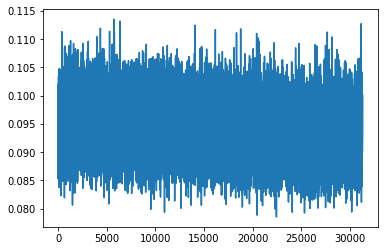

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


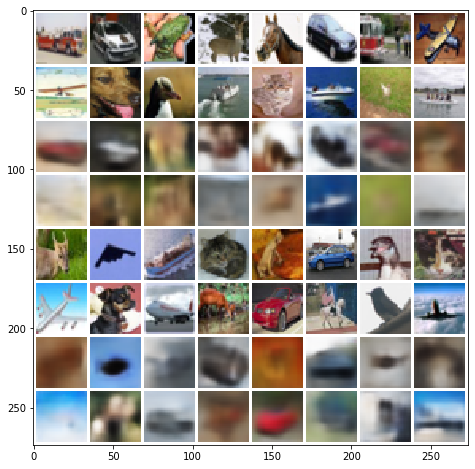

Mean squared dist: 0.045764536
epoch: 21 	 step:0 	 loss: 0.0954
epoch: 21 	 step:100 	 loss: 0.08693
epoch: 21 	 step:200 	 loss: 0.08749
epoch: 21 	 step:300 	 loss: 0.09448
epoch: 21 	 step:400 	 loss: 0.08536
epoch: 21 	 step:500 	 loss: 0.09161
epoch: 21 	 step:600 	 loss: 0.09303
epoch: 21 	 step:700 	 loss: 0.09108
epoch: 21 	 step:800 	 loss: 0.09533
epoch: 21 	 step:900 	 loss: 0.09397
epoch: 21 	 step:1000 	 loss: 0.08688
epoch: 21 	 step:1100 	 loss: 0.09688
epoch: 21 	 step:1200 	 loss: 0.08686
epoch: 21 	 step:1300 	 loss: 0.09143
epoch: 21 	 step:1400 	 loss: 0.09069
epoch: 21 	 step:1500 	 loss: 0.09507


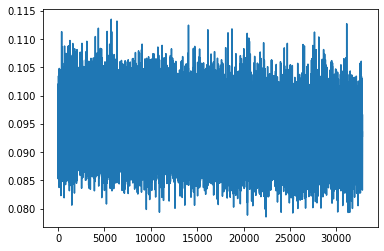

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


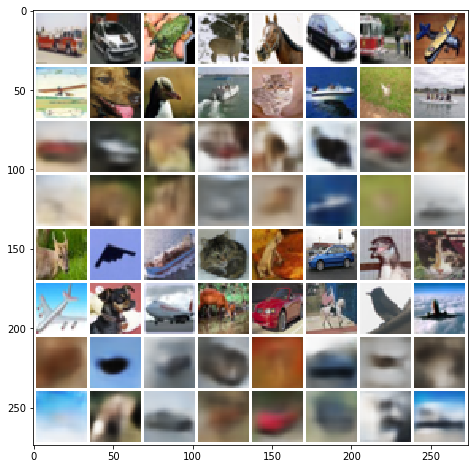

Mean squared dist: 0.04493333
epoch: 22 	 step:0 	 loss: 0.09148
epoch: 22 	 step:100 	 loss: 0.08873
epoch: 22 	 step:200 	 loss: 0.08529
epoch: 22 	 step:300 	 loss: 0.08821
epoch: 22 	 step:400 	 loss: 0.09822
epoch: 22 	 step:500 	 loss: 0.09486
epoch: 22 	 step:600 	 loss: 0.09255
epoch: 22 	 step:700 	 loss: 0.09386
epoch: 22 	 step:800 	 loss: 0.09974
epoch: 22 	 step:900 	 loss: 0.08596
epoch: 22 	 step:1000 	 loss: 0.09793
epoch: 22 	 step:1100 	 loss: 0.08864
epoch: 22 	 step:1200 	 loss: 0.09089
epoch: 22 	 step:1300 	 loss: 0.09334
epoch: 22 	 step:1400 	 loss: 0.09104
epoch: 22 	 step:1500 	 loss: 0.09995


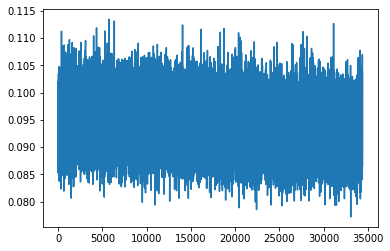

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


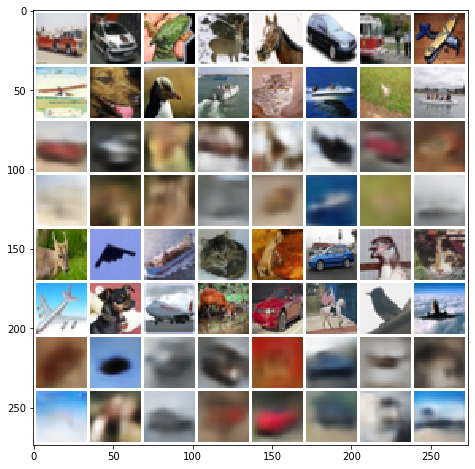

Mean squared dist: 0.045346543
epoch: 23 	 step:0 	 loss: 0.08712
epoch: 23 	 step:100 	 loss: 0.08814
epoch: 23 	 step:200 	 loss: 0.09081
epoch: 23 	 step:300 	 loss: 0.09303
epoch: 23 	 step:400 	 loss: 0.09082
epoch: 23 	 step:500 	 loss: 0.09346
epoch: 23 	 step:600 	 loss: 0.0886
epoch: 23 	 step:700 	 loss: 0.09468
epoch: 23 	 step:800 	 loss: 0.08888
epoch: 23 	 step:900 	 loss: 0.09789
epoch: 23 	 step:1000 	 loss: 0.0848
epoch: 23 	 step:1100 	 loss: 0.08348
epoch: 23 	 step:1200 	 loss: 0.0933
epoch: 23 	 step:1300 	 loss: 0.0962
epoch: 23 	 step:1400 	 loss: 0.08909
epoch: 23 	 step:1500 	 loss: 0.08954


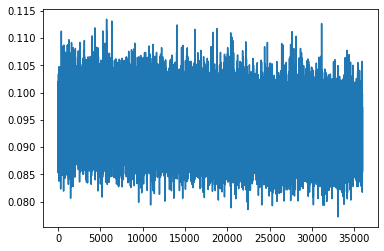

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


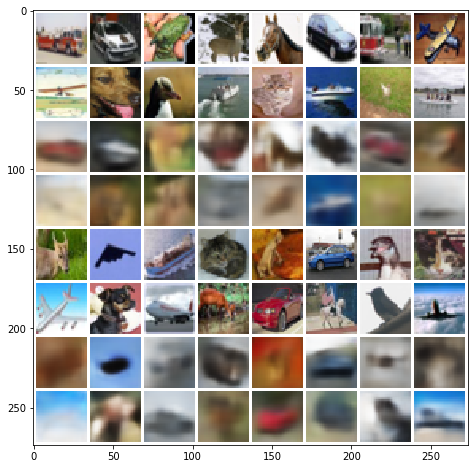

Mean squared dist: 0.045277946
epoch: 24 	 step:0 	 loss: 0.0924
epoch: 24 	 step:100 	 loss: 0.09197
epoch: 24 	 step:200 	 loss: 0.08995
epoch: 24 	 step:300 	 loss: 0.08801
epoch: 24 	 step:400 	 loss: 0.0887
epoch: 24 	 step:500 	 loss: 0.08694
epoch: 24 	 step:600 	 loss: 0.09279
epoch: 24 	 step:700 	 loss: 0.09394
epoch: 24 	 step:800 	 loss: 0.08557
epoch: 24 	 step:900 	 loss: 0.08813
epoch: 24 	 step:1000 	 loss: 0.08773
epoch: 24 	 step:1100 	 loss: 0.08905
epoch: 24 	 step:1200 	 loss: 0.0894
epoch: 24 	 step:1300 	 loss: 0.09237
epoch: 24 	 step:1400 	 loss: 0.08636
epoch: 24 	 step:1500 	 loss: 0.09011


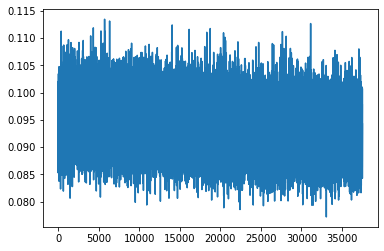

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


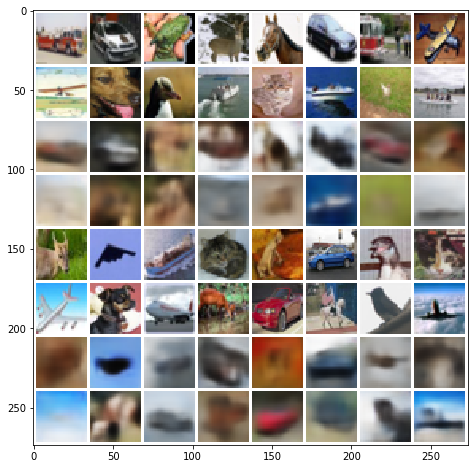

Mean squared dist: 0.046082906
epoch: 25 	 step:0 	 loss: 0.08924
epoch: 25 	 step:100 	 loss: 0.09536
epoch: 25 	 step:200 	 loss: 0.08874
epoch: 25 	 step:300 	 loss: 0.0863
epoch: 25 	 step:400 	 loss: 0.09991
epoch: 25 	 step:500 	 loss: 0.0901
epoch: 25 	 step:600 	 loss: 0.08994
epoch: 25 	 step:700 	 loss: 0.08619
epoch: 25 	 step:800 	 loss: 0.08881
epoch: 25 	 step:900 	 loss: 0.08934
epoch: 25 	 step:1000 	 loss: 0.09405
epoch: 25 	 step:1100 	 loss: 0.0917
epoch: 25 	 step:1200 	 loss: 0.09898
epoch: 25 	 step:1300 	 loss: 0.09444
epoch: 25 	 step:1400 	 loss: 0.08873
epoch: 25 	 step:1500 	 loss: 0.08444


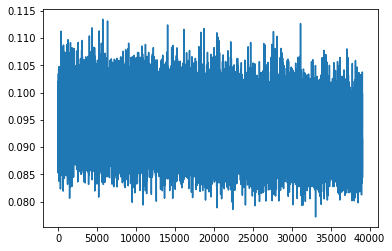

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


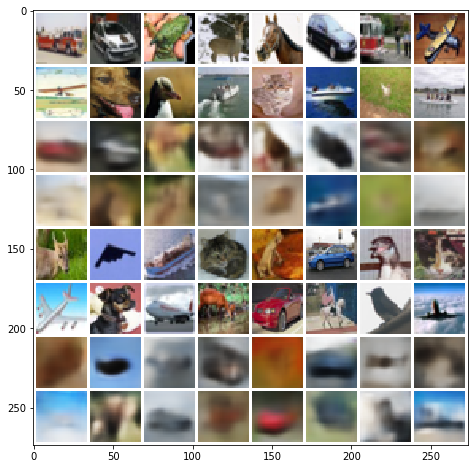

Mean squared dist: 0.045211762
epoch: 26 	 step:0 	 loss: 0.0938
epoch: 26 	 step:100 	 loss: 0.08685
epoch: 26 	 step:200 	 loss: 0.09704
epoch: 26 	 step:300 	 loss: 0.09234
epoch: 26 	 step:400 	 loss: 0.08098
epoch: 26 	 step:500 	 loss: 0.09324
epoch: 26 	 step:600 	 loss: 0.08996
epoch: 26 	 step:700 	 loss: 0.09501
epoch: 26 	 step:800 	 loss: 0.08478
epoch: 26 	 step:900 	 loss: 0.09061
epoch: 26 	 step:1000 	 loss: 0.09718
epoch: 26 	 step:1100 	 loss: 0.09117
epoch: 26 	 step:1200 	 loss: 0.08935
epoch: 26 	 step:1300 	 loss: 0.09753
epoch: 26 	 step:1400 	 loss: 0.09511
epoch: 26 	 step:1500 	 loss: 0.09336


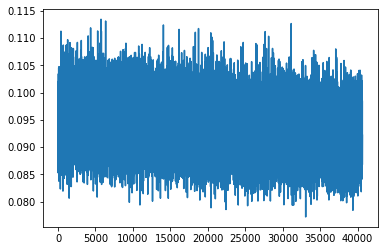

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


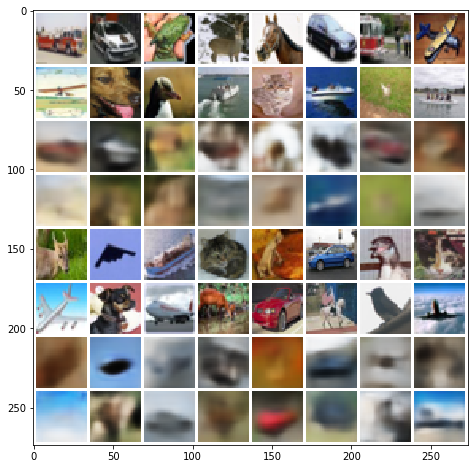

Mean squared dist: 0.045033276
epoch: 27 	 step:0 	 loss: 0.08232
epoch: 27 	 step:100 	 loss: 0.08967
epoch: 27 	 step:200 	 loss: 0.09024
epoch: 27 	 step:300 	 loss: 0.0966
epoch: 27 	 step:400 	 loss: 0.089
epoch: 27 	 step:500 	 loss: 0.09935
epoch: 27 	 step:600 	 loss: 0.09158
epoch: 27 	 step:700 	 loss: 0.09866
epoch: 27 	 step:800 	 loss: 0.09167
epoch: 27 	 step:900 	 loss: 0.08462
epoch: 27 	 step:1000 	 loss: 0.09276
epoch: 27 	 step:1100 	 loss: 0.09205
epoch: 27 	 step:1200 	 loss: 0.09455
epoch: 27 	 step:1300 	 loss: 0.1017
epoch: 27 	 step:1400 	 loss: 0.09133
epoch: 27 	 step:1500 	 loss: 0.1026


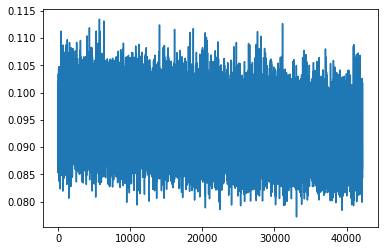

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


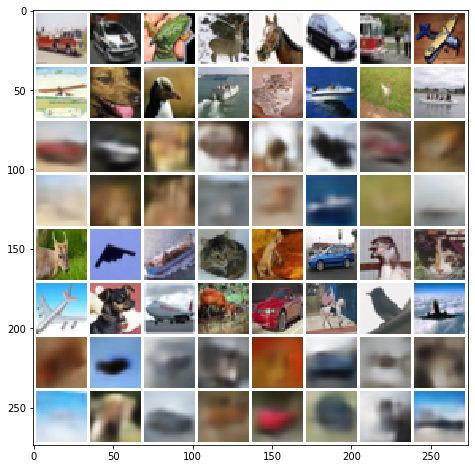

Mean squared dist: 0.045784175
epoch: 28 	 step:0 	 loss: 0.0944
epoch: 28 	 step:100 	 loss: 0.08235
epoch: 28 	 step:200 	 loss: 0.08941
epoch: 28 	 step:300 	 loss: 0.0933
epoch: 28 	 step:400 	 loss: 0.09097
epoch: 28 	 step:500 	 loss: 0.09183
epoch: 28 	 step:600 	 loss: 0.09859
epoch: 28 	 step:700 	 loss: 0.09451
epoch: 28 	 step:800 	 loss: 0.09107
epoch: 28 	 step:900 	 loss: 0.09264
epoch: 28 	 step:1000 	 loss: 0.09227
epoch: 28 	 step:1100 	 loss: 0.09359
epoch: 28 	 step:1200 	 loss: 0.09303
epoch: 28 	 step:1300 	 loss: 0.08935
epoch: 28 	 step:1400 	 loss: 0.09619
epoch: 28 	 step:1500 	 loss: 0.08412


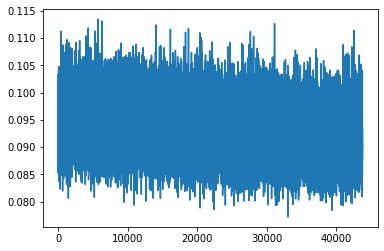

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


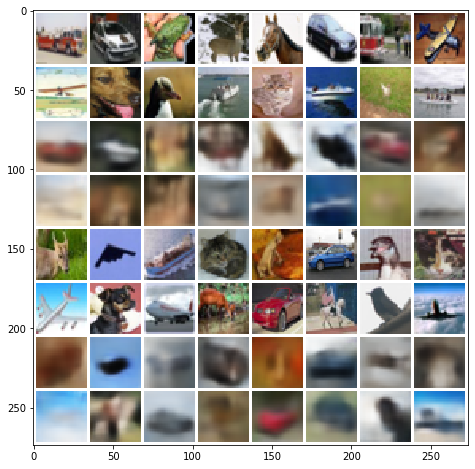

Mean squared dist: 0.045271393
epoch: 29 	 step:0 	 loss: 0.08413
epoch: 29 	 step:100 	 loss: 0.09213
epoch: 29 	 step:200 	 loss: 0.08901
epoch: 29 	 step:300 	 loss: 0.08192
epoch: 29 	 step:400 	 loss: 0.08388
epoch: 29 	 step:500 	 loss: 0.09353
epoch: 29 	 step:600 	 loss: 0.08874
epoch: 29 	 step:700 	 loss: 0.09141
epoch: 29 	 step:800 	 loss: 0.09055
epoch: 29 	 step:900 	 loss: 0.08806
epoch: 29 	 step:1000 	 loss: 0.08958
epoch: 29 	 step:1100 	 loss: 0.09406
epoch: 29 	 step:1200 	 loss: 0.08535
epoch: 29 	 step:1300 	 loss: 0.09445
epoch: 29 	 step:1400 	 loss: 0.09959
epoch: 29 	 step:1500 	 loss: 0.09706


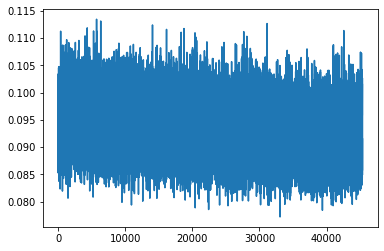

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


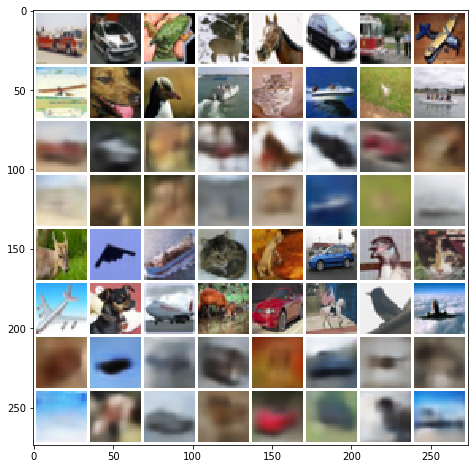

Mean squared dist: 0.044819538
epoch: 30 	 step:0 	 loss: 0.08368
epoch: 30 	 step:100 	 loss: 0.08642
epoch: 30 	 step:200 	 loss: 0.09117
epoch: 30 	 step:300 	 loss: 0.09001
epoch: 30 	 step:400 	 loss: 0.08319
epoch: 30 	 step:500 	 loss: 0.08688
epoch: 30 	 step:600 	 loss: 0.09669
epoch: 30 	 step:700 	 loss: 0.09257
epoch: 30 	 step:800 	 loss: 0.08305
epoch: 30 	 step:900 	 loss: 0.08755
epoch: 30 	 step:1000 	 loss: 0.08779
epoch: 30 	 step:1100 	 loss: 0.09844
epoch: 30 	 step:1200 	 loss: 0.09005
epoch: 30 	 step:1300 	 loss: 0.09519
epoch: 30 	 step:1400 	 loss: 0.09132
epoch: 30 	 step:1500 	 loss: 0.09895


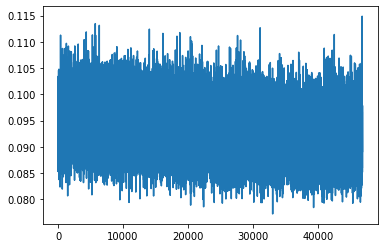

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


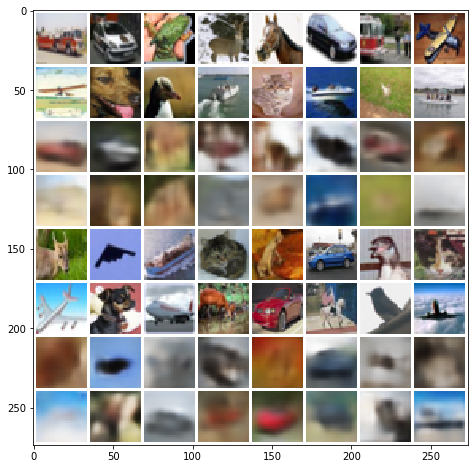

Mean squared dist: 0.045582052
epoch: 31 	 step:0 	 loss: 0.0946
epoch: 31 	 step:100 	 loss: 0.08766
epoch: 31 	 step:200 	 loss: 0.0921
epoch: 31 	 step:300 	 loss: 0.09451
epoch: 31 	 step:400 	 loss: 0.08444
epoch: 31 	 step:500 	 loss: 0.09169
epoch: 31 	 step:600 	 loss: 0.08119
epoch: 31 	 step:700 	 loss: 0.08615
epoch: 31 	 step:800 	 loss: 0.092
epoch: 31 	 step:900 	 loss: 0.08803
epoch: 31 	 step:1000 	 loss: 0.08889
epoch: 31 	 step:1100 	 loss: 0.09852
epoch: 31 	 step:1200 	 loss: 0.09603
epoch: 31 	 step:1300 	 loss: 0.09513
epoch: 31 	 step:1400 	 loss: 0.09221
epoch: 31 	 step:1500 	 loss: 0.09372


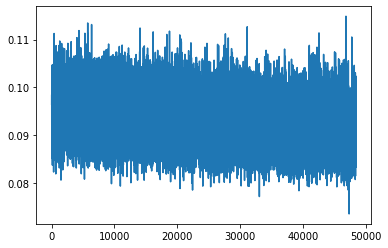

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


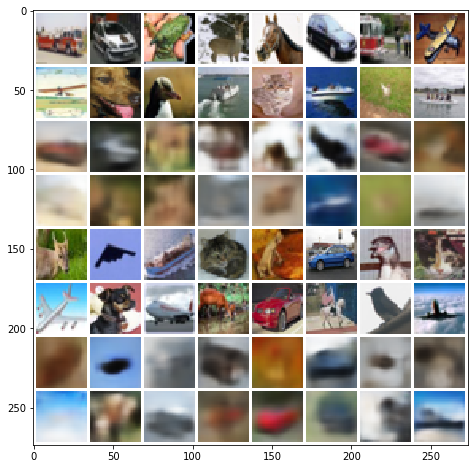

Mean squared dist: 0.045421142
epoch: 32 	 step:0 	 loss: 0.09349
epoch: 32 	 step:100 	 loss: 0.08753
epoch: 32 	 step:200 	 loss: 0.08414
epoch: 32 	 step:300 	 loss: 0.0939
epoch: 32 	 step:400 	 loss: 0.08767
epoch: 32 	 step:500 	 loss: 0.09077
epoch: 32 	 step:600 	 loss: 0.0873
epoch: 32 	 step:700 	 loss: 0.09282
epoch: 32 	 step:800 	 loss: 0.08561
epoch: 32 	 step:900 	 loss: 0.09359
epoch: 32 	 step:1000 	 loss: 0.0902
epoch: 32 	 step:1100 	 loss: 0.08378
epoch: 32 	 step:1200 	 loss: 0.08858
epoch: 32 	 step:1300 	 loss: 0.08448
epoch: 32 	 step:1400 	 loss: 0.08387
epoch: 32 	 step:1500 	 loss: 0.08655


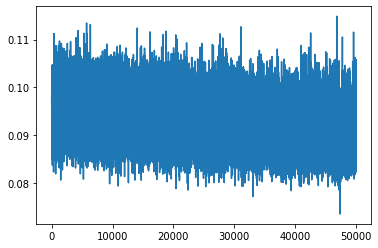

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


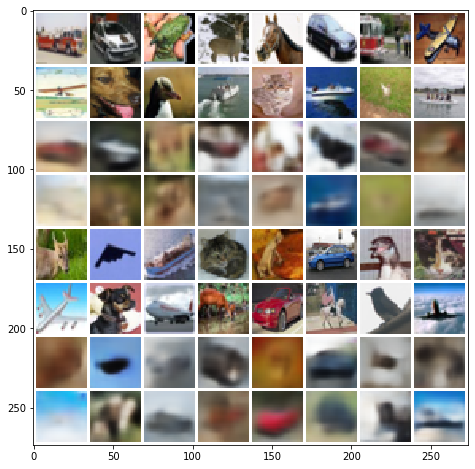

Mean squared dist: 0.04605249
epoch: 33 	 step:0 	 loss: 0.09863
epoch: 33 	 step:100 	 loss: 0.09237
epoch: 33 	 step:200 	 loss: 0.0864
epoch: 33 	 step:300 	 loss: 0.08917
epoch: 33 	 step:400 	 loss: 0.09365
epoch: 33 	 step:500 	 loss: 0.09395
epoch: 33 	 step:600 	 loss: 0.09567
epoch: 33 	 step:700 	 loss: 0.08763
epoch: 33 	 step:800 	 loss: 0.08884
epoch: 33 	 step:900 	 loss: 0.09006
epoch: 33 	 step:1000 	 loss: 0.09363
epoch: 33 	 step:1100 	 loss: 0.08954
epoch: 33 	 step:1200 	 loss: 0.09522
epoch: 33 	 step:1300 	 loss: 0.09139
epoch: 33 	 step:1400 	 loss: 0.09664
epoch: 33 	 step:1500 	 loss: 0.08502


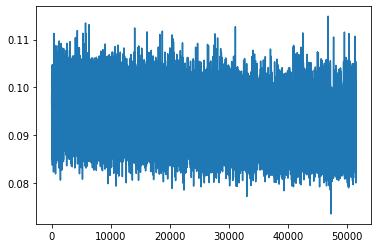

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


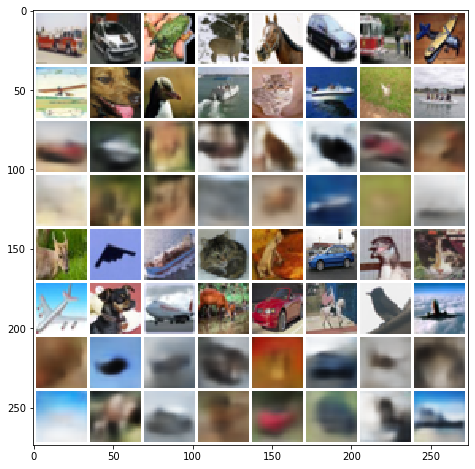

Mean squared dist: 0.045739084
epoch: 34 	 step:0 	 loss: 0.08825
epoch: 34 	 step:100 	 loss: 0.09481
epoch: 34 	 step:200 	 loss: 0.09583
epoch: 34 	 step:300 	 loss: 0.0913
epoch: 34 	 step:400 	 loss: 0.08962
epoch: 34 	 step:500 	 loss: 0.09343
epoch: 34 	 step:600 	 loss: 0.0932
epoch: 34 	 step:700 	 loss: 0.09261
epoch: 34 	 step:800 	 loss: 0.09756
epoch: 34 	 step:900 	 loss: 0.09411
epoch: 34 	 step:1000 	 loss: 0.0906
epoch: 34 	 step:1100 	 loss: 0.09632
epoch: 34 	 step:1200 	 loss: 0.08694
epoch: 34 	 step:1300 	 loss: 0.09325
epoch: 34 	 step:1400 	 loss: 0.08865
epoch: 34 	 step:1500 	 loss: 0.09255


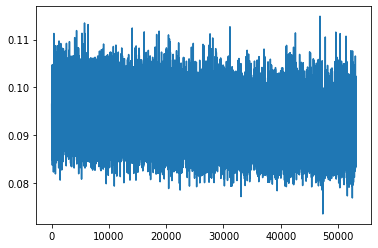

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


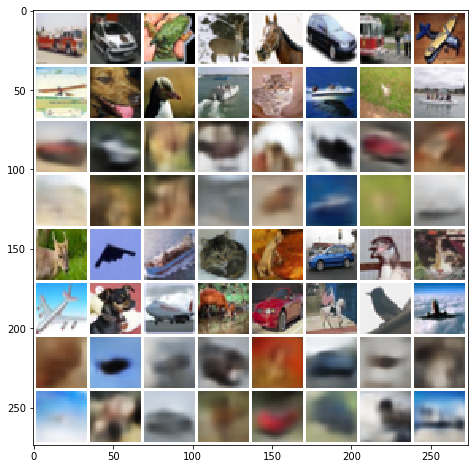

Mean squared dist: 0.046316132
epoch: 35 	 step:0 	 loss: 0.08959
epoch: 35 	 step:100 	 loss: 0.08239
epoch: 35 	 step:200 	 loss: 0.0796
epoch: 35 	 step:300 	 loss: 0.08941
epoch: 35 	 step:400 	 loss: 0.0922
epoch: 35 	 step:500 	 loss: 0.08803
epoch: 35 	 step:600 	 loss: 0.08598
epoch: 35 	 step:700 	 loss: 0.08661
epoch: 35 	 step:800 	 loss: 0.08894
epoch: 35 	 step:900 	 loss: 0.09095
epoch: 35 	 step:1000 	 loss: 0.08398
epoch: 35 	 step:1100 	 loss: 0.08736
epoch: 35 	 step:1200 	 loss: 0.09201
epoch: 35 	 step:1300 	 loss: 0.09426
epoch: 35 	 step:1400 	 loss: 0.08773
epoch: 35 	 step:1500 	 loss: 0.08966


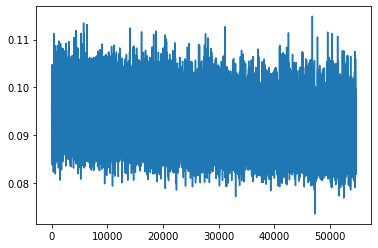

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


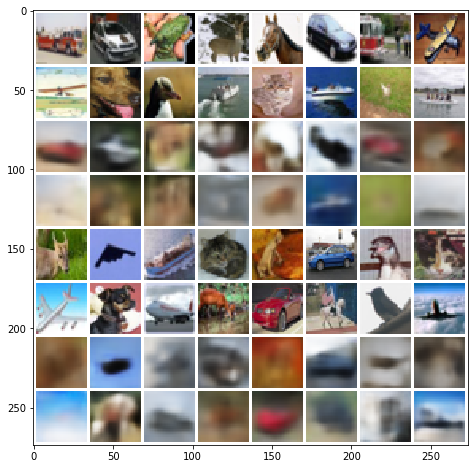

Mean squared dist: 0.045940485
epoch: 36 	 step:0 	 loss: 0.08453
epoch: 36 	 step:100 	 loss: 0.09466
epoch: 36 	 step:200 	 loss: 0.0915
epoch: 36 	 step:300 	 loss: 0.09421
epoch: 36 	 step:400 	 loss: 0.09549
epoch: 36 	 step:500 	 loss: 0.095
epoch: 36 	 step:600 	 loss: 0.09077
epoch: 36 	 step:700 	 loss: 0.09849
epoch: 36 	 step:800 	 loss: 0.09358
epoch: 36 	 step:900 	 loss: 0.08911
epoch: 36 	 step:1000 	 loss: 0.08513
epoch: 36 	 step:1100 	 loss: 0.09327
epoch: 36 	 step:1200 	 loss: 0.08598
epoch: 36 	 step:1300 	 loss: 0.09227
epoch: 36 	 step:1400 	 loss: 0.09113
epoch: 36 	 step:1500 	 loss: 0.08913


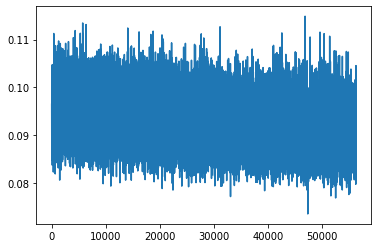

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


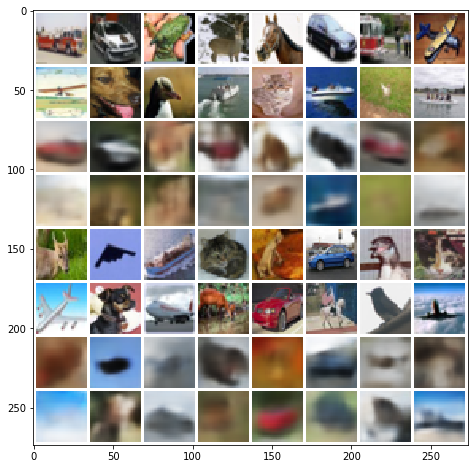

Mean squared dist: 0.0455424
epoch: 37 	 step:0 	 loss: 0.08644
epoch: 37 	 step:100 	 loss: 0.093
epoch: 37 	 step:200 	 loss: 0.09416
epoch: 37 	 step:300 	 loss: 0.08899
epoch: 37 	 step:400 	 loss: 0.0881
epoch: 37 	 step:500 	 loss: 0.08722
epoch: 37 	 step:600 	 loss: 0.08892
epoch: 37 	 step:700 	 loss: 0.09265
epoch: 37 	 step:800 	 loss: 0.09119
epoch: 37 	 step:900 	 loss: 0.09081
epoch: 37 	 step:1000 	 loss: 0.08782
epoch: 37 	 step:1100 	 loss: 0.09079
epoch: 37 	 step:1200 	 loss: 0.08958
epoch: 37 	 step:1300 	 loss: 0.09417
epoch: 37 	 step:1400 	 loss: 0.08988
epoch: 37 	 step:1500 	 loss: 0.08592


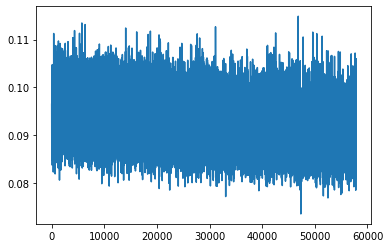

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


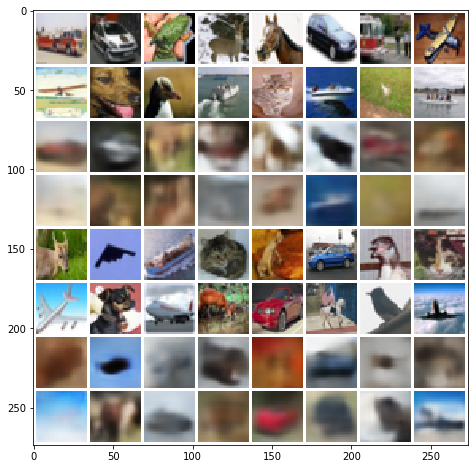

Mean squared dist: 0.045148052
epoch: 38 	 step:0 	 loss: 0.08683
epoch: 38 	 step:100 	 loss: 0.08783
epoch: 38 	 step:200 	 loss: 0.09111
epoch: 38 	 step:300 	 loss: 0.08595
epoch: 38 	 step:400 	 loss: 0.08874
epoch: 38 	 step:500 	 loss: 0.09462
epoch: 38 	 step:600 	 loss: 0.08924
epoch: 38 	 step:700 	 loss: 0.09097
epoch: 38 	 step:800 	 loss: 0.09448
epoch: 38 	 step:900 	 loss: 0.0877
epoch: 38 	 step:1000 	 loss: 0.08657
epoch: 38 	 step:1100 	 loss: 0.09289
epoch: 38 	 step:1200 	 loss: 0.09658
epoch: 38 	 step:1300 	 loss: 0.08961
epoch: 38 	 step:1400 	 loss: 0.0916
epoch: 38 	 step:1500 	 loss: 0.08925


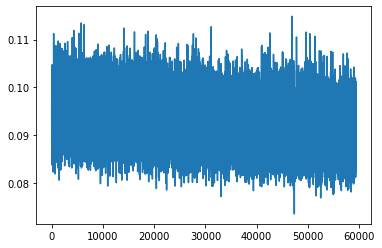

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


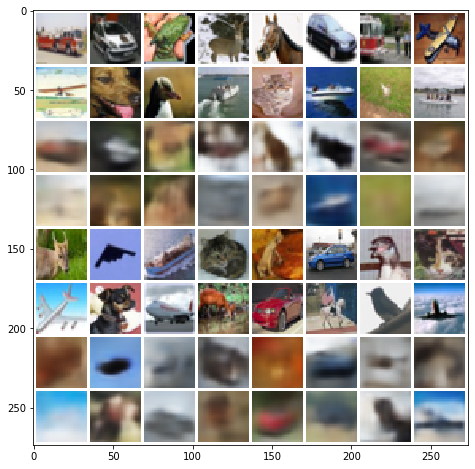

Mean squared dist: 0.045165934
epoch: 39 	 step:0 	 loss: 0.1011
epoch: 39 	 step:100 	 loss: 0.08496
epoch: 39 	 step:200 	 loss: 0.08401
epoch: 39 	 step:300 	 loss: 0.09382
epoch: 39 	 step:400 	 loss: 0.08132
epoch: 39 	 step:500 	 loss: 0.08743
epoch: 39 	 step:600 	 loss: 0.0853
epoch: 39 	 step:700 	 loss: 0.09544
epoch: 39 	 step:800 	 loss: 0.08978
epoch: 39 	 step:900 	 loss: 0.08345
epoch: 39 	 step:1000 	 loss: 0.09552
epoch: 39 	 step:1100 	 loss: 0.09534
epoch: 39 	 step:1200 	 loss: 0.09297
epoch: 39 	 step:1300 	 loss: 0.09699
epoch: 39 	 step:1400 	 loss: 0.09314
epoch: 39 	 step:1500 	 loss: 0.09424


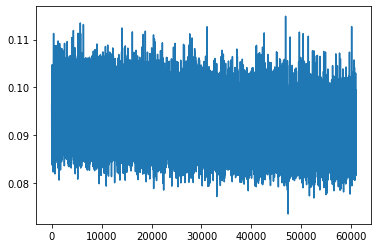

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


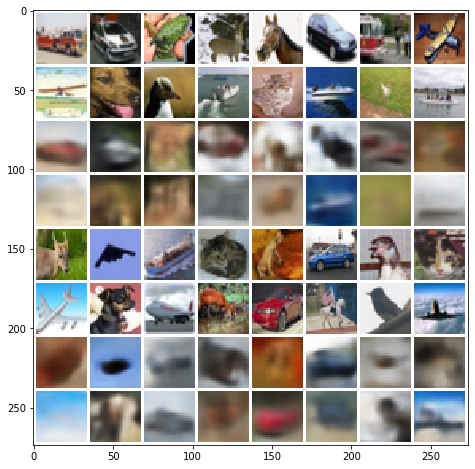

Mean squared dist: 0.04582891
epoch: 40 	 step:0 	 loss: 0.0987
epoch: 40 	 step:100 	 loss: 0.08782
epoch: 40 	 step:200 	 loss: 0.08503
epoch: 40 	 step:300 	 loss: 0.09012
epoch: 40 	 step:400 	 loss: 0.09171
epoch: 40 	 step:500 	 loss: 0.09453
epoch: 40 	 step:600 	 loss: 0.08756
epoch: 40 	 step:700 	 loss: 0.08799
epoch: 40 	 step:800 	 loss: 0.08409
epoch: 40 	 step:900 	 loss: 0.08452
epoch: 40 	 step:1000 	 loss: 0.08502
epoch: 40 	 step:1100 	 loss: 0.09325
epoch: 40 	 step:1200 	 loss: 0.08737
epoch: 40 	 step:1300 	 loss: 0.08938
epoch: 40 	 step:1400 	 loss: 0.08796
epoch: 40 	 step:1500 	 loss: 0.08811


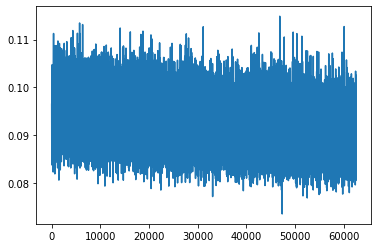

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


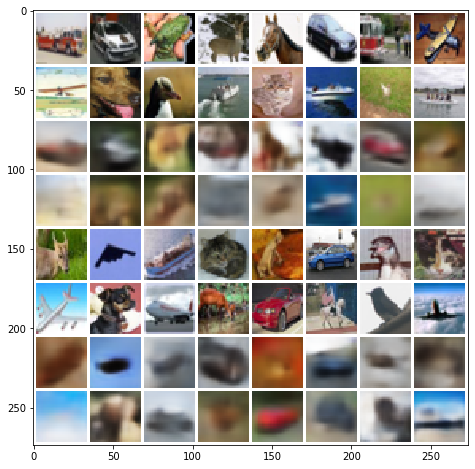

Mean squared dist: 0.045956336
epoch: 41 	 step:0 	 loss: 0.09316
epoch: 41 	 step:100 	 loss: 0.09319
epoch: 41 	 step:200 	 loss: 0.08892
epoch: 41 	 step:300 	 loss: 0.08829
epoch: 41 	 step:400 	 loss: 0.08547
epoch: 41 	 step:500 	 loss: 0.08806
epoch: 41 	 step:600 	 loss: 0.09308
epoch: 41 	 step:700 	 loss: 0.08826
epoch: 41 	 step:800 	 loss: 0.09652
epoch: 41 	 step:900 	 loss: 0.093
epoch: 41 	 step:1000 	 loss: 0.09219
epoch: 41 	 step:1100 	 loss: 0.09088
epoch: 41 	 step:1200 	 loss: 0.08471
epoch: 41 	 step:1300 	 loss: 0.0837
epoch: 41 	 step:1400 	 loss: 0.08775
epoch: 41 	 step:1500 	 loss: 0.08799


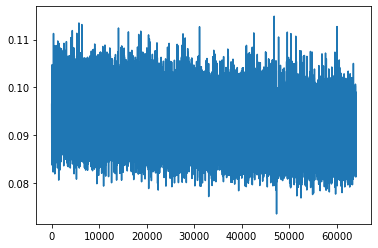

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


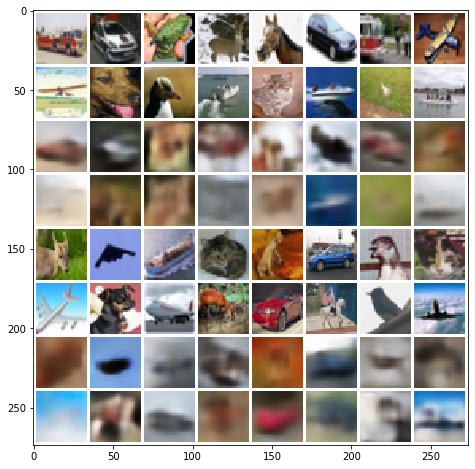

Mean squared dist: 0.045420583
epoch: 42 	 step:0 	 loss: 0.09037
epoch: 42 	 step:100 	 loss: 0.08927
epoch: 42 	 step:200 	 loss: 0.09452
epoch: 42 	 step:300 	 loss: 0.08622
epoch: 42 	 step:400 	 loss: 0.08733
epoch: 42 	 step:500 	 loss: 0.09445
epoch: 42 	 step:600 	 loss: 0.09537
epoch: 42 	 step:700 	 loss: 0.09442
epoch: 42 	 step:800 	 loss: 0.08968
epoch: 42 	 step:900 	 loss: 0.08698
epoch: 42 	 step:1000 	 loss: 0.09583
epoch: 42 	 step:1100 	 loss: 0.09242
epoch: 42 	 step:1200 	 loss: 0.09189
epoch: 42 	 step:1300 	 loss: 0.09226
epoch: 42 	 step:1400 	 loss: 0.09165
epoch: 42 	 step:1500 	 loss: 0.0838


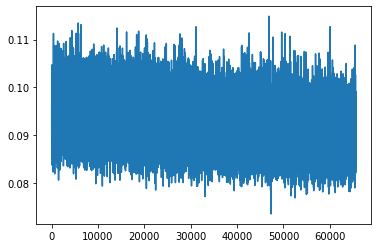

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


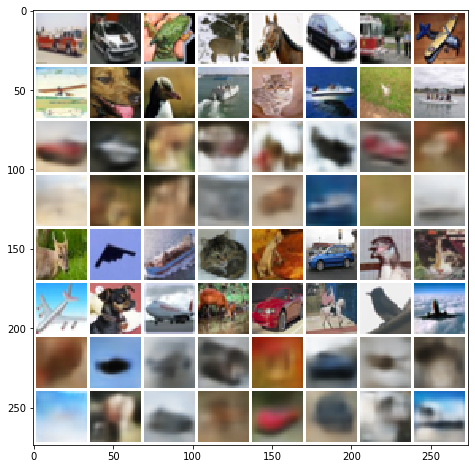

Mean squared dist: 0.046214066
epoch: 43 	 step:0 	 loss: 0.08736
epoch: 43 	 step:100 	 loss: 0.08858
epoch: 43 	 step:200 	 loss: 0.08603
epoch: 43 	 step:300 	 loss: 0.08819
epoch: 43 	 step:400 	 loss: 0.08595
epoch: 43 	 step:500 	 loss: 0.09014
epoch: 43 	 step:600 	 loss: 0.08721
epoch: 43 	 step:700 	 loss: 0.08965
epoch: 43 	 step:800 	 loss: 0.09387
epoch: 43 	 step:900 	 loss: 0.08968
epoch: 43 	 step:1000 	 loss: 0.08409
epoch: 43 	 step:1100 	 loss: 0.09169
epoch: 43 	 step:1200 	 loss: 0.09001
epoch: 43 	 step:1300 	 loss: 0.08599
epoch: 43 	 step:1400 	 loss: 0.08983
epoch: 43 	 step:1500 	 loss: 0.0912


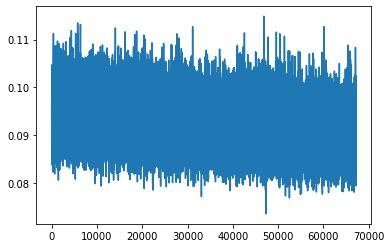

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


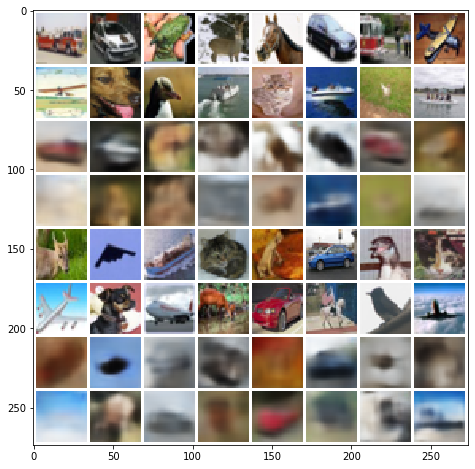

Mean squared dist: 0.04550671
epoch: 44 	 step:0 	 loss: 0.09389
epoch: 44 	 step:100 	 loss: 0.08858
epoch: 44 	 step:200 	 loss: 0.0888
epoch: 44 	 step:300 	 loss: 0.08558
epoch: 44 	 step:400 	 loss: 0.08809
epoch: 44 	 step:500 	 loss: 0.08515
epoch: 44 	 step:600 	 loss: 0.08728
epoch: 44 	 step:700 	 loss: 0.09092
epoch: 44 	 step:800 	 loss: 0.09266
epoch: 44 	 step:900 	 loss: 0.09357
epoch: 44 	 step:1000 	 loss: 0.0878
epoch: 44 	 step:1100 	 loss: 0.08987
epoch: 44 	 step:1200 	 loss: 0.08708
epoch: 44 	 step:1300 	 loss: 0.08895
epoch: 44 	 step:1400 	 loss: 0.09141
epoch: 44 	 step:1500 	 loss: 0.08894


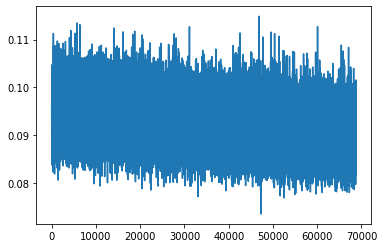

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


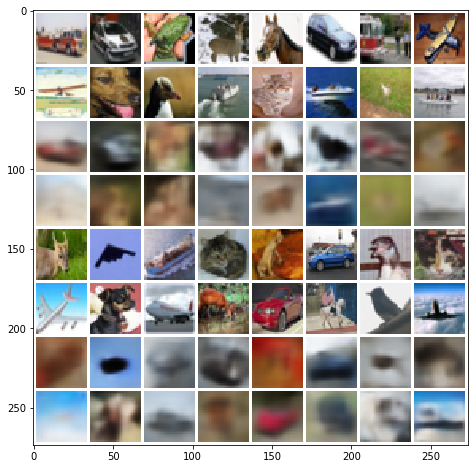

Mean squared dist: 0.044942386
epoch: 45 	 step:0 	 loss: 0.09122
epoch: 45 	 step:100 	 loss: 0.09885
epoch: 45 	 step:200 	 loss: 0.08407
epoch: 45 	 step:300 	 loss: 0.09537
epoch: 45 	 step:400 	 loss: 0.08637
epoch: 45 	 step:500 	 loss: 0.08457
epoch: 45 	 step:600 	 loss: 0.09156
epoch: 45 	 step:700 	 loss: 0.08234
epoch: 45 	 step:800 	 loss: 0.09041
epoch: 45 	 step:900 	 loss: 0.09041
epoch: 45 	 step:1000 	 loss: 0.09242
epoch: 45 	 step:1100 	 loss: 0.09321
epoch: 45 	 step:1200 	 loss: 0.08396
epoch: 45 	 step:1300 	 loss: 0.09355
epoch: 45 	 step:1400 	 loss: 0.09422
epoch: 45 	 step:1500 	 loss: 0.08923


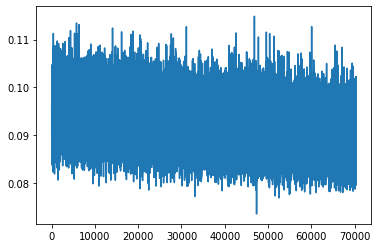

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


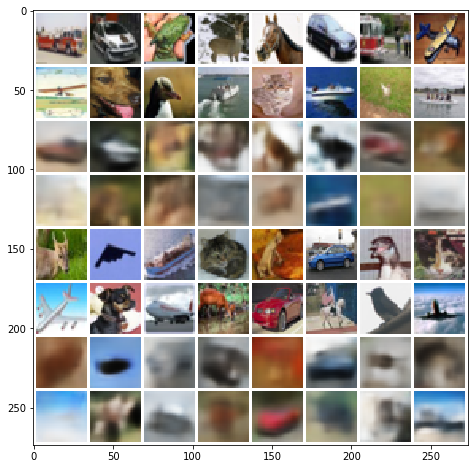

Mean squared dist: 0.046009257
epoch: 46 	 step:0 	 loss: 0.08519
epoch: 46 	 step:100 	 loss: 0.09492
epoch: 46 	 step:200 	 loss: 0.08929
epoch: 46 	 step:300 	 loss: 0.0851
epoch: 46 	 step:400 	 loss: 0.08285
epoch: 46 	 step:500 	 loss: 0.098
epoch: 46 	 step:600 	 loss: 0.08878
epoch: 46 	 step:700 	 loss: 0.09276
epoch: 46 	 step:800 	 loss: 0.09646
epoch: 46 	 step:900 	 loss: 0.08302
epoch: 46 	 step:1000 	 loss: 0.08115
epoch: 46 	 step:1100 	 loss: 0.08432
epoch: 46 	 step:1200 	 loss: 0.08899
epoch: 46 	 step:1300 	 loss: 0.09101
epoch: 46 	 step:1400 	 loss: 0.08156
epoch: 46 	 step:1500 	 loss: 0.08829


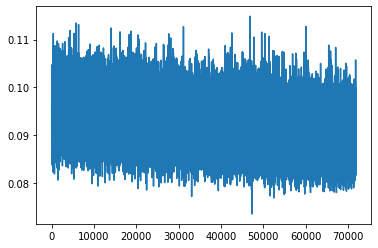

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


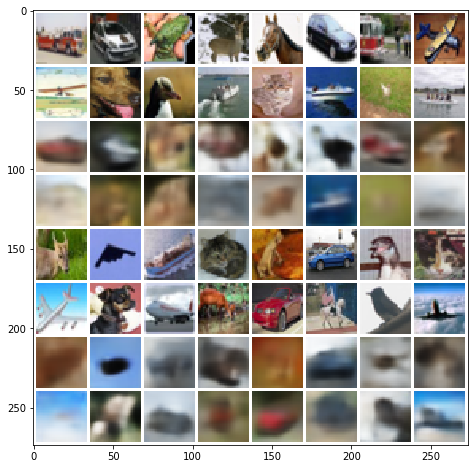

Mean squared dist: 0.04644322
epoch: 47 	 step:0 	 loss: 0.09271
epoch: 47 	 step:100 	 loss: 0.08968
epoch: 47 	 step:200 	 loss: 0.08353
epoch: 47 	 step:300 	 loss: 0.09148
epoch: 47 	 step:400 	 loss: 0.09459
epoch: 47 	 step:500 	 loss: 0.08696
epoch: 47 	 step:600 	 loss: 0.08766
epoch: 47 	 step:700 	 loss: 0.09018
epoch: 47 	 step:800 	 loss: 0.08974
epoch: 47 	 step:900 	 loss: 0.08545
epoch: 47 	 step:1000 	 loss: 0.08747
epoch: 47 	 step:1100 	 loss: 0.09167
epoch: 47 	 step:1200 	 loss: 0.09239
epoch: 47 	 step:1300 	 loss: 0.0896
epoch: 47 	 step:1400 	 loss: 0.09088
epoch: 47 	 step:1500 	 loss: 0.09287


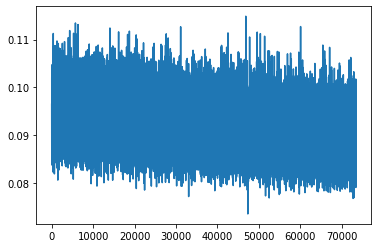

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


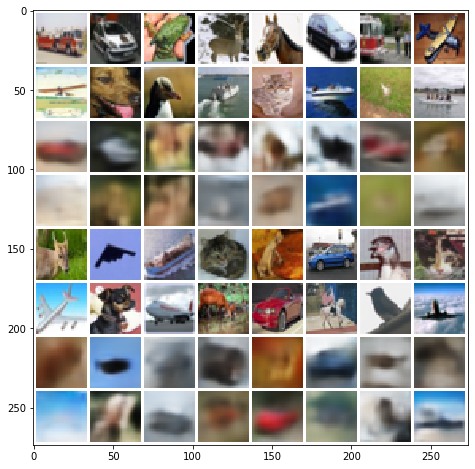

Mean squared dist: 0.045852996
epoch: 48 	 step:0 	 loss: 0.08717
epoch: 48 	 step:100 	 loss: 0.0828
epoch: 48 	 step:200 	 loss: 0.08459
epoch: 48 	 step:300 	 loss: 0.09187
epoch: 48 	 step:400 	 loss: 0.08623
epoch: 48 	 step:500 	 loss: 0.0932
epoch: 48 	 step:600 	 loss: 0.09568
epoch: 48 	 step:700 	 loss: 0.09065
epoch: 48 	 step:800 	 loss: 0.08615
epoch: 48 	 step:900 	 loss: 0.08769
epoch: 48 	 step:1000 	 loss: 0.08889
epoch: 48 	 step:1100 	 loss: 0.08975
epoch: 48 	 step:1200 	 loss: 0.078
epoch: 48 	 step:1300 	 loss: 0.08491
epoch: 48 	 step:1400 	 loss: 0.09557
epoch: 48 	 step:1500 	 loss: 0.09171


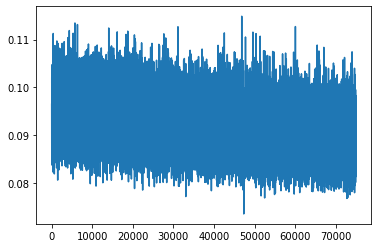

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


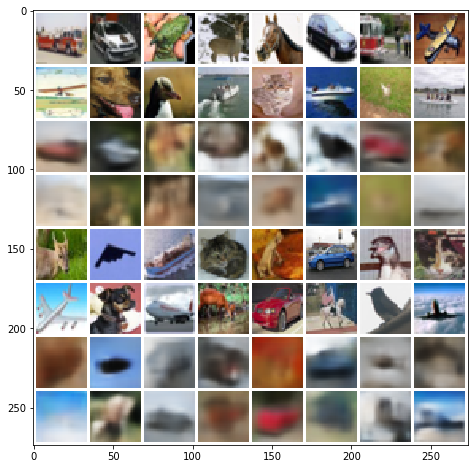

Mean squared dist: 0.04511932
epoch: 49 	 step:0 	 loss: 0.08413
epoch: 49 	 step:100 	 loss: 0.08979
epoch: 49 	 step:200 	 loss: 0.09063
epoch: 49 	 step:300 	 loss: 0.08148
epoch: 49 	 step:400 	 loss: 0.09042
epoch: 49 	 step:500 	 loss: 0.0901
epoch: 49 	 step:600 	 loss: 0.08583
epoch: 49 	 step:700 	 loss: 0.08243
epoch: 49 	 step:800 	 loss: 0.08684
epoch: 49 	 step:900 	 loss: 0.09106
epoch: 49 	 step:1000 	 loss: 0.08615
epoch: 49 	 step:1100 	 loss: 0.09197
epoch: 49 	 step:1200 	 loss: 0.08975
epoch: 49 	 step:1300 	 loss: 0.08306
epoch: 49 	 step:1400 	 loss: 0.09885
epoch: 49 	 step:1500 	 loss: 0.09691


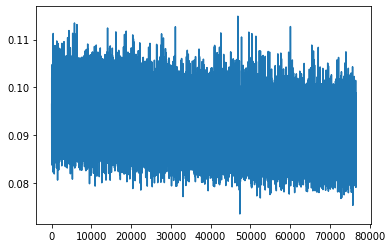

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


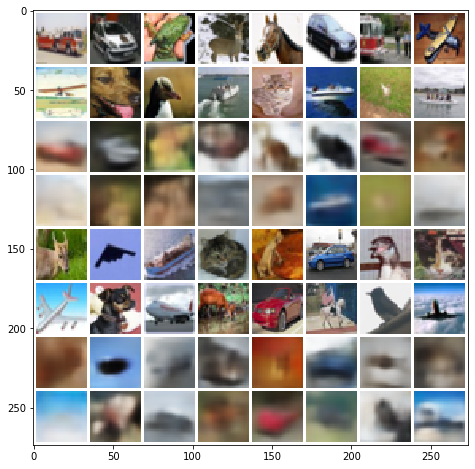

Mean squared dist: 0.04534301
epoch: 50 	 step:0 	 loss: 0.08942
epoch: 50 	 step:100 	 loss: 0.08683
epoch: 50 	 step:200 	 loss: 0.08938
epoch: 50 	 step:300 	 loss: 0.0949
epoch: 50 	 step:400 	 loss: 0.08576
epoch: 50 	 step:500 	 loss: 0.09011
epoch: 50 	 step:600 	 loss: 0.08517
epoch: 50 	 step:700 	 loss: 0.09063
epoch: 50 	 step:800 	 loss: 0.09201
epoch: 50 	 step:900 	 loss: 0.08996
epoch: 50 	 step:1000 	 loss: 0.08209
epoch: 50 	 step:1100 	 loss: 0.09058
epoch: 50 	 step:1200 	 loss: 0.09693
epoch: 50 	 step:1300 	 loss: 0.0879
epoch: 50 	 step:1400 	 loss: 0.09366
epoch: 50 	 step:1500 	 loss: 0.08764


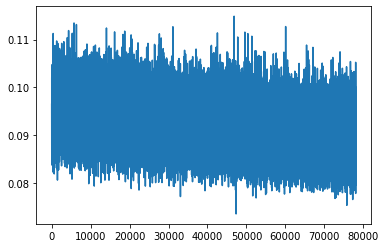

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


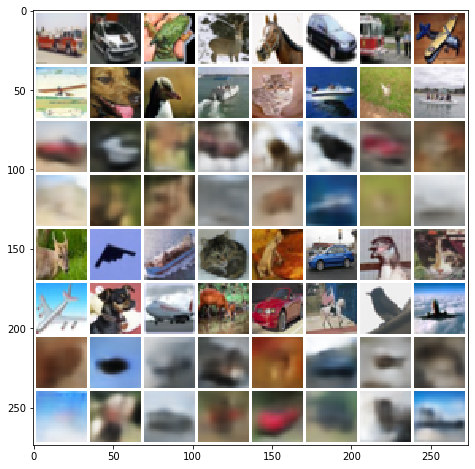

Mean squared dist: 0.04560099
epoch: 51 	 step:0 	 loss: 0.08438
epoch: 51 	 step:100 	 loss: 0.08916
epoch: 51 	 step:200 	 loss: 0.09053
epoch: 51 	 step:300 	 loss: 0.08783
epoch: 51 	 step:400 	 loss: 0.08878
epoch: 51 	 step:500 	 loss: 0.09011
epoch: 51 	 step:600 	 loss: 0.0921
epoch: 51 	 step:700 	 loss: 0.08512
epoch: 51 	 step:800 	 loss: 0.08935
epoch: 51 	 step:900 	 loss: 0.09493
epoch: 51 	 step:1000 	 loss: 0.0905
epoch: 51 	 step:1100 	 loss: 0.09556
epoch: 51 	 step:1200 	 loss: 0.09048
epoch: 51 	 step:1300 	 loss: 0.09112
epoch: 51 	 step:1400 	 loss: 0.09421
epoch: 51 	 step:1500 	 loss: 0.0856


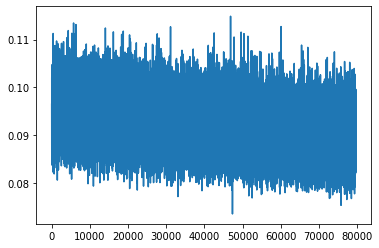

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


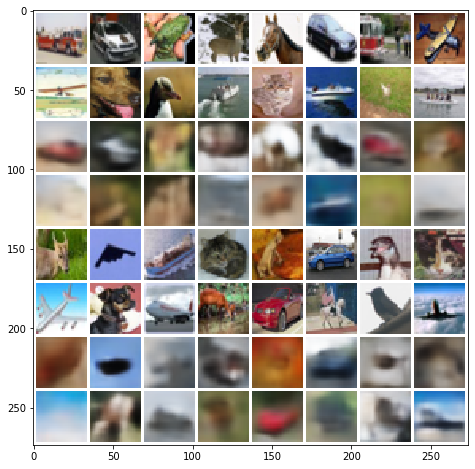

Mean squared dist: 0.046212282
epoch: 52 	 step:0 	 loss: 0.08628
epoch: 52 	 step:100 	 loss: 0.0887
epoch: 52 	 step:200 	 loss: 0.08622
epoch: 52 	 step:300 	 loss: 0.08742
epoch: 52 	 step:400 	 loss: 0.09013
epoch: 52 	 step:500 	 loss: 0.08889
epoch: 52 	 step:600 	 loss: 0.09145
epoch: 52 	 step:700 	 loss: 0.08132
epoch: 52 	 step:800 	 loss: 0.09013
epoch: 52 	 step:900 	 loss: 0.09343
epoch: 52 	 step:1000 	 loss: 0.0978
epoch: 52 	 step:1100 	 loss: 0.09031
epoch: 52 	 step:1200 	 loss: 0.08699
epoch: 52 	 step:1300 	 loss: 0.0958
epoch: 52 	 step:1400 	 loss: 0.08831
epoch: 52 	 step:1500 	 loss: 0.08669


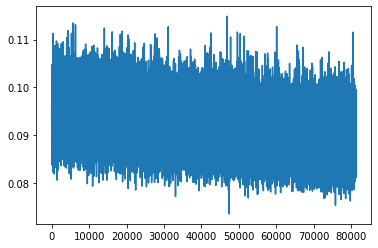

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


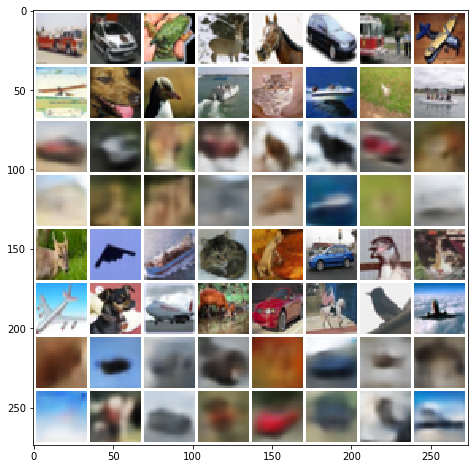

Mean squared dist: 0.04586835
epoch: 53 	 step:0 	 loss: 0.08891
epoch: 53 	 step:100 	 loss: 0.08435
epoch: 53 	 step:200 	 loss: 0.09206
epoch: 53 	 step:300 	 loss: 0.09227
epoch: 53 	 step:400 	 loss: 0.0857
epoch: 53 	 step:500 	 loss: 0.09037
epoch: 53 	 step:600 	 loss: 0.08833
epoch: 53 	 step:700 	 loss: 0.0897
epoch: 53 	 step:800 	 loss: 0.08994
epoch: 53 	 step:900 	 loss: 0.1014
epoch: 53 	 step:1000 	 loss: 0.09062
epoch: 53 	 step:1100 	 loss: 0.0863
epoch: 53 	 step:1200 	 loss: 0.0898
epoch: 53 	 step:1300 	 loss: 0.08742
epoch: 53 	 step:1400 	 loss: 0.08783
epoch: 53 	 step:1500 	 loss: 0.09264


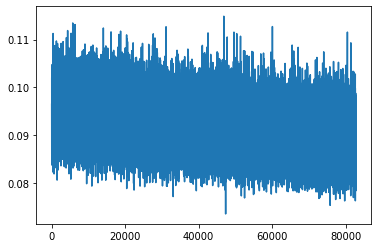

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


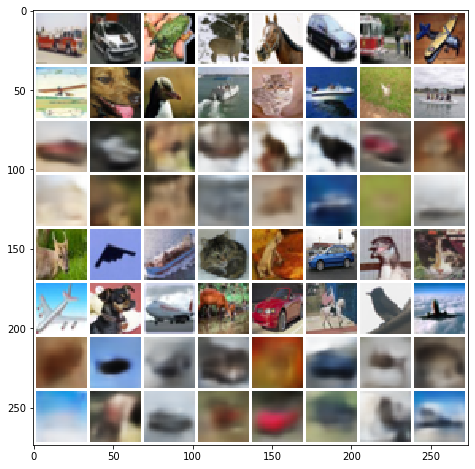

Mean squared dist: 0.04594861
epoch: 54 	 step:0 	 loss: 0.08923
epoch: 54 	 step:100 	 loss: 0.09007
epoch: 54 	 step:200 	 loss: 0.09007
epoch: 54 	 step:300 	 loss: 0.08229
epoch: 54 	 step:400 	 loss: 0.08152
epoch: 54 	 step:500 	 loss: 0.09421
epoch: 54 	 step:600 	 loss: 0.09507
epoch: 54 	 step:700 	 loss: 0.09265
epoch: 54 	 step:800 	 loss: 0.08648
epoch: 54 	 step:900 	 loss: 0.0879
epoch: 54 	 step:1000 	 loss: 0.08541
epoch: 54 	 step:1100 	 loss: 0.09567
epoch: 54 	 step:1200 	 loss: 0.08845
epoch: 54 	 step:1300 	 loss: 0.09119
epoch: 54 	 step:1400 	 loss: 0.09677
epoch: 54 	 step:1500 	 loss: 0.09086


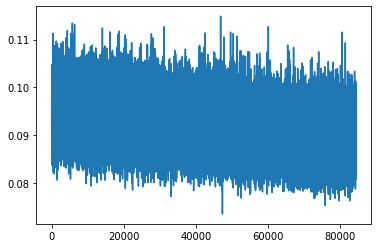

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


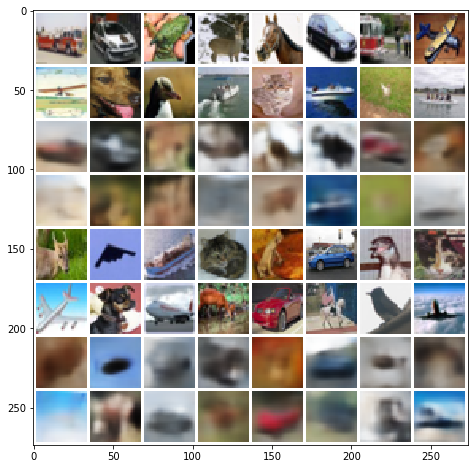

Mean squared dist: 0.045207582
epoch: 55 	 step:0 	 loss: 0.08535
epoch: 55 	 step:100 	 loss: 0.09099
epoch: 55 	 step:200 	 loss: 0.08703
epoch: 55 	 step:300 	 loss: 0.08967
epoch: 55 	 step:400 	 loss: 0.09019
epoch: 55 	 step:500 	 loss: 0.09958
epoch: 55 	 step:600 	 loss: 0.08757
epoch: 55 	 step:700 	 loss: 0.08972
epoch: 55 	 step:800 	 loss: 0.08485
epoch: 55 	 step:900 	 loss: 0.0863
epoch: 55 	 step:1000 	 loss: 0.09069
epoch: 55 	 step:1100 	 loss: 0.08778
epoch: 55 	 step:1200 	 loss: 0.08702
epoch: 55 	 step:1300 	 loss: 0.09181
epoch: 55 	 step:1400 	 loss: 0.08179
epoch: 55 	 step:1500 	 loss: 0.0914


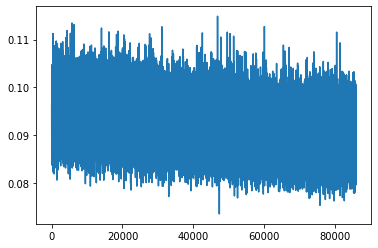

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


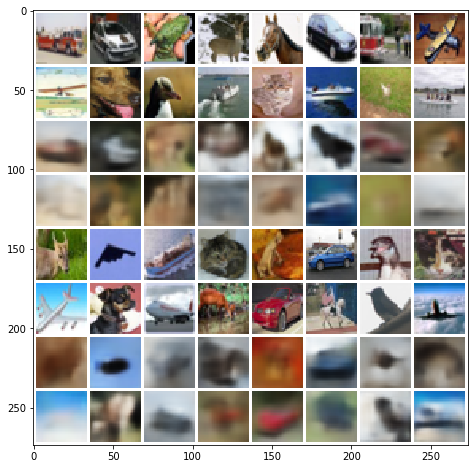

Mean squared dist: 0.04557477
epoch: 56 	 step:0 	 loss: 0.09187
epoch: 56 	 step:100 	 loss: 0.09104
epoch: 56 	 step:200 	 loss: 0.08908
epoch: 56 	 step:300 	 loss: 0.08632
epoch: 56 	 step:400 	 loss: 0.08724
epoch: 56 	 step:500 	 loss: 0.08917
epoch: 56 	 step:600 	 loss: 0.08646
epoch: 56 	 step:700 	 loss: 0.09536
epoch: 56 	 step:800 	 loss: 0.07916
epoch: 56 	 step:900 	 loss: 0.09818
epoch: 56 	 step:1000 	 loss: 0.08787
epoch: 56 	 step:1100 	 loss: 0.09024
epoch: 56 	 step:1200 	 loss: 0.09
epoch: 56 	 step:1300 	 loss: 0.09298
epoch: 56 	 step:1400 	 loss: 0.08228
epoch: 56 	 step:1500 	 loss: 0.09212


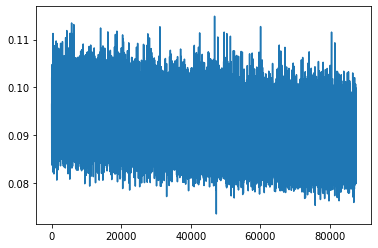

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


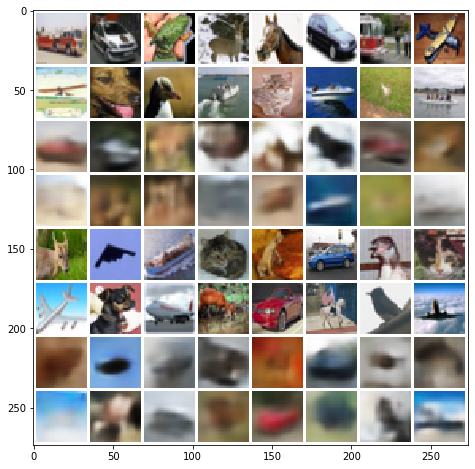

Mean squared dist: 0.046548694
epoch: 57 	 step:0 	 loss: 0.08275
epoch: 57 	 step:100 	 loss: 0.09053
epoch: 57 	 step:200 	 loss: 0.09105
epoch: 57 	 step:300 	 loss: 0.08335
epoch: 57 	 step:400 	 loss: 0.09132
epoch: 57 	 step:500 	 loss: 0.08755
epoch: 57 	 step:600 	 loss: 0.08978
epoch: 57 	 step:700 	 loss: 0.08682
epoch: 57 	 step:800 	 loss: 0.08224
epoch: 57 	 step:900 	 loss: 0.08111
epoch: 57 	 step:1000 	 loss: 0.09359
epoch: 57 	 step:1100 	 loss: 0.08464
epoch: 57 	 step:1200 	 loss: 0.08967
epoch: 57 	 step:1300 	 loss: 0.09165
epoch: 57 	 step:1400 	 loss: 0.08496
epoch: 57 	 step:1500 	 loss: 0.08599


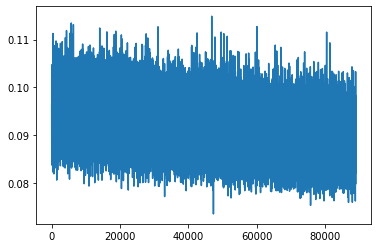

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


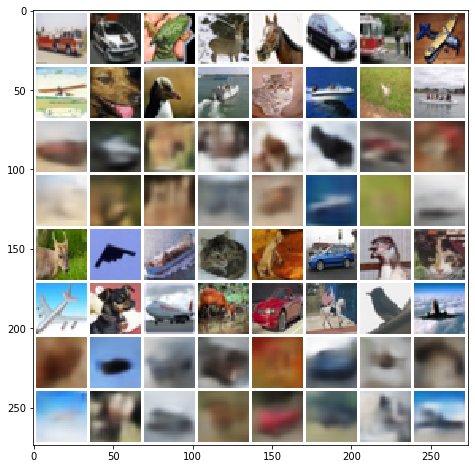

Mean squared dist: 0.045285355
epoch: 58 	 step:0 	 loss: 0.08689
epoch: 58 	 step:100 	 loss: 0.08834
epoch: 58 	 step:200 	 loss: 0.09146
epoch: 58 	 step:300 	 loss: 0.08861
epoch: 58 	 step:400 	 loss: 0.08747
epoch: 58 	 step:500 	 loss: 0.08887
epoch: 58 	 step:600 	 loss: 0.08682
epoch: 58 	 step:700 	 loss: 0.08349
epoch: 58 	 step:800 	 loss: 0.0915
epoch: 58 	 step:900 	 loss: 0.08654
epoch: 58 	 step:1000 	 loss: 0.09569
epoch: 58 	 step:1100 	 loss: 0.09347
epoch: 58 	 step:1200 	 loss: 0.09099
epoch: 58 	 step:1300 	 loss: 0.08896
epoch: 58 	 step:1400 	 loss: 0.08816
epoch: 58 	 step:1500 	 loss: 0.09187


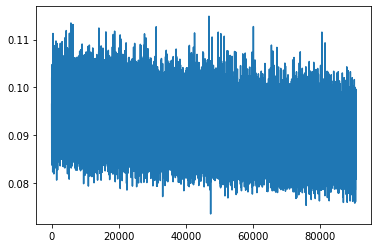

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


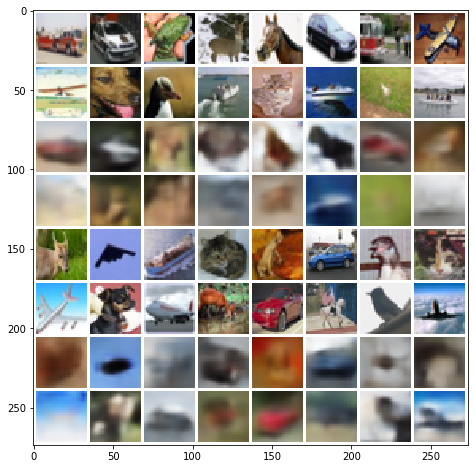

Mean squared dist: 0.04617573
epoch: 59 	 step:0 	 loss: 0.08949
epoch: 59 	 step:100 	 loss: 0.08288
epoch: 59 	 step:200 	 loss: 0.08136
epoch: 59 	 step:300 	 loss: 0.08931
epoch: 59 	 step:400 	 loss: 0.08627
epoch: 59 	 step:500 	 loss: 0.08547
epoch: 59 	 step:600 	 loss: 0.09143
epoch: 59 	 step:700 	 loss: 0.08739
epoch: 59 	 step:800 	 loss: 0.0913
epoch: 59 	 step:900 	 loss: 0.08393
epoch: 59 	 step:1000 	 loss: 0.08777
epoch: 59 	 step:1100 	 loss: 0.08816
epoch: 59 	 step:1200 	 loss: 0.08145
epoch: 59 	 step:1300 	 loss: 0.09127
epoch: 59 	 step:1400 	 loss: 0.08973
epoch: 59 	 step:1500 	 loss: 0.08821


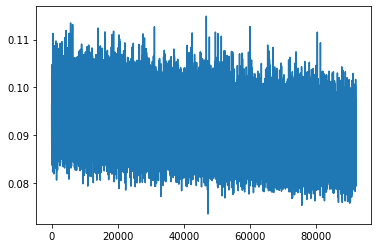

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


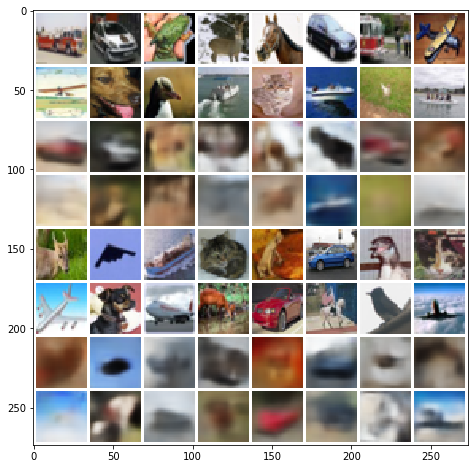

Mean squared dist: 0.046349283
epoch: 60 	 step:0 	 loss: 0.09225
epoch: 60 	 step:100 	 loss: 0.09292
epoch: 60 	 step:200 	 loss: 0.08586
epoch: 60 	 step:300 	 loss: 0.08531
epoch: 60 	 step:400 	 loss: 0.07748
epoch: 60 	 step:500 	 loss: 0.08778
epoch: 60 	 step:600 	 loss: 0.08604
epoch: 60 	 step:700 	 loss: 0.08318
epoch: 60 	 step:800 	 loss: 0.09392
epoch: 60 	 step:900 	 loss: 0.09555
epoch: 60 	 step:1000 	 loss: 0.08587
epoch: 60 	 step:1100 	 loss: 0.09201
epoch: 60 	 step:1200 	 loss: 0.08531
epoch: 60 	 step:1300 	 loss: 0.08513
epoch: 60 	 step:1400 	 loss: 0.08544
epoch: 60 	 step:1500 	 loss: 0.08526


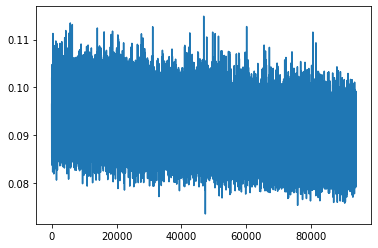

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


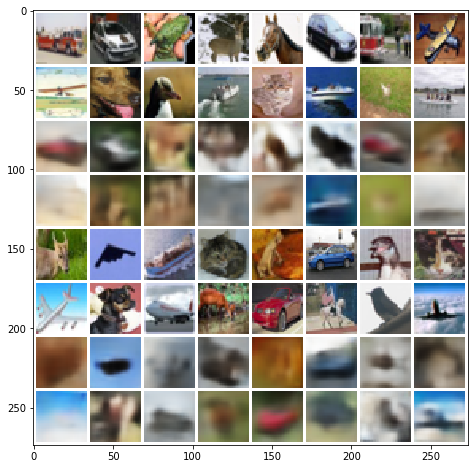

Mean squared dist: 0.0460159
epoch: 61 	 step:0 	 loss: 0.08154
epoch: 61 	 step:100 	 loss: 0.08409
epoch: 61 	 step:200 	 loss: 0.08797
epoch: 61 	 step:300 	 loss: 0.08675
epoch: 61 	 step:400 	 loss: 0.08857
epoch: 61 	 step:500 	 loss: 0.09798
epoch: 61 	 step:600 	 loss: 0.07965
epoch: 61 	 step:700 	 loss: 0.08058
epoch: 61 	 step:800 	 loss: 0.07701
epoch: 61 	 step:900 	 loss: 0.09108
epoch: 61 	 step:1000 	 loss: 0.08732
epoch: 61 	 step:1100 	 loss: 0.08712
epoch: 61 	 step:1200 	 loss: 0.08631
epoch: 61 	 step:1300 	 loss: 0.08185
epoch: 61 	 step:1400 	 loss: 0.08538
epoch: 61 	 step:1500 	 loss: 0.0914


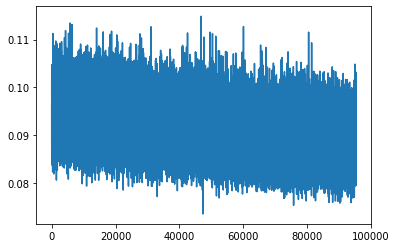

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


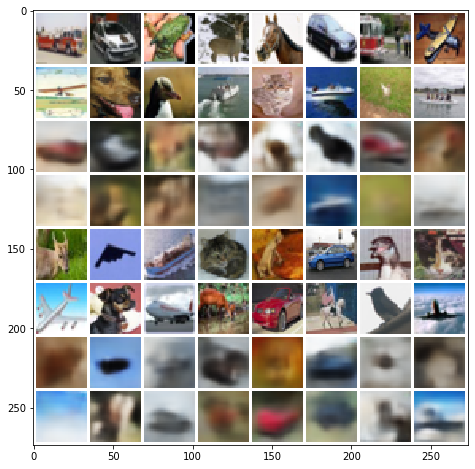

Mean squared dist: 0.046465926
epoch: 62 	 step:0 	 loss: 0.08661
epoch: 62 	 step:100 	 loss: 0.08788
epoch: 62 	 step:200 	 loss: 0.09176
epoch: 62 	 step:300 	 loss: 0.08535
epoch: 62 	 step:400 	 loss: 0.07846
epoch: 62 	 step:500 	 loss: 0.08191
epoch: 62 	 step:600 	 loss: 0.08775
epoch: 62 	 step:700 	 loss: 0.08542
epoch: 62 	 step:800 	 loss: 0.08677
epoch: 62 	 step:900 	 loss: 0.08514
epoch: 62 	 step:1000 	 loss: 0.09097
epoch: 62 	 step:1100 	 loss: 0.08722
epoch: 62 	 step:1200 	 loss: 0.0932
epoch: 62 	 step:1300 	 loss: 0.08808
epoch: 62 	 step:1400 	 loss: 0.09908
epoch: 62 	 step:1500 	 loss: 0.09328


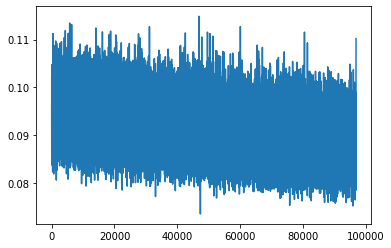

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


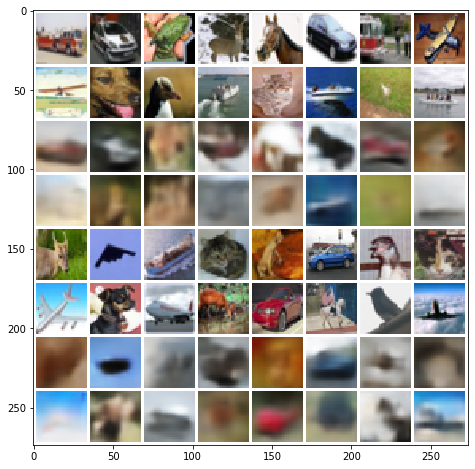

Mean squared dist: 0.0462458
epoch: 63 	 step:0 	 loss: 0.09119
epoch: 63 	 step:100 	 loss: 0.08927
epoch: 63 	 step:200 	 loss: 0.08465
epoch: 63 	 step:300 	 loss: 0.0824
epoch: 63 	 step:400 	 loss: 0.08599
epoch: 63 	 step:500 	 loss: 0.09971
epoch: 63 	 step:600 	 loss: 0.09545
epoch: 63 	 step:700 	 loss: 0.09158
epoch: 63 	 step:800 	 loss: 0.08848
epoch: 63 	 step:900 	 loss: 0.08449
epoch: 63 	 step:1000 	 loss: 0.084
epoch: 63 	 step:1100 	 loss: 0.09364
epoch: 63 	 step:1200 	 loss: 0.08477
epoch: 63 	 step:1300 	 loss: 0.09407
epoch: 63 	 step:1400 	 loss: 0.08755
epoch: 63 	 step:1500 	 loss: 0.09423


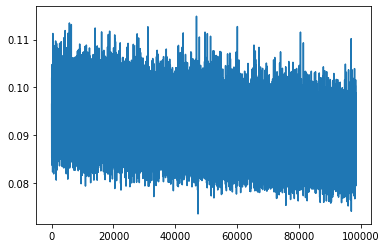

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


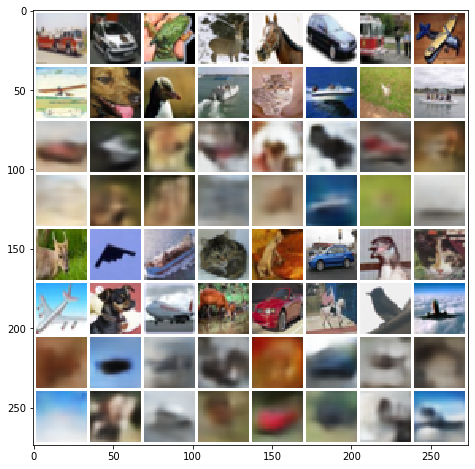

Mean squared dist: 0.04630074
epoch: 64 	 step:0 	 loss: 0.08564
epoch: 64 	 step:100 	 loss: 0.08785
epoch: 64 	 step:200 	 loss: 0.08599
epoch: 64 	 step:300 	 loss: 0.08783
epoch: 64 	 step:400 	 loss: 0.09337
epoch: 64 	 step:500 	 loss: 0.08766
epoch: 64 	 step:600 	 loss: 0.09266
epoch: 64 	 step:700 	 loss: 0.09635
epoch: 64 	 step:800 	 loss: 0.08347
epoch: 64 	 step:900 	 loss: 0.08311
epoch: 64 	 step:1000 	 loss: 0.08636
epoch: 64 	 step:1100 	 loss: 0.08531
epoch: 64 	 step:1200 	 loss: 0.08374
epoch: 64 	 step:1300 	 loss: 0.0949
epoch: 64 	 step:1400 	 loss: 0.08707
epoch: 64 	 step:1500 	 loss: 0.08253


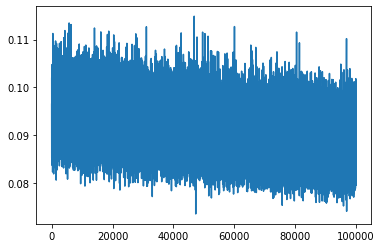

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


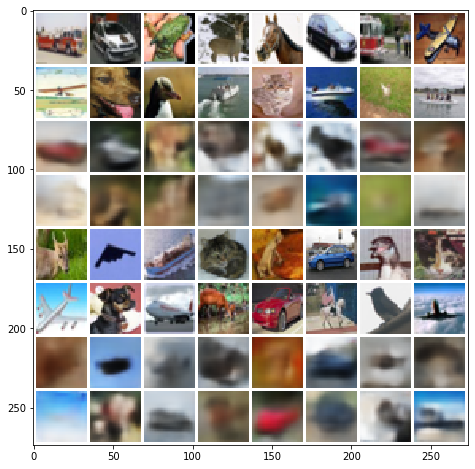

Mean squared dist: 0.04609868
epoch: 65 	 step:0 	 loss: 0.08741
epoch: 65 	 step:100 	 loss: 0.09381
epoch: 65 	 step:200 	 loss: 0.09438
epoch: 65 	 step:300 	 loss: 0.08752
epoch: 65 	 step:400 	 loss: 0.08854
epoch: 65 	 step:500 	 loss: 0.0852
epoch: 65 	 step:600 	 loss: 0.09531
epoch: 65 	 step:700 	 loss: 0.08474
epoch: 65 	 step:800 	 loss: 0.09287
epoch: 65 	 step:900 	 loss: 0.08589
epoch: 65 	 step:1000 	 loss: 0.09138
epoch: 65 	 step:1100 	 loss: 0.09344
epoch: 65 	 step:1200 	 loss: 0.08822
epoch: 65 	 step:1300 	 loss: 0.08782
epoch: 65 	 step:1400 	 loss: 0.09315
epoch: 65 	 step:1500 	 loss: 0.0849


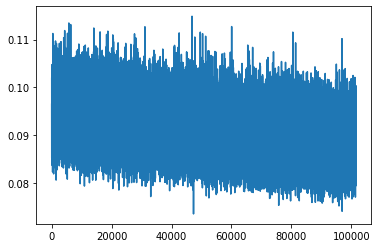

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


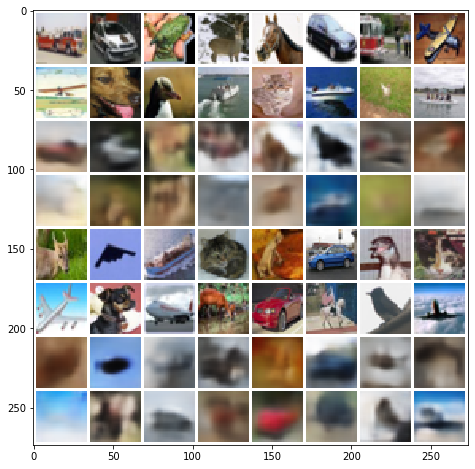

Mean squared dist: 0.046226338
epoch: 66 	 step:0 	 loss: 0.09504
epoch: 66 	 step:100 	 loss: 0.09017
epoch: 66 	 step:200 	 loss: 0.08477
epoch: 66 	 step:300 	 loss: 0.08722
epoch: 66 	 step:400 	 loss: 0.0884
epoch: 66 	 step:500 	 loss: 0.09438
epoch: 66 	 step:600 	 loss: 0.08331
epoch: 66 	 step:700 	 loss: 0.08634
epoch: 66 	 step:800 	 loss: 0.09168
epoch: 66 	 step:900 	 loss: 0.08374
epoch: 66 	 step:1000 	 loss: 0.08849
epoch: 66 	 step:1100 	 loss: 0.08741
epoch: 66 	 step:1200 	 loss: 0.08972
epoch: 66 	 step:1300 	 loss: 0.09483
epoch: 66 	 step:1400 	 loss: 0.09192
epoch: 66 	 step:1500 	 loss: 0.08312


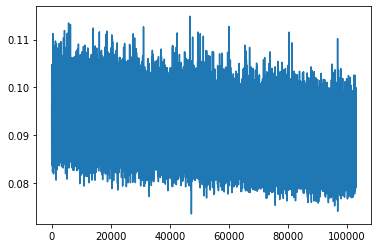

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


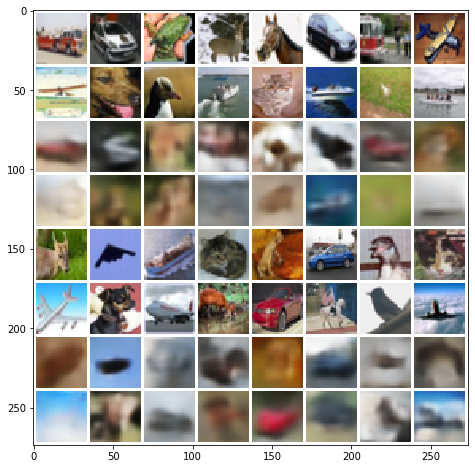

Mean squared dist: 0.0458885
epoch: 67 	 step:0 	 loss: 0.08189
epoch: 67 	 step:100 	 loss: 0.09036
epoch: 67 	 step:200 	 loss: 0.08137
epoch: 67 	 step:300 	 loss: 0.07946
epoch: 67 	 step:400 	 loss: 0.08185
epoch: 67 	 step:500 	 loss: 0.08608
epoch: 67 	 step:600 	 loss: 0.08785
epoch: 67 	 step:700 	 loss: 0.08232
epoch: 67 	 step:800 	 loss: 0.08192
epoch: 67 	 step:900 	 loss: 0.08579
epoch: 67 	 step:1000 	 loss: 0.08357
epoch: 67 	 step:1100 	 loss: 0.08201
epoch: 67 	 step:1200 	 loss: 0.08967
epoch: 67 	 step:1300 	 loss: 0.08795
epoch: 67 	 step:1400 	 loss: 0.08239
epoch: 67 	 step:1500 	 loss: 0.089


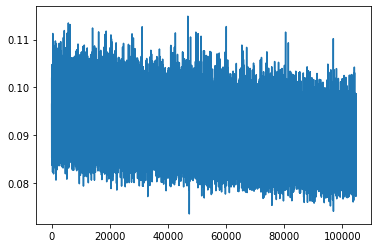

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


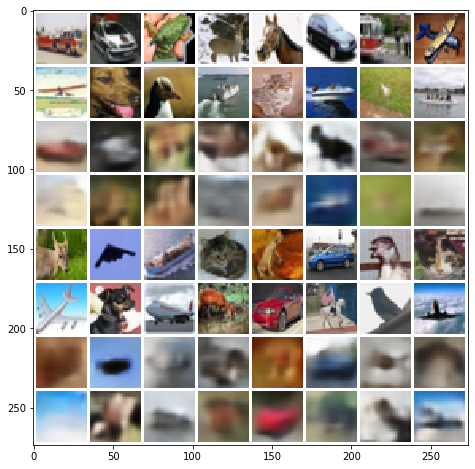

Mean squared dist: 0.046329662
epoch: 68 	 step:0 	 loss: 0.08571
epoch: 68 	 step:100 	 loss: 0.08016
epoch: 68 	 step:200 	 loss: 0.08779
epoch: 68 	 step:300 	 loss: 0.08643
epoch: 68 	 step:400 	 loss: 0.08213
epoch: 68 	 step:500 	 loss: 0.08564
epoch: 68 	 step:600 	 loss: 0.08794
epoch: 68 	 step:700 	 loss: 0.08515
epoch: 68 	 step:800 	 loss: 0.08396
epoch: 68 	 step:900 	 loss: 0.08819
epoch: 68 	 step:1000 	 loss: 0.08587
epoch: 68 	 step:1100 	 loss: 0.08586
epoch: 68 	 step:1200 	 loss: 0.08296
epoch: 68 	 step:1300 	 loss: 0.08568
epoch: 68 	 step:1400 	 loss: 0.09655
epoch: 68 	 step:1500 	 loss: 0.09818


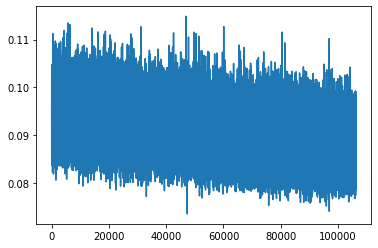

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


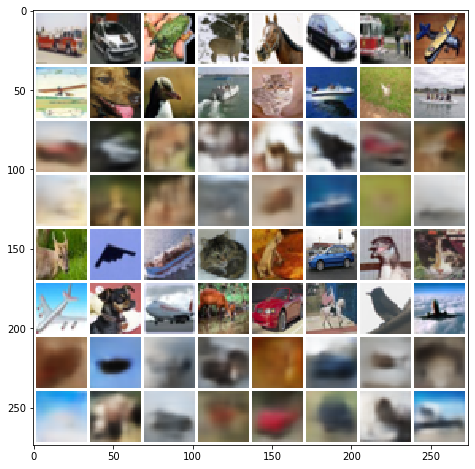

Mean squared dist: 0.046170432
epoch: 69 	 step:0 	 loss: 0.08757
epoch: 69 	 step:100 	 loss: 0.084
epoch: 69 	 step:200 	 loss: 0.0871
epoch: 69 	 step:300 	 loss: 0.08381
epoch: 69 	 step:400 	 loss: 0.08937
epoch: 69 	 step:500 	 loss: 0.08233
epoch: 69 	 step:600 	 loss: 0.08683
epoch: 69 	 step:700 	 loss: 0.08651
epoch: 69 	 step:800 	 loss: 0.09263
epoch: 69 	 step:900 	 loss: 0.08247
epoch: 69 	 step:1000 	 loss: 0.08399
epoch: 69 	 step:1100 	 loss: 0.08344
epoch: 69 	 step:1200 	 loss: 0.08655
epoch: 69 	 step:1300 	 loss: 0.07985
epoch: 69 	 step:1400 	 loss: 0.09058
epoch: 69 	 step:1500 	 loss: 0.08076


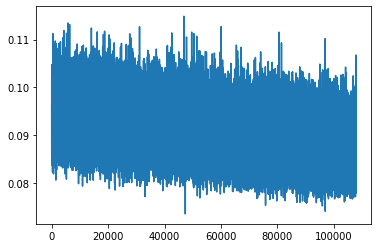

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


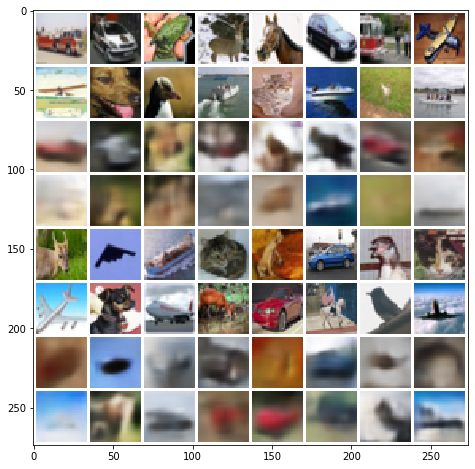

Mean squared dist: 0.046504587
epoch: 70 	 step:0 	 loss: 0.08659
epoch: 70 	 step:100 	 loss: 0.08878
epoch: 70 	 step:200 	 loss: 0.08326
epoch: 70 	 step:300 	 loss: 0.08734
epoch: 70 	 step:400 	 loss: 0.08193
epoch: 70 	 step:500 	 loss: 0.08841
epoch: 70 	 step:600 	 loss: 0.08673
epoch: 70 	 step:700 	 loss: 0.09015
epoch: 70 	 step:800 	 loss: 0.09025
epoch: 70 	 step:900 	 loss: 0.08681
epoch: 70 	 step:1000 	 loss: 0.08252
epoch: 70 	 step:1100 	 loss: 0.08498
epoch: 70 	 step:1200 	 loss: 0.08657
epoch: 70 	 step:1300 	 loss: 0.084
epoch: 70 	 step:1400 	 loss: 0.08182
epoch: 70 	 step:1500 	 loss: 0.09246


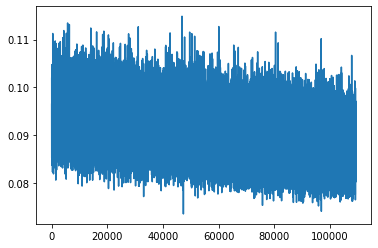

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


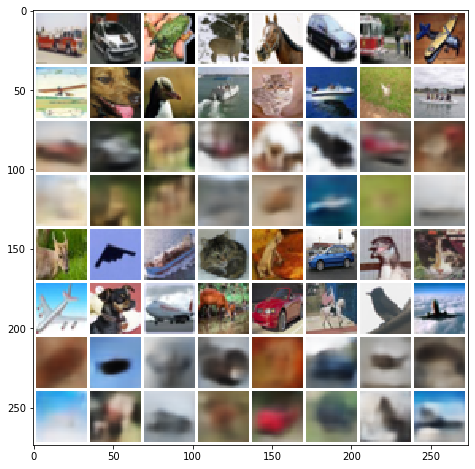

Mean squared dist: 0.045609534
epoch: 71 	 step:0 	 loss: 0.08422
epoch: 71 	 step:100 	 loss: 0.08581
epoch: 71 	 step:200 	 loss: 0.08962
epoch: 71 	 step:300 	 loss: 0.08093
epoch: 71 	 step:400 	 loss: 0.08585
epoch: 71 	 step:500 	 loss: 0.08524
epoch: 71 	 step:600 	 loss: 0.08945
epoch: 71 	 step:700 	 loss: 0.08729
epoch: 71 	 step:800 	 loss: 0.09096
epoch: 71 	 step:900 	 loss: 0.0831
epoch: 71 	 step:1000 	 loss: 0.09205
epoch: 71 	 step:1100 	 loss: 0.08936
epoch: 71 	 step:1200 	 loss: 0.09137
epoch: 71 	 step:1300 	 loss: 0.08761
epoch: 71 	 step:1400 	 loss: 0.0898
epoch: 71 	 step:1500 	 loss: 0.09361


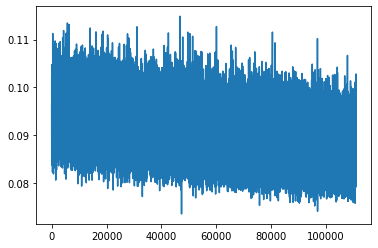

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


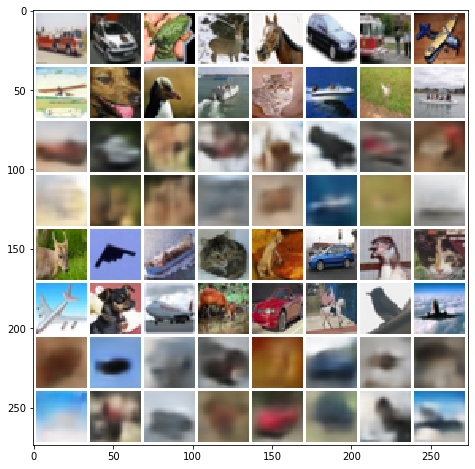

Mean squared dist: 0.045298725
epoch: 72 	 step:0 	 loss: 0.08265
epoch: 72 	 step:100 	 loss: 0.08822
epoch: 72 	 step:200 	 loss: 0.08598
epoch: 72 	 step:300 	 loss: 0.09165
epoch: 72 	 step:400 	 loss: 0.09612
epoch: 72 	 step:500 	 loss: 0.08013
epoch: 72 	 step:600 	 loss: 0.08853
epoch: 72 	 step:700 	 loss: 0.09192
epoch: 72 	 step:800 	 loss: 0.08918
epoch: 72 	 step:900 	 loss: 0.09974
epoch: 72 	 step:1000 	 loss: 0.084
epoch: 72 	 step:1100 	 loss: 0.09169
epoch: 72 	 step:1200 	 loss: 0.08818
epoch: 72 	 step:1300 	 loss: 0.0766
epoch: 72 	 step:1400 	 loss: 0.08688
epoch: 72 	 step:1500 	 loss: 0.09816


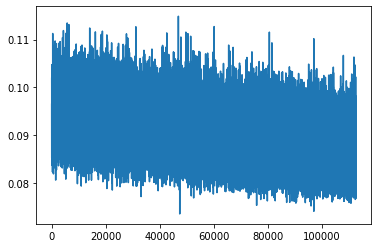

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


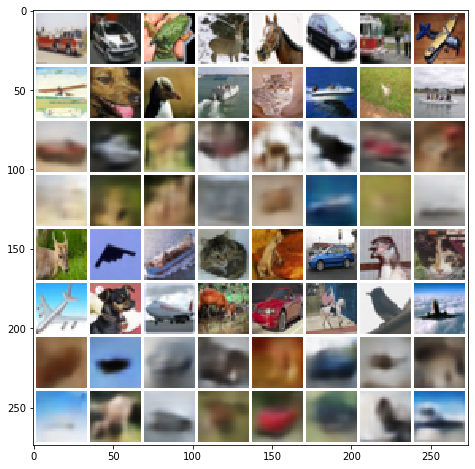

Mean squared dist: 0.046263285
epoch: 73 	 step:0 	 loss: 0.08937
epoch: 73 	 step:100 	 loss: 0.09282
epoch: 73 	 step:200 	 loss: 0.0883
epoch: 73 	 step:300 	 loss: 0.08291
epoch: 73 	 step:400 	 loss: 0.08894
epoch: 73 	 step:500 	 loss: 0.08658
epoch: 73 	 step:600 	 loss: 0.08673
epoch: 73 	 step:700 	 loss: 0.09134
epoch: 73 	 step:800 	 loss: 0.09055
epoch: 73 	 step:900 	 loss: 0.09326
epoch: 73 	 step:1000 	 loss: 0.08957
epoch: 73 	 step:1100 	 loss: 0.08707
epoch: 73 	 step:1200 	 loss: 0.08205
epoch: 73 	 step:1300 	 loss: 0.09035
epoch: 73 	 step:1400 	 loss: 0.08305
epoch: 73 	 step:1500 	 loss: 0.08697


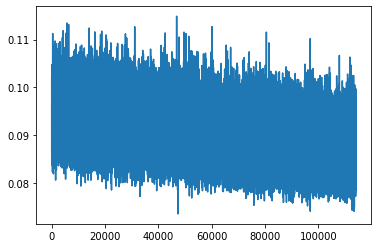

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


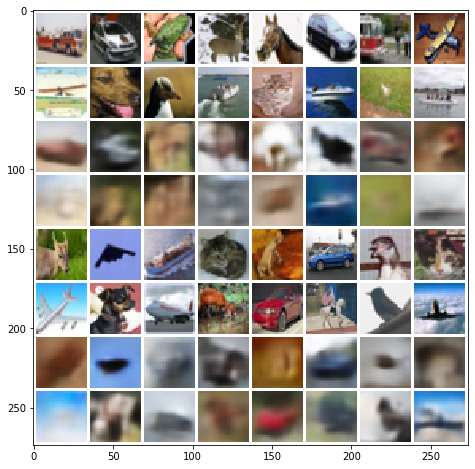

Mean squared dist: 0.046286713
epoch: 74 	 step:0 	 loss: 0.08022
epoch: 74 	 step:100 	 loss: 0.08818
epoch: 74 	 step:200 	 loss: 0.09219
epoch: 74 	 step:300 	 loss: 0.08391
epoch: 74 	 step:400 	 loss: 0.08314
epoch: 74 	 step:500 	 loss: 0.08587
epoch: 74 	 step:600 	 loss: 0.0914
epoch: 74 	 step:700 	 loss: 0.0857
epoch: 74 	 step:800 	 loss: 0.08938
epoch: 74 	 step:900 	 loss: 0.08087
epoch: 74 	 step:1000 	 loss: 0.08694
epoch: 74 	 step:1100 	 loss: 0.08161
epoch: 74 	 step:1200 	 loss: 0.08954
epoch: 74 	 step:1300 	 loss: 0.08359
epoch: 74 	 step:1400 	 loss: 0.09037
epoch: 74 	 step:1500 	 loss: 0.09171


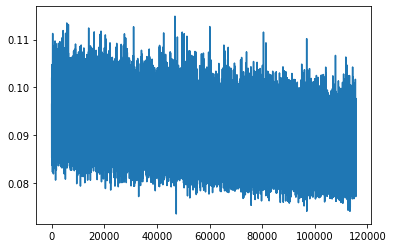

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


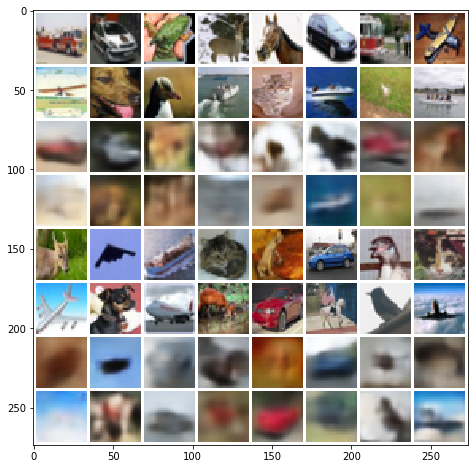

Mean squared dist: 0.04637587
epoch: 75 	 step:0 	 loss: 0.08014
epoch: 75 	 step:100 	 loss: 0.08317
epoch: 75 	 step:200 	 loss: 0.08717
epoch: 75 	 step:300 	 loss: 0.08305
epoch: 75 	 step:400 	 loss: 0.08302
epoch: 75 	 step:500 	 loss: 0.0875
epoch: 75 	 step:600 	 loss: 0.08473
epoch: 75 	 step:700 	 loss: 0.08972
epoch: 75 	 step:800 	 loss: 0.08411
epoch: 75 	 step:900 	 loss: 0.08684
epoch: 75 	 step:1000 	 loss: 0.09141
epoch: 75 	 step:1100 	 loss: 0.08297
epoch: 75 	 step:1200 	 loss: 0.08051
epoch: 75 	 step:1300 	 loss: 0.09477
epoch: 75 	 step:1400 	 loss: 0.09512
epoch: 75 	 step:1500 	 loss: 0.09121


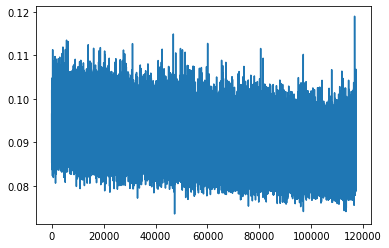

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


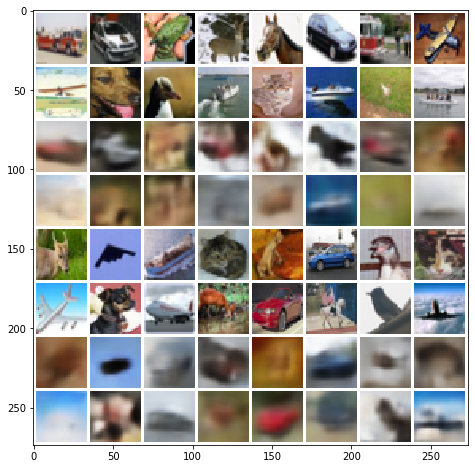

Mean squared dist: 0.046234727
epoch: 76 	 step:0 	 loss: 0.08569
epoch: 76 	 step:100 	 loss: 0.08405
epoch: 76 	 step:200 	 loss: 0.0829
epoch: 76 	 step:300 	 loss: 0.08817
epoch: 76 	 step:400 	 loss: 0.08625
epoch: 76 	 step:500 	 loss: 0.08654
epoch: 76 	 step:600 	 loss: 0.08648
epoch: 76 	 step:700 	 loss: 0.08657
epoch: 76 	 step:800 	 loss: 0.09075
epoch: 76 	 step:900 	 loss: 0.08748
epoch: 76 	 step:1000 	 loss: 0.08364
epoch: 76 	 step:1100 	 loss: 0.08599
epoch: 76 	 step:1200 	 loss: 0.08727
epoch: 76 	 step:1300 	 loss: 0.09
epoch: 76 	 step:1400 	 loss: 0.09039
epoch: 76 	 step:1500 	 loss: 0.08956


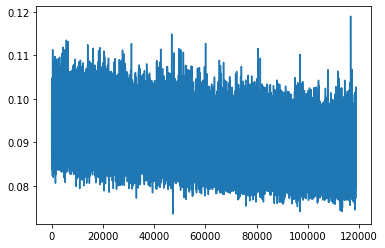

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


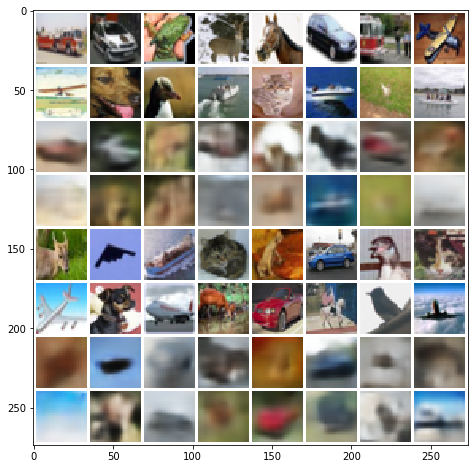

Mean squared dist: 0.04547551
epoch: 77 	 step:0 	 loss: 0.07869
epoch: 77 	 step:100 	 loss: 0.094
epoch: 77 	 step:200 	 loss: 0.08364
epoch: 77 	 step:300 	 loss: 0.08103
epoch: 77 	 step:400 	 loss: 0.0882
epoch: 77 	 step:500 	 loss: 0.08209
epoch: 77 	 step:600 	 loss: 0.08603
epoch: 77 	 step:700 	 loss: 0.08299
epoch: 77 	 step:800 	 loss: 0.09112
epoch: 77 	 step:900 	 loss: 0.08478
epoch: 77 	 step:1000 	 loss: 0.08655
epoch: 77 	 step:1100 	 loss: 0.08827
epoch: 77 	 step:1200 	 loss: 0.08389
epoch: 77 	 step:1300 	 loss: 0.09285
epoch: 77 	 step:1400 	 loss: 0.09128
epoch: 77 	 step:1500 	 loss: 0.08736


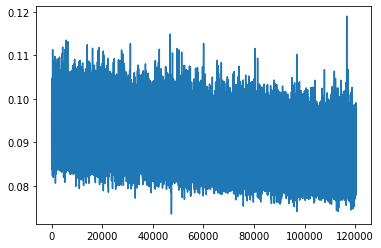

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


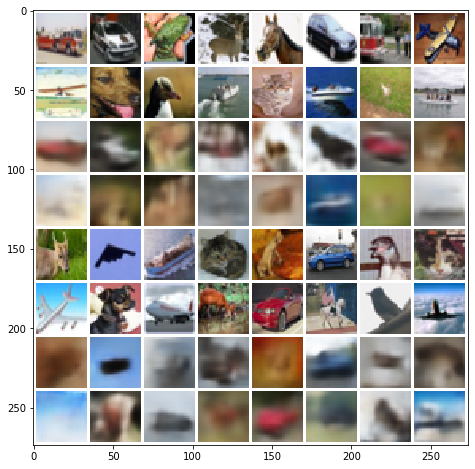

Mean squared dist: 0.04603855
epoch: 78 	 step:0 	 loss: 0.08671
epoch: 78 	 step:100 	 loss: 0.0911
epoch: 78 	 step:200 	 loss: 0.08377
epoch: 78 	 step:300 	 loss: 0.08149
epoch: 78 	 step:400 	 loss: 0.08566
epoch: 78 	 step:500 	 loss: 0.08985
epoch: 78 	 step:600 	 loss: 0.08471
epoch: 78 	 step:700 	 loss: 0.08855
epoch: 78 	 step:800 	 loss: 0.08797
epoch: 78 	 step:900 	 loss: 0.08226
epoch: 78 	 step:1000 	 loss: 0.08796
epoch: 78 	 step:1100 	 loss: 0.08968
epoch: 78 	 step:1200 	 loss: 0.08807
epoch: 78 	 step:1300 	 loss: 0.0805
epoch: 78 	 step:1400 	 loss: 0.08082
epoch: 78 	 step:1500 	 loss: 0.08598


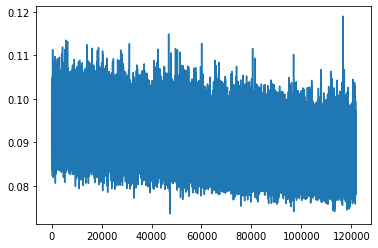

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


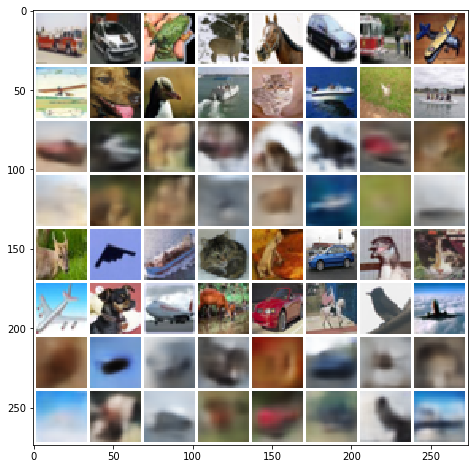

Mean squared dist: 0.045724962
epoch: 79 	 step:0 	 loss: 0.08914
epoch: 79 	 step:100 	 loss: 0.08543
epoch: 79 	 step:200 	 loss: 0.08904
epoch: 79 	 step:300 	 loss: 0.0884
epoch: 79 	 step:400 	 loss: 0.08614
epoch: 79 	 step:500 	 loss: 0.09086
epoch: 79 	 step:600 	 loss: 0.08882
epoch: 79 	 step:700 	 loss: 0.08494
epoch: 79 	 step:800 	 loss: 0.08389
epoch: 79 	 step:900 	 loss: 0.08609
epoch: 79 	 step:1000 	 loss: 0.0856
epoch: 79 	 step:1100 	 loss: 0.08603
epoch: 79 	 step:1200 	 loss: 0.08317
epoch: 79 	 step:1300 	 loss: 0.08966
epoch: 79 	 step:1400 	 loss: 0.08761
epoch: 79 	 step:1500 	 loss: 0.09019


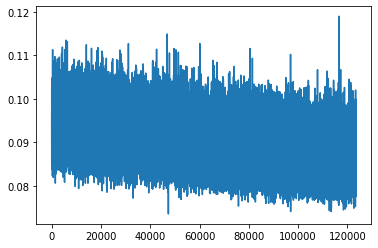

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


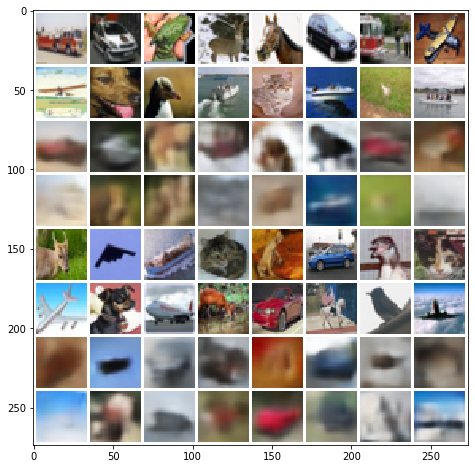

Mean squared dist: 0.045881163
epoch: 80 	 step:0 	 loss: 0.08534
epoch: 80 	 step:100 	 loss: 0.09346
epoch: 80 	 step:200 	 loss: 0.08775
epoch: 80 	 step:300 	 loss: 0.08599
epoch: 80 	 step:400 	 loss: 0.09199
epoch: 80 	 step:500 	 loss: 0.08768
epoch: 80 	 step:600 	 loss: 0.08015
epoch: 80 	 step:700 	 loss: 0.08754
epoch: 80 	 step:800 	 loss: 0.09143
epoch: 80 	 step:900 	 loss: 0.08574
epoch: 80 	 step:1000 	 loss: 0.07911
epoch: 80 	 step:1100 	 loss: 0.08695
epoch: 80 	 step:1200 	 loss: 0.08287
epoch: 80 	 step:1300 	 loss: 0.0894
epoch: 80 	 step:1400 	 loss: 0.08188
epoch: 80 	 step:1500 	 loss: 0.08277


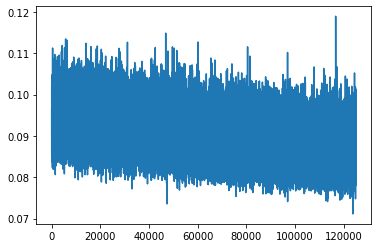

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


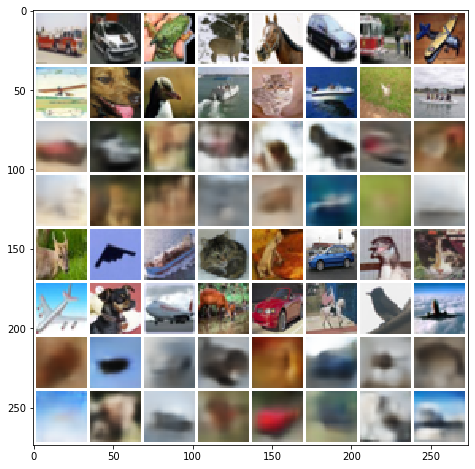

Mean squared dist: 0.046177316
epoch: 81 	 step:0 	 loss: 0.0846
epoch: 81 	 step:100 	 loss: 0.08644
epoch: 81 	 step:200 	 loss: 0.08326
epoch: 81 	 step:300 	 loss: 0.08746
epoch: 81 	 step:400 	 loss: 0.09303
epoch: 81 	 step:500 	 loss: 0.08604
epoch: 81 	 step:600 	 loss: 0.08825
epoch: 81 	 step:700 	 loss: 0.09106
epoch: 81 	 step:800 	 loss: 0.08253
epoch: 81 	 step:900 	 loss: 0.08526
epoch: 81 	 step:1000 	 loss: 0.08357
epoch: 81 	 step:1100 	 loss: 0.09267
epoch: 81 	 step:1200 	 loss: 0.0918
epoch: 81 	 step:1300 	 loss: 0.08379
epoch: 81 	 step:1400 	 loss: 0.09001
epoch: 81 	 step:1500 	 loss: 0.09102


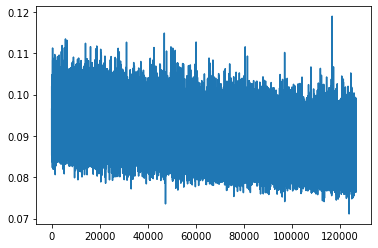

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


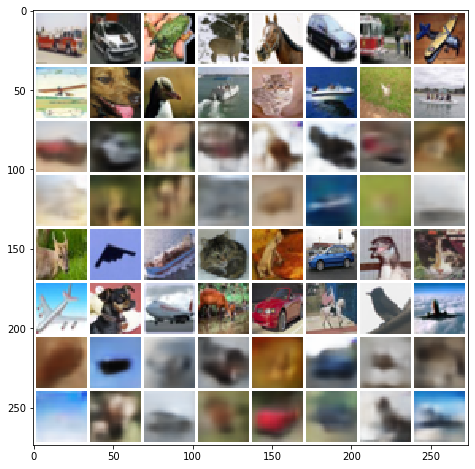

Mean squared dist: 0.04627221
epoch: 82 	 step:0 	 loss: 0.08358
epoch: 82 	 step:100 	 loss: 0.08414
epoch: 82 	 step:200 	 loss: 0.08628
epoch: 82 	 step:300 	 loss: 0.08104
epoch: 82 	 step:400 	 loss: 0.07958
epoch: 82 	 step:500 	 loss: 0.08186
epoch: 82 	 step:600 	 loss: 0.0883
epoch: 82 	 step:700 	 loss: 0.08533
epoch: 82 	 step:800 	 loss: 0.08696
epoch: 82 	 step:900 	 loss: 0.08468
epoch: 82 	 step:1000 	 loss: 0.08803
epoch: 82 	 step:1100 	 loss: 0.0867
epoch: 82 	 step:1200 	 loss: 0.08134
epoch: 82 	 step:1300 	 loss: 0.0873
epoch: 82 	 step:1400 	 loss: 0.08004
epoch: 82 	 step:1500 	 loss: 0.08285


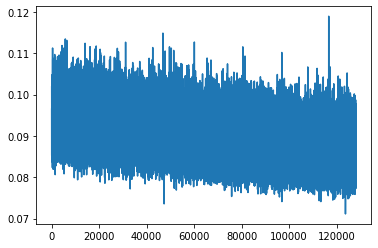

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


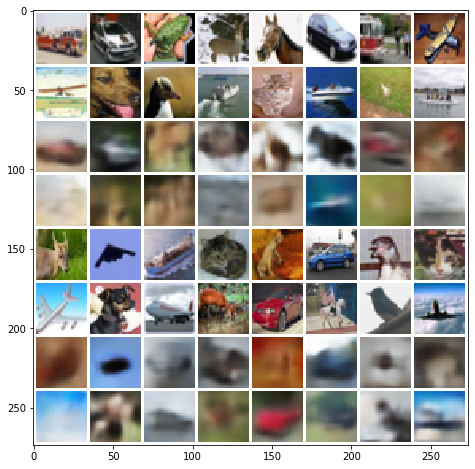

Mean squared dist: 0.04612747
epoch: 83 	 step:0 	 loss: 0.08437
epoch: 83 	 step:100 	 loss: 0.08652
epoch: 83 	 step:200 	 loss: 0.08143
epoch: 83 	 step:300 	 loss: 0.08382
epoch: 83 	 step:400 	 loss: 0.08611
epoch: 83 	 step:500 	 loss: 0.08658
epoch: 83 	 step:600 	 loss: 0.08502
epoch: 83 	 step:700 	 loss: 0.08403
epoch: 83 	 step:800 	 loss: 0.09422
epoch: 83 	 step:900 	 loss: 0.08429
epoch: 83 	 step:1000 	 loss: 0.08466
epoch: 83 	 step:1100 	 loss: 0.09263
epoch: 83 	 step:1200 	 loss: 0.08445
epoch: 83 	 step:1300 	 loss: 0.08074
epoch: 83 	 step:1400 	 loss: 0.08572
epoch: 83 	 step:1500 	 loss: 0.08316


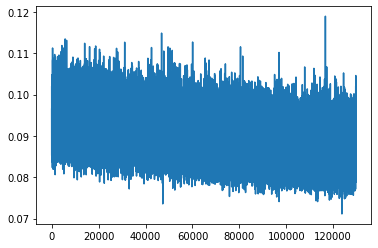

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


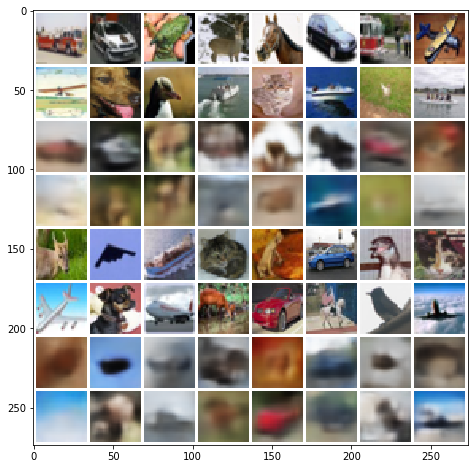

Mean squared dist: 0.045684345
epoch: 84 	 step:0 	 loss: 0.08651
epoch: 84 	 step:100 	 loss: 0.09446
epoch: 84 	 step:200 	 loss: 0.08979
epoch: 84 	 step:300 	 loss: 0.08262
epoch: 84 	 step:400 	 loss: 0.09055
epoch: 84 	 step:500 	 loss: 0.08074
epoch: 84 	 step:600 	 loss: 0.08466
epoch: 84 	 step:700 	 loss: 0.08931
epoch: 84 	 step:800 	 loss: 0.08492
epoch: 84 	 step:900 	 loss: 0.09117
epoch: 84 	 step:1000 	 loss: 0.08533
epoch: 84 	 step:1100 	 loss: 0.08431
epoch: 84 	 step:1200 	 loss: 0.08218
epoch: 84 	 step:1300 	 loss: 0.09149
epoch: 84 	 step:1400 	 loss: 0.08741
epoch: 84 	 step:1500 	 loss: 0.08378


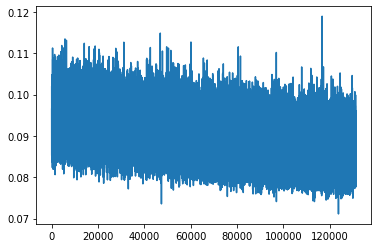

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


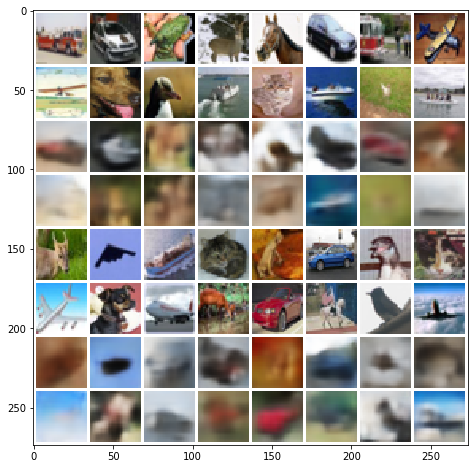

Mean squared dist: 0.04604437
epoch: 85 	 step:0 	 loss: 0.07837
epoch: 85 	 step:100 	 loss: 0.08035
epoch: 85 	 step:200 	 loss: 0.08613
epoch: 85 	 step:300 	 loss: 0.08231
epoch: 85 	 step:400 	 loss: 0.08216
epoch: 85 	 step:500 	 loss: 0.09372
epoch: 85 	 step:600 	 loss: 0.0854
epoch: 85 	 step:700 	 loss: 0.08474
epoch: 85 	 step:800 	 loss: 0.08431
epoch: 85 	 step:900 	 loss: 0.09011
epoch: 85 	 step:1000 	 loss: 0.08736
epoch: 85 	 step:1100 	 loss: 0.08086
epoch: 85 	 step:1200 	 loss: 0.0879
epoch: 85 	 step:1300 	 loss: 0.09537
epoch: 85 	 step:1400 	 loss: 0.08257
epoch: 85 	 step:1500 	 loss: 0.08659


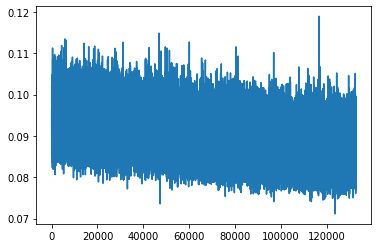

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


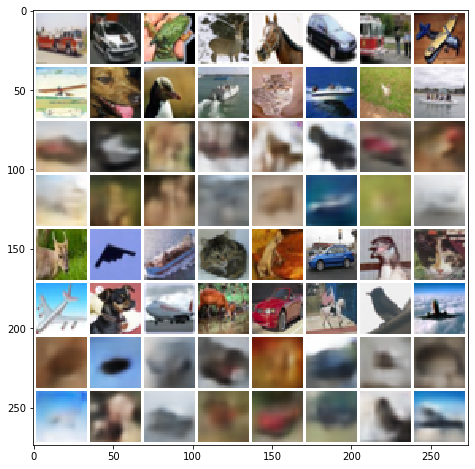

Mean squared dist: 0.045858815
epoch: 86 	 step:0 	 loss: 0.0901
epoch: 86 	 step:100 	 loss: 0.08202
epoch: 86 	 step:200 	 loss: 0.08501
epoch: 86 	 step:300 	 loss: 0.09142
epoch: 86 	 step:400 	 loss: 0.09385
epoch: 86 	 step:500 	 loss: 0.08167
epoch: 86 	 step:600 	 loss: 0.08555
epoch: 86 	 step:700 	 loss: 0.08723
epoch: 86 	 step:800 	 loss: 0.0876
epoch: 86 	 step:900 	 loss: 0.08582
epoch: 86 	 step:1000 	 loss: 0.08652
epoch: 86 	 step:1100 	 loss: 0.08456
epoch: 86 	 step:1200 	 loss: 0.08573
epoch: 86 	 step:1300 	 loss: 0.0835
epoch: 86 	 step:1400 	 loss: 0.09201
epoch: 86 	 step:1500 	 loss: 0.08634


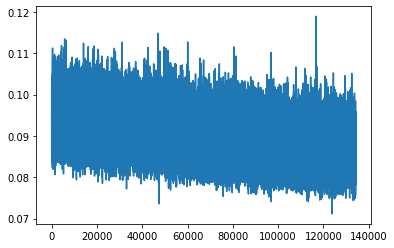

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


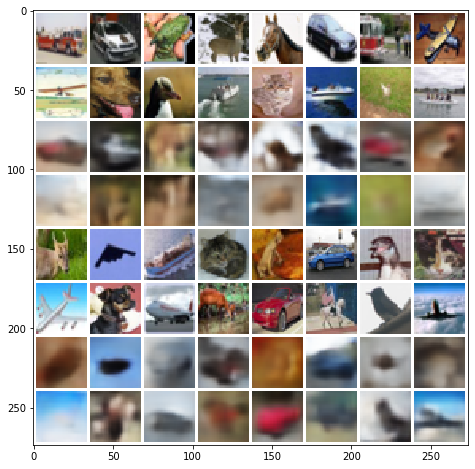

Mean squared dist: 0.04612202
epoch: 87 	 step:0 	 loss: 0.08925
epoch: 87 	 step:100 	 loss: 0.08295
epoch: 87 	 step:200 	 loss: 0.09404
epoch: 87 	 step:300 	 loss: 0.08276
epoch: 87 	 step:400 	 loss: 0.08898
epoch: 87 	 step:500 	 loss: 0.089
epoch: 87 	 step:600 	 loss: 0.08298
epoch: 87 	 step:700 	 loss: 0.08937
epoch: 87 	 step:800 	 loss: 0.08949
epoch: 87 	 step:900 	 loss: 0.08539
epoch: 87 	 step:1000 	 loss: 0.07809
epoch: 87 	 step:1100 	 loss: 0.084
epoch: 87 	 step:1200 	 loss: 0.08277
epoch: 87 	 step:1300 	 loss: 0.08138
epoch: 87 	 step:1400 	 loss: 0.08725
epoch: 87 	 step:1500 	 loss: 0.09188


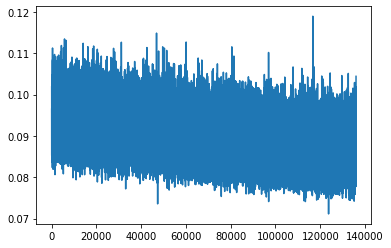

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


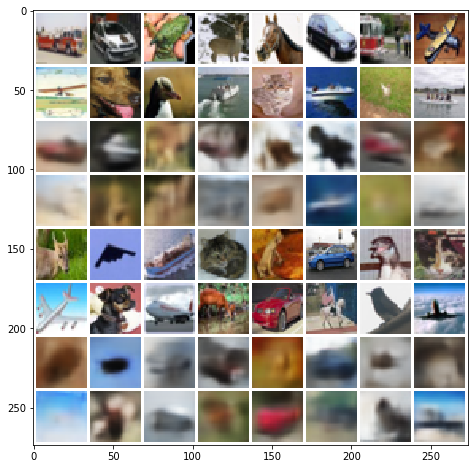

Mean squared dist: 0.046276074
epoch: 88 	 step:0 	 loss: 0.09085
epoch: 88 	 step:100 	 loss: 0.08197
epoch: 88 	 step:200 	 loss: 0.0834
epoch: 88 	 step:300 	 loss: 0.08697
epoch: 88 	 step:400 	 loss: 0.07984
epoch: 88 	 step:500 	 loss: 0.08336
epoch: 88 	 step:600 	 loss: 0.08689
epoch: 88 	 step:700 	 loss: 0.07981
epoch: 88 	 step:800 	 loss: 0.08054
epoch: 88 	 step:900 	 loss: 0.08348
epoch: 88 	 step:1000 	 loss: 0.08375
epoch: 88 	 step:1100 	 loss: 0.08683
epoch: 88 	 step:1200 	 loss: 0.08744
epoch: 88 	 step:1300 	 loss: 0.08894
epoch: 88 	 step:1400 	 loss: 0.08662
epoch: 88 	 step:1500 	 loss: 0.08749


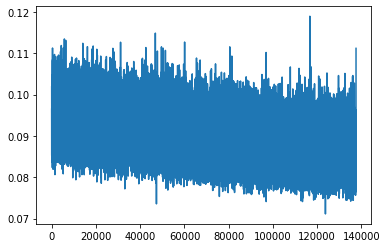

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


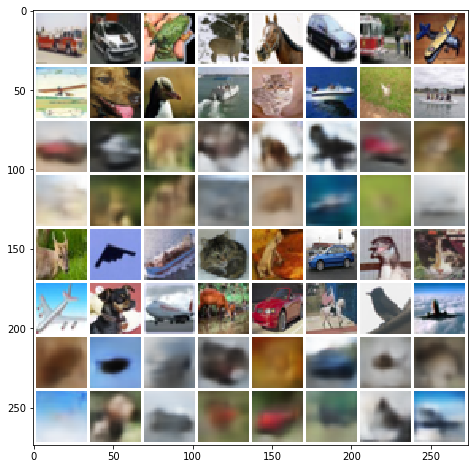

Mean squared dist: 0.045367315
epoch: 89 	 step:0 	 loss: 0.08511
epoch: 89 	 step:100 	 loss: 0.09296
epoch: 89 	 step:200 	 loss: 0.08515
epoch: 89 	 step:300 	 loss: 0.08672
epoch: 89 	 step:400 	 loss: 0.08592
epoch: 89 	 step:500 	 loss: 0.08691
epoch: 89 	 step:600 	 loss: 0.09521
epoch: 89 	 step:700 	 loss: 0.07954
epoch: 89 	 step:800 	 loss: 0.09352
epoch: 89 	 step:900 	 loss: 0.08015
epoch: 89 	 step:1000 	 loss: 0.08398
epoch: 89 	 step:1100 	 loss: 0.08865
epoch: 89 	 step:1200 	 loss: 0.09133
epoch: 89 	 step:1300 	 loss: 0.08479
epoch: 89 	 step:1400 	 loss: 0.08193
epoch: 89 	 step:1500 	 loss: 0.08692


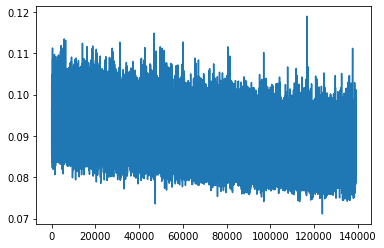

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


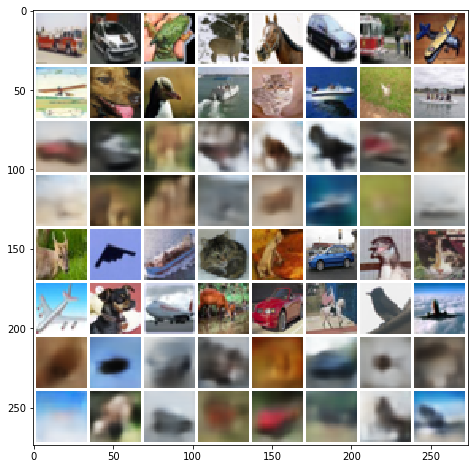

Mean squared dist: 0.04601139
epoch: 90 	 step:0 	 loss: 0.09203
epoch: 90 	 step:100 	 loss: 0.09105
epoch: 90 	 step:200 	 loss: 0.07977
epoch: 90 	 step:300 	 loss: 0.08463
epoch: 90 	 step:400 	 loss: 0.0837
epoch: 90 	 step:500 	 loss: 0.08348
epoch: 90 	 step:600 	 loss: 0.08234
epoch: 90 	 step:700 	 loss: 0.0905
epoch: 90 	 step:800 	 loss: 0.08442
epoch: 90 	 step:900 	 loss: 0.08363
epoch: 90 	 step:1000 	 loss: 0.08085
epoch: 90 	 step:1100 	 loss: 0.08511
epoch: 90 	 step:1200 	 loss: 0.08771
epoch: 90 	 step:1300 	 loss: 0.07787
epoch: 90 	 step:1400 	 loss: 0.08169
epoch: 90 	 step:1500 	 loss: 0.07554


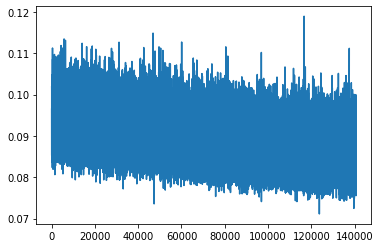

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


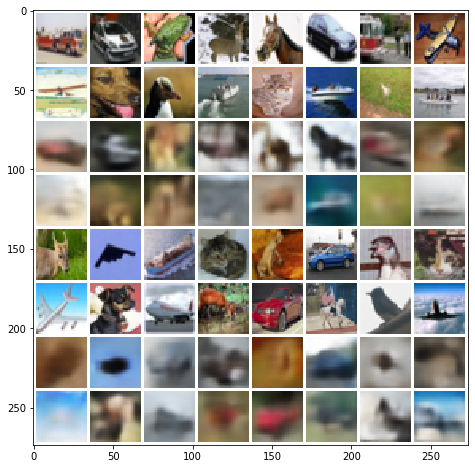

Mean squared dist: 0.04627923
epoch: 91 	 step:0 	 loss: 0.08381
epoch: 91 	 step:100 	 loss: 0.08741
epoch: 91 	 step:200 	 loss: 0.0877
epoch: 91 	 step:300 	 loss: 0.09068
epoch: 91 	 step:400 	 loss: 0.08291
epoch: 91 	 step:500 	 loss: 0.0869
epoch: 91 	 step:600 	 loss: 0.08695
epoch: 91 	 step:700 	 loss: 0.0834
epoch: 91 	 step:800 	 loss: 0.08601
epoch: 91 	 step:900 	 loss: 0.08216
epoch: 91 	 step:1000 	 loss: 0.08382
epoch: 91 	 step:1100 	 loss: 0.08719
epoch: 91 	 step:1200 	 loss: 0.08028
epoch: 91 	 step:1300 	 loss: 0.08236
epoch: 91 	 step:1400 	 loss: 0.08897
epoch: 91 	 step:1500 	 loss: 0.08519


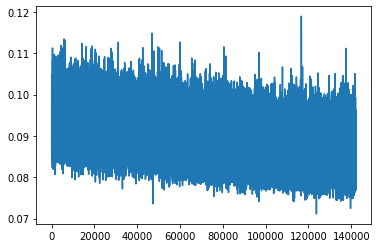

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


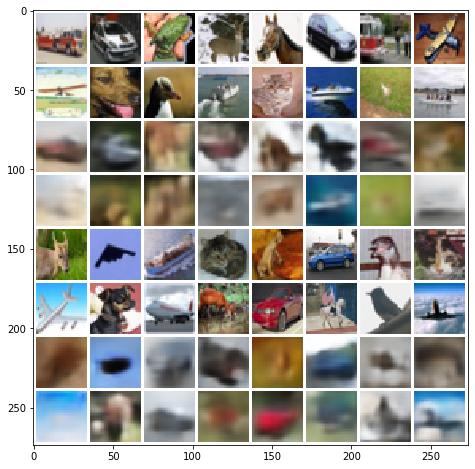

Mean squared dist: 0.045838665
epoch: 92 	 step:0 	 loss: 0.08475
epoch: 92 	 step:100 	 loss: 0.08444
epoch: 92 	 step:200 	 loss: 0.08543
epoch: 92 	 step:300 	 loss: 0.08749
epoch: 92 	 step:400 	 loss: 0.0847
epoch: 92 	 step:500 	 loss: 0.09145
epoch: 92 	 step:600 	 loss: 0.08444
epoch: 92 	 step:700 	 loss: 0.08494
epoch: 92 	 step:800 	 loss: 0.09268
epoch: 92 	 step:900 	 loss: 0.08848
epoch: 92 	 step:1000 	 loss: 0.08182
epoch: 92 	 step:1100 	 loss: 0.09045
epoch: 92 	 step:1200 	 loss: 0.08974
epoch: 92 	 step:1300 	 loss: 0.08423
epoch: 92 	 step:1400 	 loss: 0.08897
epoch: 92 	 step:1500 	 loss: 0.08656


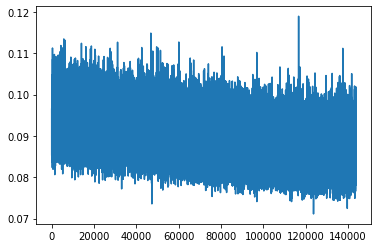

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


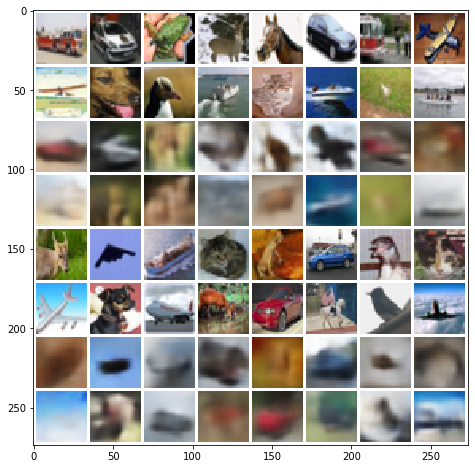

Mean squared dist: 0.045409795
epoch: 93 	 step:0 	 loss: 0.08327
epoch: 93 	 step:100 	 loss: 0.08486
epoch: 93 	 step:200 	 loss: 0.08509
epoch: 93 	 step:300 	 loss: 0.08526
epoch: 93 	 step:400 	 loss: 0.09774
epoch: 93 	 step:500 	 loss: 0.09321
epoch: 93 	 step:600 	 loss: 0.09161
epoch: 93 	 step:700 	 loss: 0.08255
epoch: 93 	 step:800 	 loss: 0.08034
epoch: 93 	 step:900 	 loss: 0.08609
epoch: 93 	 step:1000 	 loss: 0.08613
epoch: 93 	 step:1100 	 loss: 0.08127
epoch: 93 	 step:1200 	 loss: 0.09147
epoch: 93 	 step:1300 	 loss: 0.08172
epoch: 93 	 step:1400 	 loss: 0.08296
epoch: 93 	 step:1500 	 loss: 0.08151


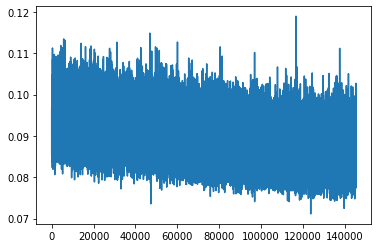

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


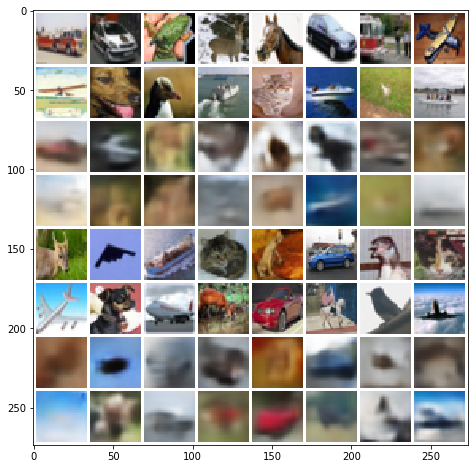

Mean squared dist: 0.045217525
epoch: 94 	 step:0 	 loss: 0.08575
epoch: 94 	 step:100 	 loss: 0.08667
epoch: 94 	 step:200 	 loss: 0.08296
epoch: 94 	 step:300 	 loss: 0.08828
epoch: 94 	 step:400 	 loss: 0.08491
epoch: 94 	 step:500 	 loss: 0.08773
epoch: 94 	 step:600 	 loss: 0.08918
epoch: 94 	 step:700 	 loss: 0.08303
epoch: 94 	 step:800 	 loss: 0.08751
epoch: 94 	 step:900 	 loss: 0.08591
epoch: 94 	 step:1000 	 loss: 0.08659
epoch: 94 	 step:1100 	 loss: 0.08146
epoch: 94 	 step:1200 	 loss: 0.09361
epoch: 94 	 step:1300 	 loss: 0.08923
epoch: 94 	 step:1400 	 loss: 0.08309
epoch: 94 	 step:1500 	 loss: 0.09391


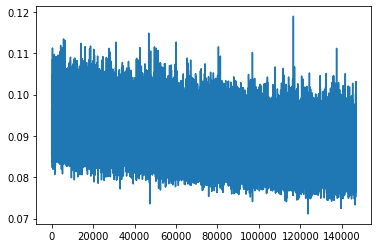

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


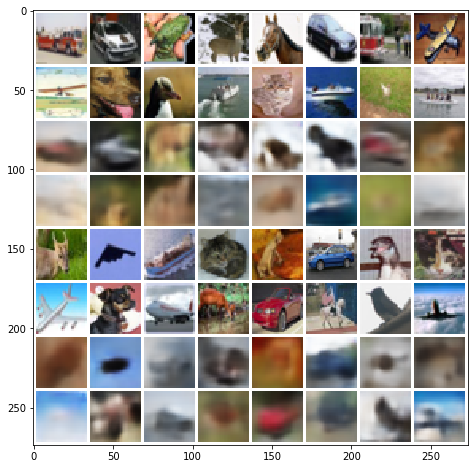

Mean squared dist: 0.04605197
epoch: 95 	 step:0 	 loss: 0.08293
epoch: 95 	 step:100 	 loss: 0.08433
epoch: 95 	 step:200 	 loss: 0.08815
epoch: 95 	 step:300 	 loss: 0.09448
epoch: 95 	 step:400 	 loss: 0.08632
epoch: 95 	 step:500 	 loss: 0.08351
epoch: 95 	 step:600 	 loss: 0.08266
epoch: 95 	 step:700 	 loss: 0.09169
epoch: 95 	 step:800 	 loss: 0.0832
epoch: 95 	 step:900 	 loss: 0.08708
epoch: 95 	 step:1000 	 loss: 0.08231
epoch: 95 	 step:1100 	 loss: 0.08368
epoch: 95 	 step:1200 	 loss: 0.08857
epoch: 95 	 step:1300 	 loss: 0.08562
epoch: 95 	 step:1400 	 loss: 0.08252
epoch: 95 	 step:1500 	 loss: 0.09185


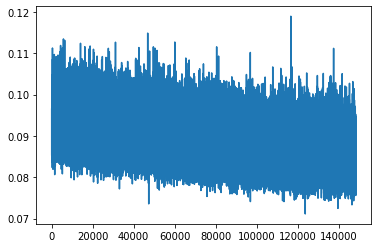

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


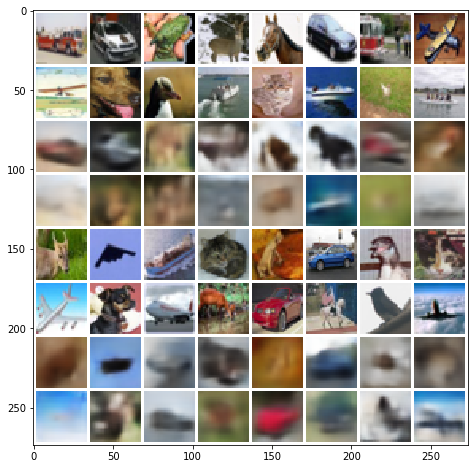

Mean squared dist: 0.0454254
epoch: 96 	 step:0 	 loss: 0.088
epoch: 96 	 step:100 	 loss: 0.08233
epoch: 96 	 step:200 	 loss: 0.0852
epoch: 96 	 step:300 	 loss: 0.08554
epoch: 96 	 step:400 	 loss: 0.08654
epoch: 96 	 step:500 	 loss: 0.08222
epoch: 96 	 step:600 	 loss: 0.08701
epoch: 96 	 step:700 	 loss: 0.07975
epoch: 96 	 step:800 	 loss: 0.08607
epoch: 96 	 step:900 	 loss: 0.09098
epoch: 96 	 step:1000 	 loss: 0.09288
epoch: 96 	 step:1100 	 loss: 0.0931
epoch: 96 	 step:1200 	 loss: 0.08008
epoch: 96 	 step:1300 	 loss: 0.08824
epoch: 96 	 step:1400 	 loss: 0.08376
epoch: 96 	 step:1500 	 loss: 0.08644


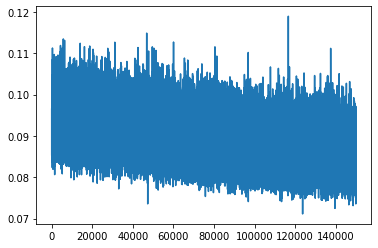

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


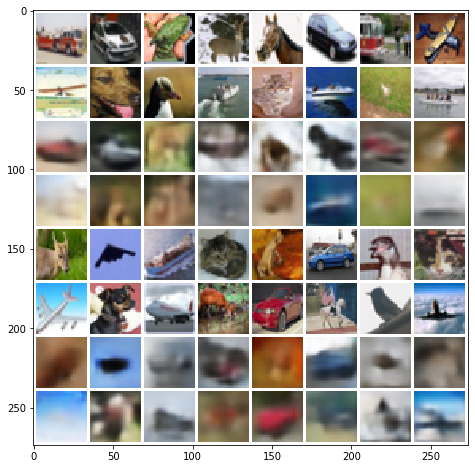

Mean squared dist: 0.046553522
epoch: 97 	 step:0 	 loss: 0.08612
epoch: 97 	 step:100 	 loss: 0.08477
epoch: 97 	 step:200 	 loss: 0.08283
epoch: 97 	 step:300 	 loss: 0.08307
epoch: 97 	 step:400 	 loss: 0.08642
epoch: 97 	 step:500 	 loss: 0.08042
epoch: 97 	 step:600 	 loss: 0.08523
epoch: 97 	 step:700 	 loss: 0.08876
epoch: 97 	 step:800 	 loss: 0.09142
epoch: 97 	 step:900 	 loss: 0.08552
epoch: 97 	 step:1000 	 loss: 0.08476
epoch: 97 	 step:1100 	 loss: 0.09019
epoch: 97 	 step:1200 	 loss: 0.08499
epoch: 97 	 step:1300 	 loss: 0.08123
epoch: 97 	 step:1400 	 loss: 0.08862
epoch: 97 	 step:1500 	 loss: 0.08236


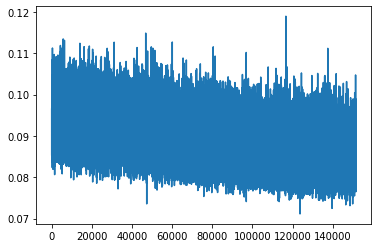

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


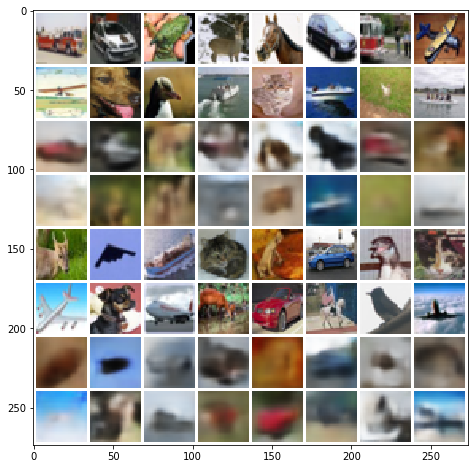

Mean squared dist: 0.045977507
epoch: 98 	 step:0 	 loss: 0.08834
epoch: 98 	 step:100 	 loss: 0.08183
epoch: 98 	 step:200 	 loss: 0.08804
epoch: 98 	 step:300 	 loss: 0.08454
epoch: 98 	 step:400 	 loss: 0.08861
epoch: 98 	 step:500 	 loss: 0.08654
epoch: 98 	 step:600 	 loss: 0.07948
epoch: 98 	 step:700 	 loss: 0.0871
epoch: 98 	 step:800 	 loss: 0.08356
epoch: 98 	 step:900 	 loss: 0.08296
epoch: 98 	 step:1000 	 loss: 0.08064
epoch: 98 	 step:1100 	 loss: 0.08325
epoch: 98 	 step:1200 	 loss: 0.08736
epoch: 98 	 step:1300 	 loss: 0.08807
epoch: 98 	 step:1400 	 loss: 0.0915
epoch: 98 	 step:1500 	 loss: 0.08065


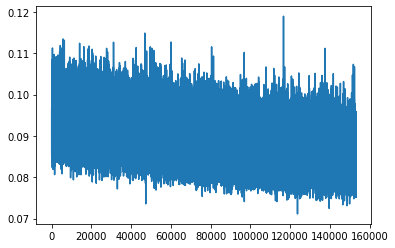

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


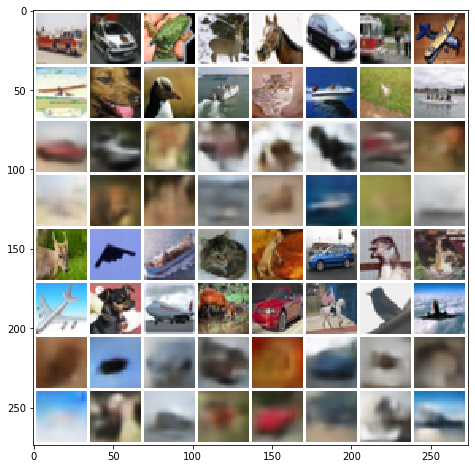

Mean squared dist: 0.045942646
epoch: 99 	 step:0 	 loss: 0.08301
epoch: 99 	 step:100 	 loss: 0.08156
epoch: 99 	 step:200 	 loss: 0.08646
epoch: 99 	 step:300 	 loss: 0.08009
epoch: 99 	 step:400 	 loss: 0.08171
epoch: 99 	 step:500 	 loss: 0.08893
epoch: 99 	 step:600 	 loss: 0.08261
epoch: 99 	 step:700 	 loss: 0.08297
epoch: 99 	 step:800 	 loss: 0.07991
epoch: 99 	 step:900 	 loss: 0.08248
epoch: 99 	 step:1000 	 loss: 0.09654
epoch: 99 	 step:1100 	 loss: 0.08251
epoch: 99 	 step:1200 	 loss: 0.08368
epoch: 99 	 step:1300 	 loss: 0.08909
epoch: 99 	 step:1400 	 loss: 0.08834
epoch: 99 	 step:1500 	 loss: 0.08445


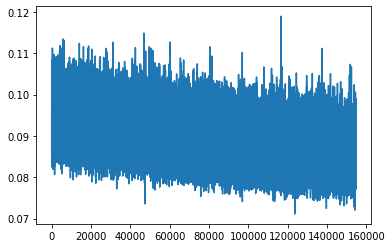

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


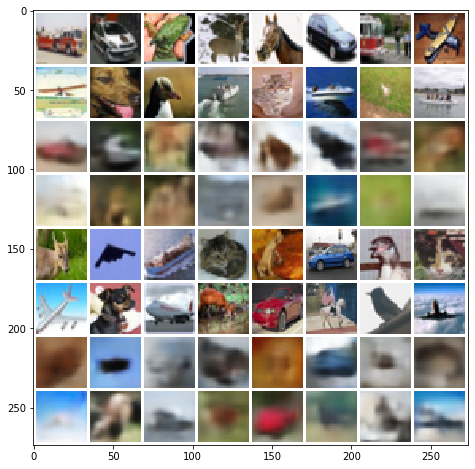

Mean squared dist: 0.046299916
epoch: 100 	 step:0 	 loss: 0.0858
epoch: 100 	 step:100 	 loss: 0.08887
epoch: 100 	 step:200 	 loss: 0.08474
epoch: 100 	 step:300 	 loss: 0.08379
epoch: 100 	 step:400 	 loss: 0.09203
epoch: 100 	 step:500 	 loss: 0.09235
epoch: 100 	 step:600 	 loss: 0.08134
epoch: 100 	 step:700 	 loss: 0.07796
epoch: 100 	 step:800 	 loss: 0.08751
epoch: 100 	 step:900 	 loss: 0.09051
epoch: 100 	 step:1000 	 loss: 0.08358
epoch: 100 	 step:1100 	 loss: 0.08362
epoch: 100 	 step:1200 	 loss: 0.08062
epoch: 100 	 step:1300 	 loss: 0.08364
epoch: 100 	 step:1400 	 loss: 0.08542
epoch: 100 	 step:1500 	 loss: 0.08361


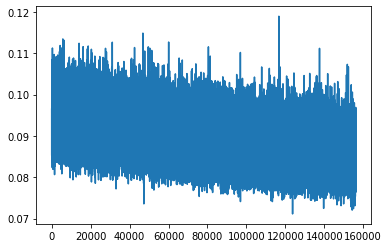

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


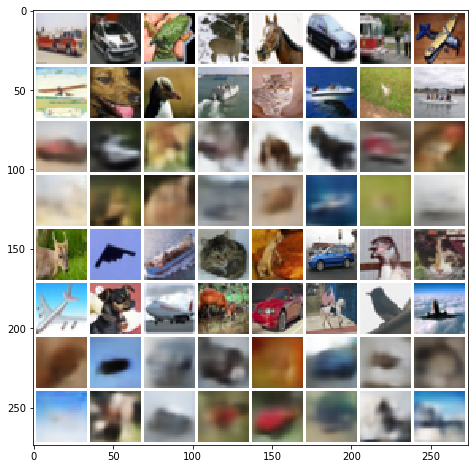

Mean squared dist: 0.046234824
epoch: 101 	 step:0 	 loss: 0.09159
epoch: 101 	 step:100 	 loss: 0.08222
epoch: 101 	 step:200 	 loss: 0.0796
epoch: 101 	 step:300 	 loss: 0.0772
epoch: 101 	 step:400 	 loss: 0.0806
epoch: 101 	 step:500 	 loss: 0.08492
epoch: 101 	 step:600 	 loss: 0.08224
epoch: 101 	 step:700 	 loss: 0.08387
epoch: 101 	 step:800 	 loss: 0.0814
epoch: 101 	 step:900 	 loss: 0.08368
epoch: 101 	 step:1000 	 loss: 0.08548
epoch: 101 	 step:1100 	 loss: 0.0837
epoch: 101 	 step:1200 	 loss: 0.08407
epoch: 101 	 step:1300 	 loss: 0.08288
epoch: 101 	 step:1400 	 loss: 0.08516
epoch: 101 	 step:1500 	 loss: 0.08069


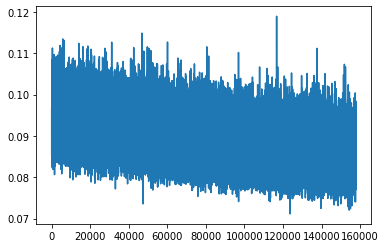

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


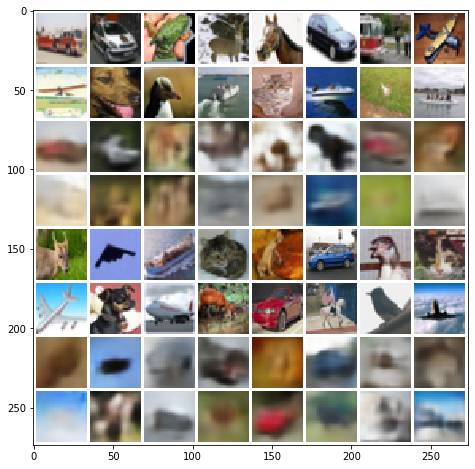

Mean squared dist: 0.045988593
epoch: 102 	 step:0 	 loss: 0.08551
epoch: 102 	 step:100 	 loss: 0.09503
epoch: 102 	 step:200 	 loss: 0.08647
epoch: 102 	 step:300 	 loss: 0.08198
epoch: 102 	 step:400 	 loss: 0.08223
epoch: 102 	 step:500 	 loss: 0.083
epoch: 102 	 step:600 	 loss: 0.09702
epoch: 102 	 step:700 	 loss: 0.08776
epoch: 102 	 step:800 	 loss: 0.07889
epoch: 102 	 step:900 	 loss: 0.08263
epoch: 102 	 step:1000 	 loss: 0.08541
epoch: 102 	 step:1100 	 loss: 0.08574
epoch: 102 	 step:1200 	 loss: 0.08586
epoch: 102 	 step:1300 	 loss: 0.08237
epoch: 102 	 step:1400 	 loss: 0.09366
epoch: 102 	 step:1500 	 loss: 0.08142


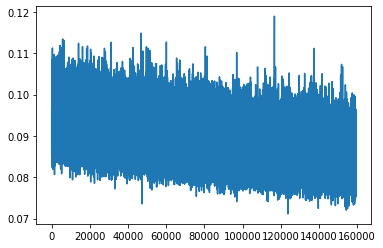

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


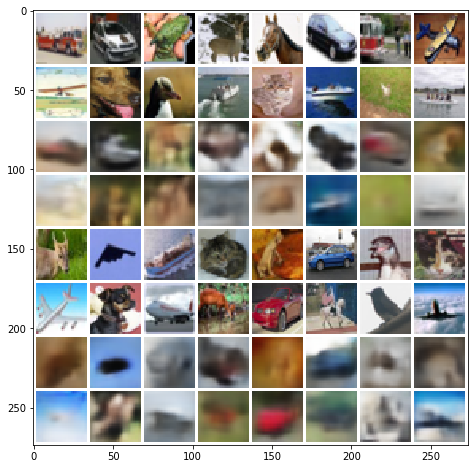

Mean squared dist: 0.046380717
epoch: 103 	 step:0 	 loss: 0.0857
epoch: 103 	 step:100 	 loss: 0.08797
epoch: 103 	 step:200 	 loss: 0.08726
epoch: 103 	 step:300 	 loss: 0.08223
epoch: 103 	 step:400 	 loss: 0.09332
epoch: 103 	 step:500 	 loss: 0.08107
epoch: 103 	 step:600 	 loss: 0.07972
epoch: 103 	 step:700 	 loss: 0.08386
epoch: 103 	 step:800 	 loss: 0.08894
epoch: 103 	 step:900 	 loss: 0.07905
epoch: 103 	 step:1000 	 loss: 0.08473
epoch: 103 	 step:1100 	 loss: 0.09525
epoch: 103 	 step:1200 	 loss: 0.08159
epoch: 103 	 step:1300 	 loss: 0.0818
epoch: 103 	 step:1400 	 loss: 0.09472
epoch: 103 	 step:1500 	 loss: 0.08689


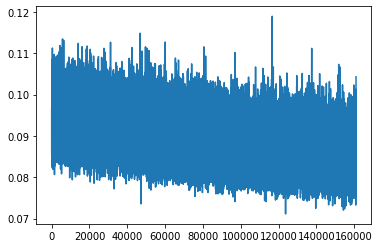

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


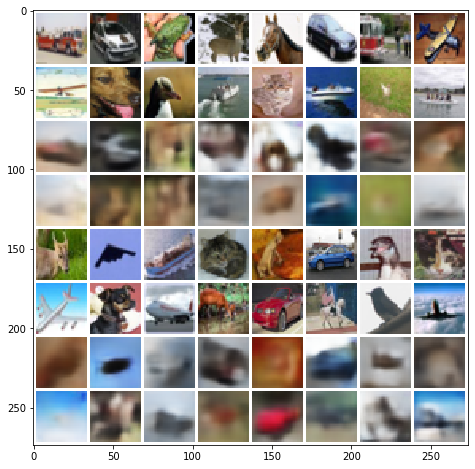

Mean squared dist: 0.04662583
epoch: 104 	 step:0 	 loss: 0.08245
epoch: 104 	 step:100 	 loss: 0.09006
epoch: 104 	 step:200 	 loss: 0.08696
epoch: 104 	 step:300 	 loss: 0.07949
epoch: 104 	 step:400 	 loss: 0.08667
epoch: 104 	 step:500 	 loss: 0.08397
epoch: 104 	 step:600 	 loss: 0.08861
epoch: 104 	 step:700 	 loss: 0.08571
epoch: 104 	 step:800 	 loss: 0.08125
epoch: 104 	 step:900 	 loss: 0.0804
epoch: 104 	 step:1000 	 loss: 0.08907
epoch: 104 	 step:1100 	 loss: 0.08872
epoch: 104 	 step:1200 	 loss: 0.08441
epoch: 104 	 step:1300 	 loss: 0.08065
epoch: 104 	 step:1400 	 loss: 0.08177
epoch: 104 	 step:1500 	 loss: 0.08317


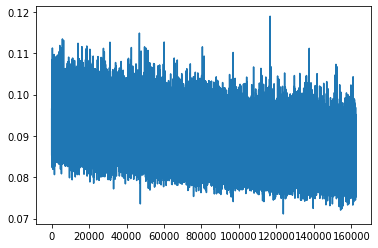

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


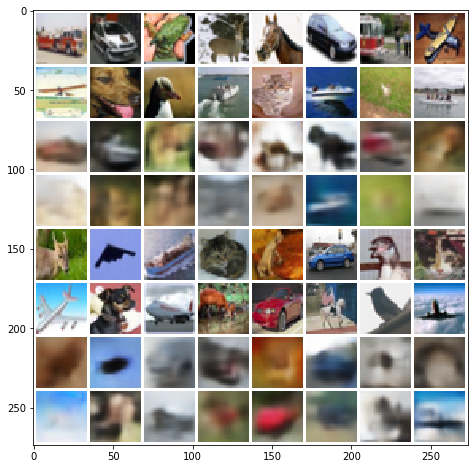

Mean squared dist: 0.04744512
epoch: 105 	 step:0 	 loss: 0.07615
epoch: 105 	 step:100 	 loss: 0.08825
epoch: 105 	 step:200 	 loss: 0.08609
epoch: 105 	 step:300 	 loss: 0.09095
epoch: 105 	 step:400 	 loss: 0.08993
epoch: 105 	 step:500 	 loss: 0.08045
epoch: 105 	 step:600 	 loss: 0.07941
epoch: 105 	 step:700 	 loss: 0.08536
epoch: 105 	 step:800 	 loss: 0.08496
epoch: 105 	 step:900 	 loss: 0.09007
epoch: 105 	 step:1000 	 loss: 0.08513
epoch: 105 	 step:1100 	 loss: 0.07571
epoch: 105 	 step:1200 	 loss: 0.09231
epoch: 105 	 step:1300 	 loss: 0.07952
epoch: 105 	 step:1400 	 loss: 0.08469
epoch: 105 	 step:1500 	 loss: 0.08099


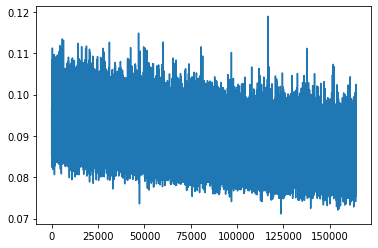

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


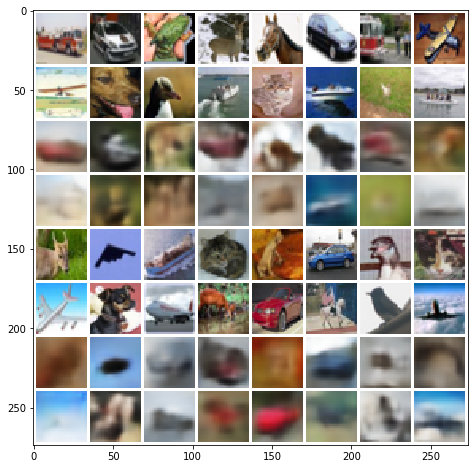

Mean squared dist: 0.04577663
epoch: 106 	 step:0 	 loss: 0.0869
epoch: 106 	 step:100 	 loss: 0.07554
epoch: 106 	 step:200 	 loss: 0.07957
epoch: 106 	 step:300 	 loss: 0.08358
epoch: 106 	 step:400 	 loss: 0.08298
epoch: 106 	 step:500 	 loss: 0.08752
epoch: 106 	 step:600 	 loss: 0.08468
epoch: 106 	 step:700 	 loss: 0.08684
epoch: 106 	 step:800 	 loss: 0.08399
epoch: 106 	 step:900 	 loss: 0.08884
epoch: 106 	 step:1000 	 loss: 0.08707
epoch: 106 	 step:1100 	 loss: 0.08238
epoch: 106 	 step:1200 	 loss: 0.08565
epoch: 106 	 step:1300 	 loss: 0.08177
epoch: 106 	 step:1400 	 loss: 0.08639
epoch: 106 	 step:1500 	 loss: 0.08949


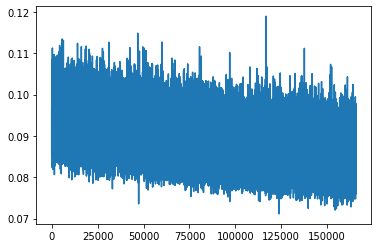

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


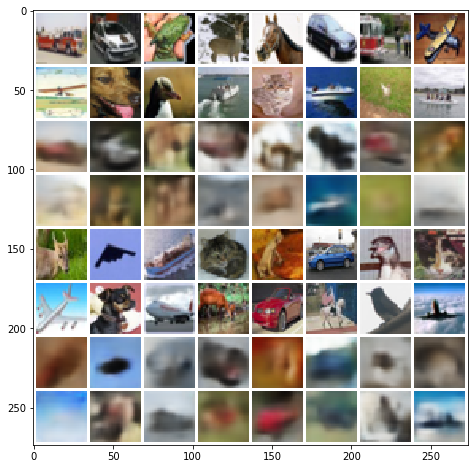

Mean squared dist: 0.04562383
epoch: 107 	 step:0 	 loss: 0.08546
epoch: 107 	 step:100 	 loss: 0.083
epoch: 107 	 step:200 	 loss: 0.07904
epoch: 107 	 step:300 	 loss: 0.08282
epoch: 107 	 step:400 	 loss: 0.08204
epoch: 107 	 step:500 	 loss: 0.0833
epoch: 107 	 step:600 	 loss: 0.08714
epoch: 107 	 step:700 	 loss: 0.08573
epoch: 107 	 step:800 	 loss: 0.08654
epoch: 107 	 step:900 	 loss: 0.08797
epoch: 107 	 step:1000 	 loss: 0.08083
epoch: 107 	 step:1100 	 loss: 0.08432
epoch: 107 	 step:1200 	 loss: 0.08223
epoch: 107 	 step:1300 	 loss: 0.08039
epoch: 107 	 step:1400 	 loss: 0.08928
epoch: 107 	 step:1500 	 loss: 0.08658


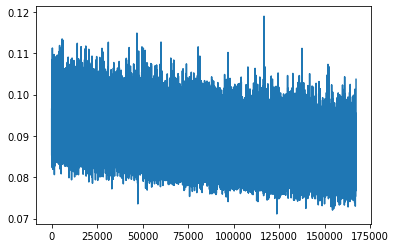

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


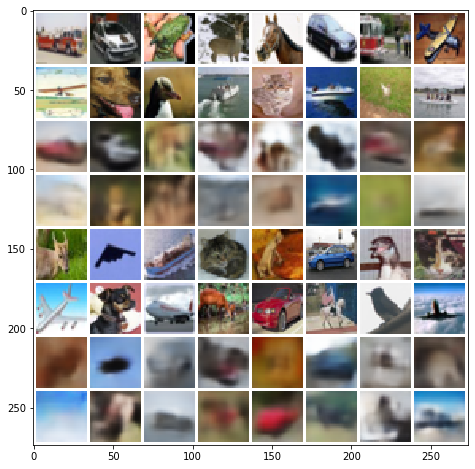

Mean squared dist: 0.046204977
epoch: 108 	 step:0 	 loss: 0.08709
epoch: 108 	 step:100 	 loss: 0.08349
epoch: 108 	 step:200 	 loss: 0.09021
epoch: 108 	 step:300 	 loss: 0.07954
epoch: 108 	 step:400 	 loss: 0.08205
epoch: 108 	 step:500 	 loss: 0.08025
epoch: 108 	 step:600 	 loss: 0.07623
epoch: 108 	 step:700 	 loss: 0.093
epoch: 108 	 step:800 	 loss: 0.08714
epoch: 108 	 step:900 	 loss: 0.08801
epoch: 108 	 step:1000 	 loss: 0.08191
epoch: 108 	 step:1100 	 loss: 0.07822
epoch: 108 	 step:1200 	 loss: 0.08658
epoch: 108 	 step:1300 	 loss: 0.09021
epoch: 108 	 step:1400 	 loss: 0.08614
epoch: 108 	 step:1500 	 loss: 0.08913


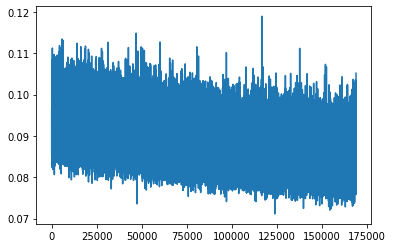

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


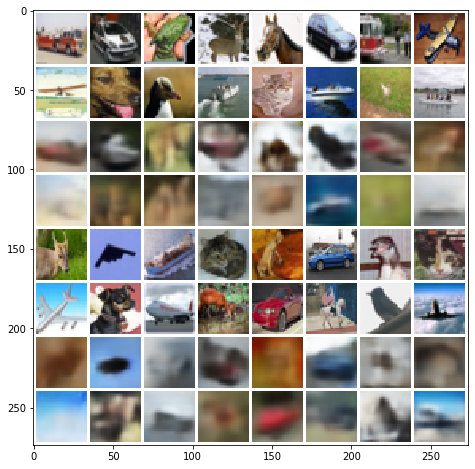

Mean squared dist: 0.0461527
epoch: 109 	 step:0 	 loss: 0.07772
epoch: 109 	 step:100 	 loss: 0.09652
epoch: 109 	 step:200 	 loss: 0.0905
epoch: 109 	 step:300 	 loss: 0.0812
epoch: 109 	 step:400 	 loss: 0.08799
epoch: 109 	 step:500 	 loss: 0.0796
epoch: 109 	 step:600 	 loss: 0.08552
epoch: 109 	 step:700 	 loss: 0.07766
epoch: 109 	 step:800 	 loss: 0.08234
epoch: 109 	 step:900 	 loss: 0.08422
epoch: 109 	 step:1000 	 loss: 0.08522
epoch: 109 	 step:1100 	 loss: 0.07936
epoch: 109 	 step:1200 	 loss: 0.08714
epoch: 109 	 step:1300 	 loss: 0.08936
epoch: 109 	 step:1400 	 loss: 0.08361
epoch: 109 	 step:1500 	 loss: 0.08427


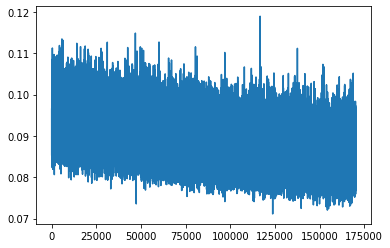

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


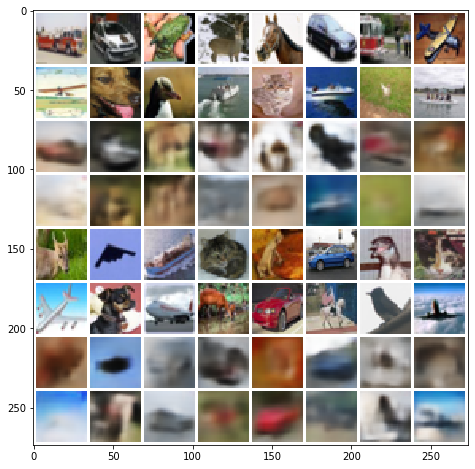

Mean squared dist: 0.046341654
epoch: 110 	 step:0 	 loss: 0.08292
epoch: 110 	 step:100 	 loss: 0.09013
epoch: 110 	 step:200 	 loss: 0.08807
epoch: 110 	 step:300 	 loss: 0.0849
epoch: 110 	 step:400 	 loss: 0.08449
epoch: 110 	 step:500 	 loss: 0.08342
epoch: 110 	 step:600 	 loss: 0.08303
epoch: 110 	 step:700 	 loss: 0.08344
epoch: 110 	 step:800 	 loss: 0.08021
epoch: 110 	 step:900 	 loss: 0.08677
epoch: 110 	 step:1000 	 loss: 0.08477
epoch: 110 	 step:1100 	 loss: 0.08285
epoch: 110 	 step:1200 	 loss: 0.07978
epoch: 110 	 step:1300 	 loss: 0.08274
epoch: 110 	 step:1400 	 loss: 0.08323
epoch: 110 	 step:1500 	 loss: 0.08119


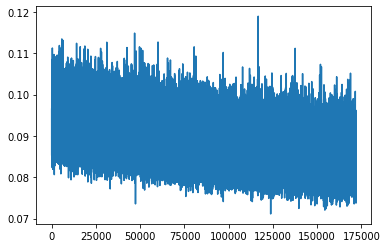

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


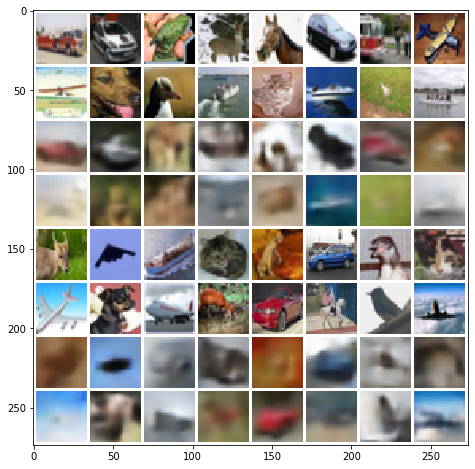

Mean squared dist: 0.045846693
epoch: 111 	 step:0 	 loss: 0.09098
epoch: 111 	 step:100 	 loss: 0.0825
epoch: 111 	 step:200 	 loss: 0.08567
epoch: 111 	 step:300 	 loss: 0.09116
epoch: 111 	 step:400 	 loss: 0.08681
epoch: 111 	 step:500 	 loss: 0.08105
epoch: 111 	 step:600 	 loss: 0.07969
epoch: 111 	 step:700 	 loss: 0.07648
epoch: 111 	 step:800 	 loss: 0.08183
epoch: 111 	 step:900 	 loss: 0.08662
epoch: 111 	 step:1000 	 loss: 0.07848
epoch: 111 	 step:1100 	 loss: 0.08998
epoch: 111 	 step:1200 	 loss: 0.08662
epoch: 111 	 step:1300 	 loss: 0.08419
epoch: 111 	 step:1400 	 loss: 0.08629
epoch: 111 	 step:1500 	 loss: 0.08506


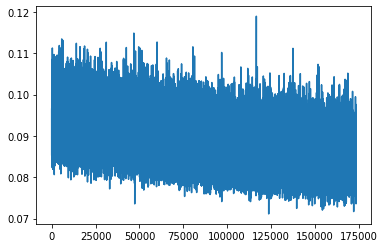

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


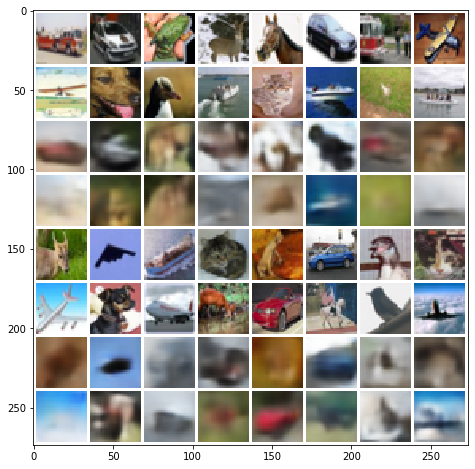

Mean squared dist: 0.0459606
epoch: 112 	 step:0 	 loss: 0.08025
epoch: 112 	 step:100 	 loss: 0.08027
epoch: 112 	 step:200 	 loss: 0.0867
epoch: 112 	 step:300 	 loss: 0.08486
epoch: 112 	 step:400 	 loss: 0.08144
epoch: 112 	 step:500 	 loss: 0.08336
epoch: 112 	 step:600 	 loss: 0.08558
epoch: 112 	 step:700 	 loss: 0.08421
epoch: 112 	 step:800 	 loss: 0.0827
epoch: 112 	 step:900 	 loss: 0.09699
epoch: 112 	 step:1000 	 loss: 0.08521
epoch: 112 	 step:1100 	 loss: 0.09252
epoch: 112 	 step:1200 	 loss: 0.08211
epoch: 112 	 step:1300 	 loss: 0.08141
epoch: 112 	 step:1400 	 loss: 0.08816
epoch: 112 	 step:1500 	 loss: 0.0828


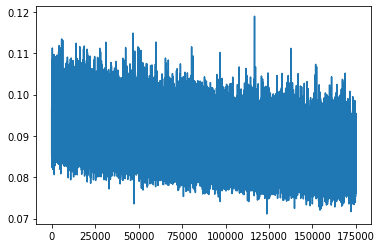

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


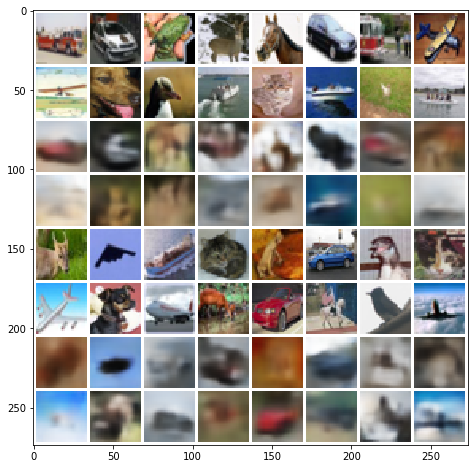

Mean squared dist: 0.046439677
epoch: 113 	 step:0 	 loss: 0.08659
epoch: 113 	 step:100 	 loss: 0.0814
epoch: 113 	 step:200 	 loss: 0.08442
epoch: 113 	 step:300 	 loss: 0.08611
epoch: 113 	 step:400 	 loss: 0.08507
epoch: 113 	 step:500 	 loss: 0.08792
epoch: 113 	 step:600 	 loss: 0.0826
epoch: 113 	 step:700 	 loss: 0.0857
epoch: 113 	 step:800 	 loss: 0.08166
epoch: 113 	 step:900 	 loss: 0.08411
epoch: 113 	 step:1000 	 loss: 0.08579
epoch: 113 	 step:1100 	 loss: 0.08602
epoch: 113 	 step:1200 	 loss: 0.07988
epoch: 113 	 step:1300 	 loss: 0.08527
epoch: 113 	 step:1400 	 loss: 0.08141
epoch: 113 	 step:1500 	 loss: 0.0848


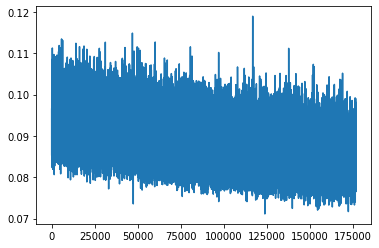

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


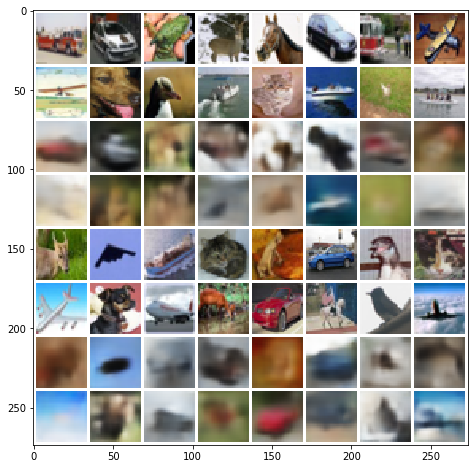

Mean squared dist: 0.04587775
epoch: 114 	 step:0 	 loss: 0.08299
epoch: 114 	 step:100 	 loss: 0.08472
epoch: 114 	 step:200 	 loss: 0.08074
epoch: 114 	 step:300 	 loss: 0.08212
epoch: 114 	 step:400 	 loss: 0.09127
epoch: 114 	 step:500 	 loss: 0.08202
epoch: 114 	 step:600 	 loss: 0.08713
epoch: 114 	 step:700 	 loss: 0.08645
epoch: 114 	 step:800 	 loss: 0.08862
epoch: 114 	 step:900 	 loss: 0.08574
epoch: 114 	 step:1000 	 loss: 0.07844
epoch: 114 	 step:1100 	 loss: 0.08473
epoch: 114 	 step:1200 	 loss: 0.09216
epoch: 114 	 step:1300 	 loss: 0.08383
epoch: 114 	 step:1400 	 loss: 0.09218
epoch: 114 	 step:1500 	 loss: 0.08992


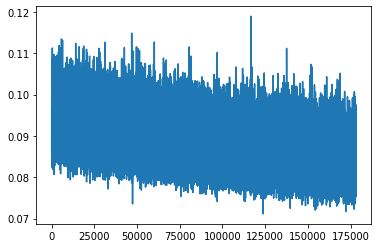

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


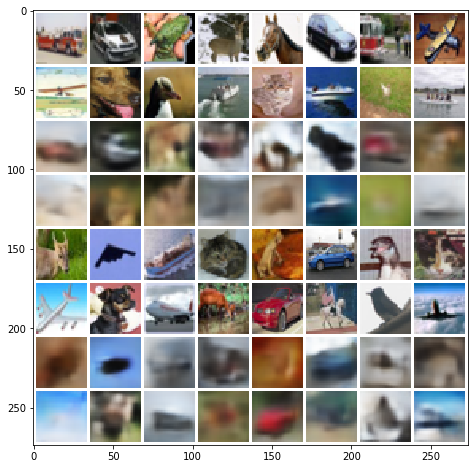

Mean squared dist: 0.046550184
epoch: 115 	 step:0 	 loss: 0.08077
epoch: 115 	 step:100 	 loss: 0.08491
epoch: 115 	 step:200 	 loss: 0.08436
epoch: 115 	 step:300 	 loss: 0.08449
epoch: 115 	 step:400 	 loss: 0.07658
epoch: 115 	 step:500 	 loss: 0.08405
epoch: 115 	 step:600 	 loss: 0.087
epoch: 115 	 step:700 	 loss: 0.08678
epoch: 115 	 step:800 	 loss: 0.09426
epoch: 115 	 step:900 	 loss: 0.08468
epoch: 115 	 step:1000 	 loss: 0.08633
epoch: 115 	 step:1100 	 loss: 0.08391
epoch: 115 	 step:1200 	 loss: 0.09
epoch: 115 	 step:1300 	 loss: 0.07945
epoch: 115 	 step:1400 	 loss: 0.08252
epoch: 115 	 step:1500 	 loss: 0.08435


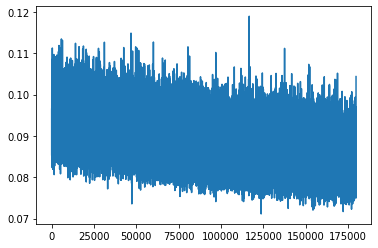

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


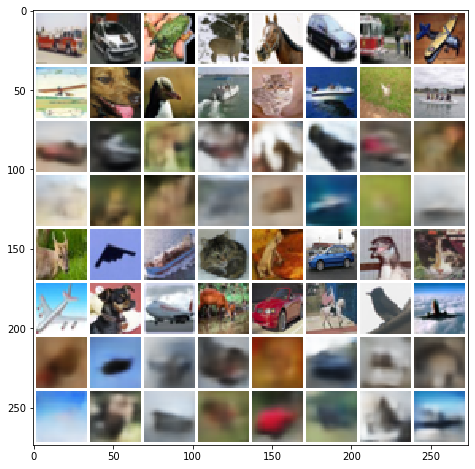

Mean squared dist: 0.046252675
epoch: 116 	 step:0 	 loss: 0.07989
epoch: 116 	 step:100 	 loss: 0.08988
epoch: 116 	 step:200 	 loss: 0.08543
epoch: 116 	 step:300 	 loss: 0.08188
epoch: 116 	 step:400 	 loss: 0.08597
epoch: 116 	 step:500 	 loss: 0.08468
epoch: 116 	 step:600 	 loss: 0.08263
epoch: 116 	 step:700 	 loss: 0.09289
epoch: 116 	 step:800 	 loss: 0.09083
epoch: 116 	 step:900 	 loss: 0.0866
epoch: 116 	 step:1000 	 loss: 0.0897
epoch: 116 	 step:1100 	 loss: 0.08689
epoch: 116 	 step:1200 	 loss: 0.08795
epoch: 116 	 step:1300 	 loss: 0.07754
epoch: 116 	 step:1400 	 loss: 0.07947
epoch: 116 	 step:1500 	 loss: 0.08515


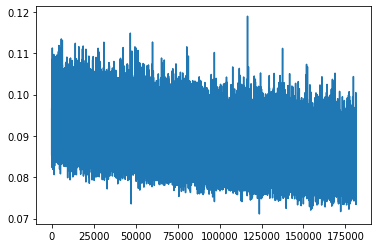

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


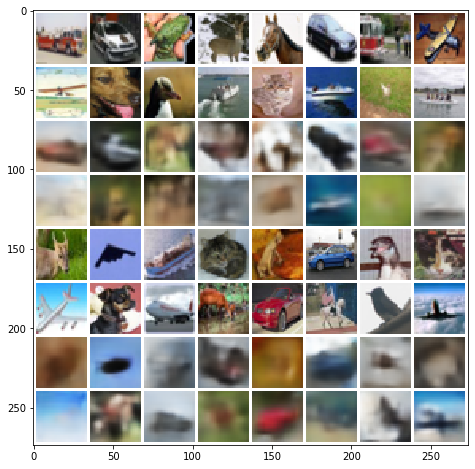

Mean squared dist: 0.046029553
epoch: 117 	 step:0 	 loss: 0.08078
epoch: 117 	 step:100 	 loss: 0.08854
epoch: 117 	 step:200 	 loss: 0.09131
epoch: 117 	 step:300 	 loss: 0.08698
epoch: 117 	 step:400 	 loss: 0.07823
epoch: 117 	 step:500 	 loss: 0.08252
epoch: 117 	 step:600 	 loss: 0.08407
epoch: 117 	 step:700 	 loss: 0.08513
epoch: 117 	 step:800 	 loss: 0.08441
epoch: 117 	 step:900 	 loss: 0.09199
epoch: 117 	 step:1000 	 loss: 0.08401
epoch: 117 	 step:1100 	 loss: 0.08322
epoch: 117 	 step:1200 	 loss: 0.08734
epoch: 117 	 step:1300 	 loss: 0.08719
epoch: 117 	 step:1400 	 loss: 0.0863
epoch: 117 	 step:1500 	 loss: 0.08405


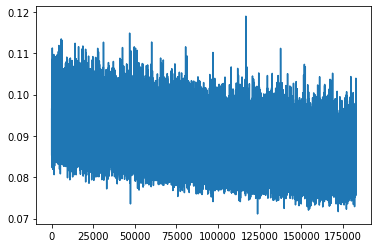

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


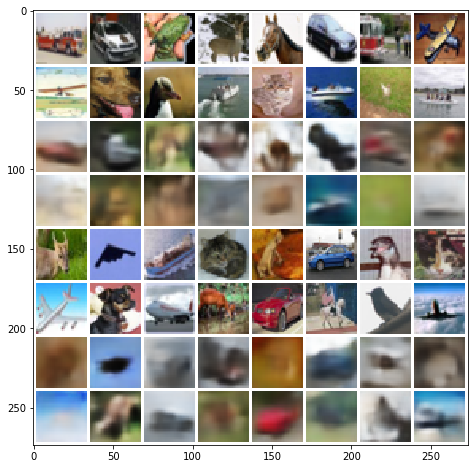

Mean squared dist: 0.045692377
epoch: 118 	 step:0 	 loss: 0.09127
epoch: 118 	 step:100 	 loss: 0.08261
epoch: 118 	 step:200 	 loss: 0.08011
epoch: 118 	 step:300 	 loss: 0.08598
epoch: 118 	 step:400 	 loss: 0.08888
epoch: 118 	 step:500 	 loss: 0.07961
epoch: 118 	 step:600 	 loss: 0.08441
epoch: 118 	 step:700 	 loss: 0.07749
epoch: 118 	 step:800 	 loss: 0.09178
epoch: 118 	 step:900 	 loss: 0.08907
epoch: 118 	 step:1000 	 loss: 0.08238
epoch: 118 	 step:1100 	 loss: 0.08052
epoch: 118 	 step:1200 	 loss: 0.08433
epoch: 118 	 step:1300 	 loss: 0.08174
epoch: 118 	 step:1400 	 loss: 0.09166
epoch: 118 	 step:1500 	 loss: 0.09304


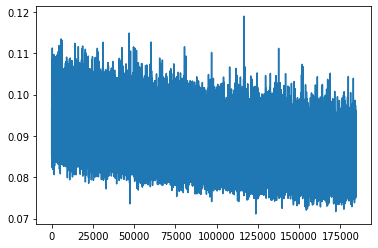

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


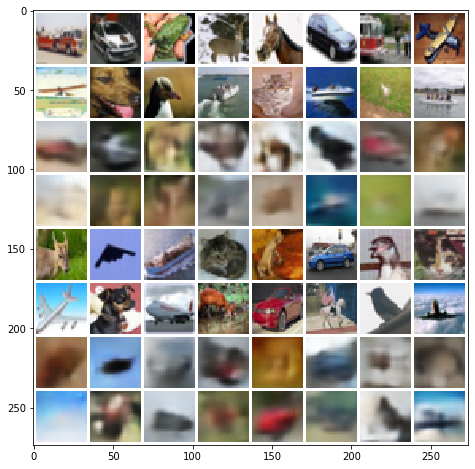

Mean squared dist: 0.045744482
epoch: 119 	 step:0 	 loss: 0.07997
epoch: 119 	 step:100 	 loss: 0.08344
epoch: 119 	 step:200 	 loss: 0.08547
epoch: 119 	 step:300 	 loss: 0.08037
epoch: 119 	 step:400 	 loss: 0.08545
epoch: 119 	 step:500 	 loss: 0.08531
epoch: 119 	 step:600 	 loss: 0.08652
epoch: 119 	 step:700 	 loss: 0.08025
epoch: 119 	 step:800 	 loss: 0.08307
epoch: 119 	 step:900 	 loss: 0.08269
epoch: 119 	 step:1000 	 loss: 0.0821
epoch: 119 	 step:1100 	 loss: 0.08723
epoch: 119 	 step:1200 	 loss: 0.08535
epoch: 119 	 step:1300 	 loss: 0.08877
epoch: 119 	 step:1400 	 loss: 0.0883
epoch: 119 	 step:1500 	 loss: 0.0888


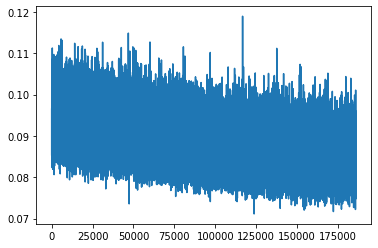

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


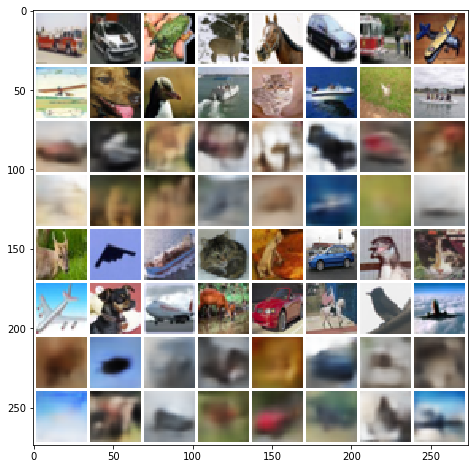

Mean squared dist: 0.046051536
epoch: 120 	 step:0 	 loss: 0.07974
epoch: 120 	 step:100 	 loss: 0.07925
epoch: 120 	 step:200 	 loss: 0.08165
epoch: 120 	 step:300 	 loss: 0.08795
epoch: 120 	 step:400 	 loss: 0.08342
epoch: 120 	 step:500 	 loss: 0.08304
epoch: 120 	 step:600 	 loss: 0.08731
epoch: 120 	 step:700 	 loss: 0.08527
epoch: 120 	 step:800 	 loss: 0.07936
epoch: 120 	 step:900 	 loss: 0.08639
epoch: 120 	 step:1000 	 loss: 0.08713
epoch: 120 	 step:1100 	 loss: 0.08225
epoch: 120 	 step:1200 	 loss: 0.08429
epoch: 120 	 step:1300 	 loss: 0.08282
epoch: 120 	 step:1400 	 loss: 0.08506
epoch: 120 	 step:1500 	 loss: 0.0887


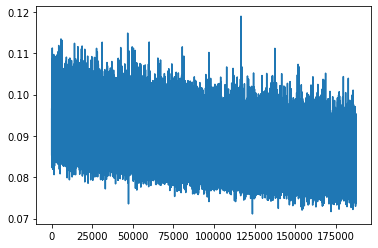

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


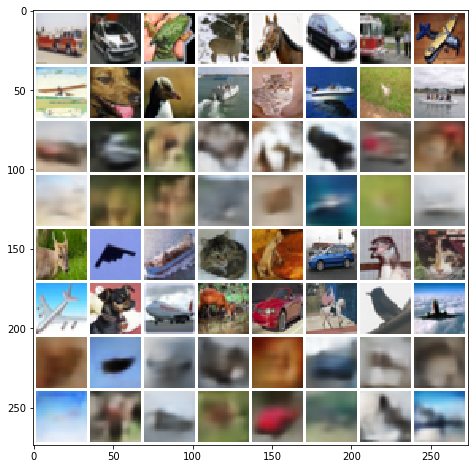

Mean squared dist: 0.045609124
epoch: 121 	 step:0 	 loss: 0.08348
epoch: 121 	 step:100 	 loss: 0.08777
epoch: 121 	 step:200 	 loss: 0.08846
epoch: 121 	 step:300 	 loss: 0.07955
epoch: 121 	 step:400 	 loss: 0.08626
epoch: 121 	 step:500 	 loss: 0.08204
epoch: 121 	 step:600 	 loss: 0.08778
epoch: 121 	 step:700 	 loss: 0.07702
epoch: 121 	 step:800 	 loss: 0.08134
epoch: 121 	 step:900 	 loss: 0.08373
epoch: 121 	 step:1000 	 loss: 0.086
epoch: 121 	 step:1100 	 loss: 0.08546
epoch: 121 	 step:1200 	 loss: 0.08257
epoch: 121 	 step:1300 	 loss: 0.08656
epoch: 121 	 step:1400 	 loss: 0.09441
epoch: 121 	 step:1500 	 loss: 0.08123


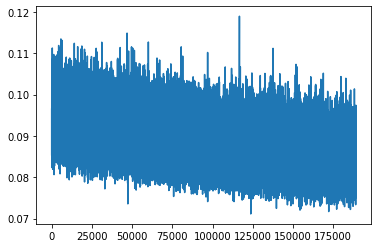

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


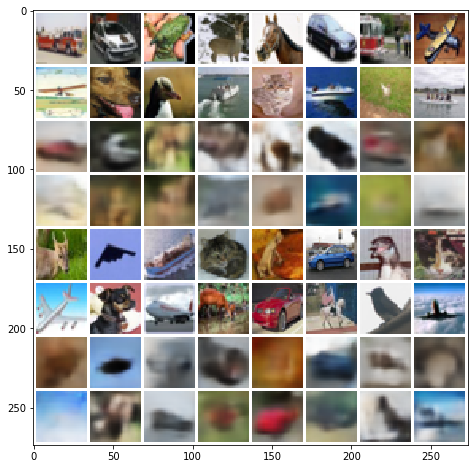

Mean squared dist: 0.046124827
epoch: 122 	 step:0 	 loss: 0.08245
epoch: 122 	 step:100 	 loss: 0.08814
epoch: 122 	 step:200 	 loss: 0.07881
epoch: 122 	 step:300 	 loss: 0.08397
epoch: 122 	 step:400 	 loss: 0.08177
epoch: 122 	 step:500 	 loss: 0.07758
epoch: 122 	 step:600 	 loss: 0.08056
epoch: 122 	 step:700 	 loss: 0.08428
epoch: 122 	 step:800 	 loss: 0.08369
epoch: 122 	 step:900 	 loss: 0.08703
epoch: 122 	 step:1000 	 loss: 0.08524
epoch: 122 	 step:1100 	 loss: 0.09197
epoch: 122 	 step:1200 	 loss: 0.08094
epoch: 122 	 step:1300 	 loss: 0.08378
epoch: 122 	 step:1400 	 loss: 0.08383
epoch: 122 	 step:1500 	 loss: 0.0876


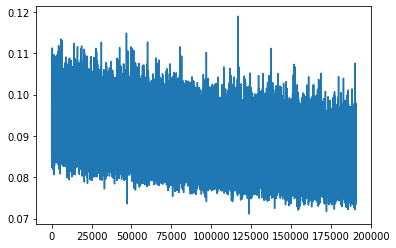

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


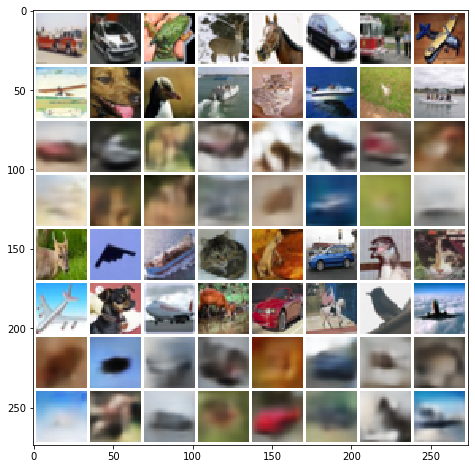

Mean squared dist: 0.045486055
epoch: 123 	 step:0 	 loss: 0.07982
epoch: 123 	 step:100 	 loss: 0.08409
epoch: 123 	 step:200 	 loss: 0.08224
epoch: 123 	 step:300 	 loss: 0.08006
epoch: 123 	 step:400 	 loss: 0.08404
epoch: 123 	 step:500 	 loss: 0.09117
epoch: 123 	 step:600 	 loss: 0.08273
epoch: 123 	 step:700 	 loss: 0.08439
epoch: 123 	 step:800 	 loss: 0.08229
epoch: 123 	 step:900 	 loss: 0.07896
epoch: 123 	 step:1000 	 loss: 0.08001
epoch: 123 	 step:1100 	 loss: 0.08274
epoch: 123 	 step:1200 	 loss: 0.09355
epoch: 123 	 step:1300 	 loss: 0.08214
epoch: 123 	 step:1400 	 loss: 0.08061
epoch: 123 	 step:1500 	 loss: 0.08589


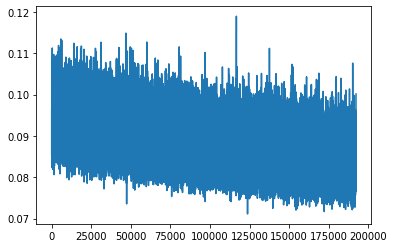

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


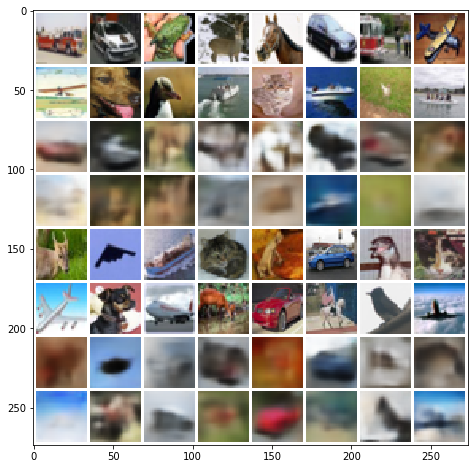

Mean squared dist: 0.045883484
epoch: 124 	 step:0 	 loss: 0.08329
epoch: 124 	 step:100 	 loss: 0.08122
epoch: 124 	 step:200 	 loss: 0.08226
epoch: 124 	 step:300 	 loss: 0.07793
epoch: 124 	 step:400 	 loss: 0.08186
epoch: 124 	 step:500 	 loss: 0.09169
epoch: 124 	 step:600 	 loss: 0.09065
epoch: 124 	 step:700 	 loss: 0.09336
epoch: 124 	 step:800 	 loss: 0.08231
epoch: 124 	 step:900 	 loss: 0.09841
epoch: 124 	 step:1000 	 loss: 0.07974
epoch: 124 	 step:1100 	 loss: 0.08584
epoch: 124 	 step:1200 	 loss: 0.08341
epoch: 124 	 step:1300 	 loss: 0.08593
epoch: 124 	 step:1400 	 loss: 0.08497
epoch: 124 	 step:1500 	 loss: 0.08977


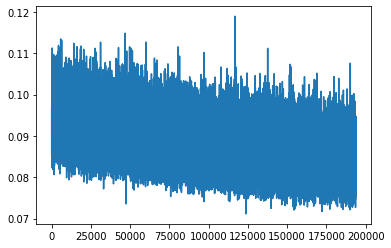

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


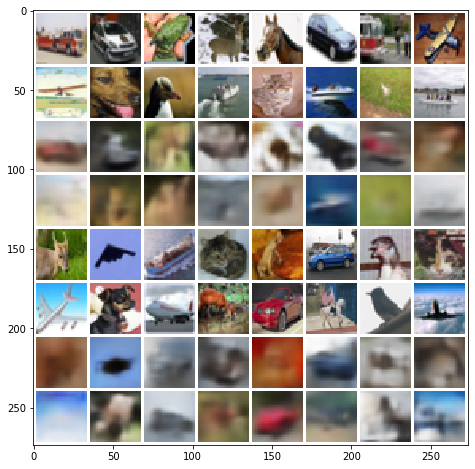

Mean squared dist: 0.045345806
epoch: 125 	 step:0 	 loss: 0.08051
epoch: 125 	 step:100 	 loss: 0.08163
epoch: 125 	 step:200 	 loss: 0.08439
epoch: 125 	 step:300 	 loss: 0.0788
epoch: 125 	 step:400 	 loss: 0.08773
epoch: 125 	 step:500 	 loss: 0.08031
epoch: 125 	 step:600 	 loss: 0.08896
epoch: 125 	 step:700 	 loss: 0.08816
epoch: 125 	 step:800 	 loss: 0.08721
epoch: 125 	 step:900 	 loss: 0.08617
epoch: 125 	 step:1000 	 loss: 0.08671
epoch: 125 	 step:1100 	 loss: 0.08746
epoch: 125 	 step:1200 	 loss: 0.07979
epoch: 125 	 step:1300 	 loss: 0.08627
epoch: 125 	 step:1400 	 loss: 0.08782
epoch: 125 	 step:1500 	 loss: 0.08315


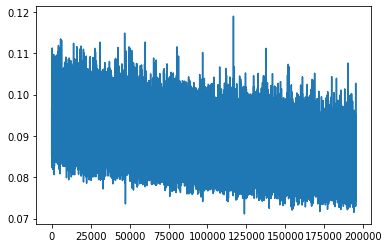

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


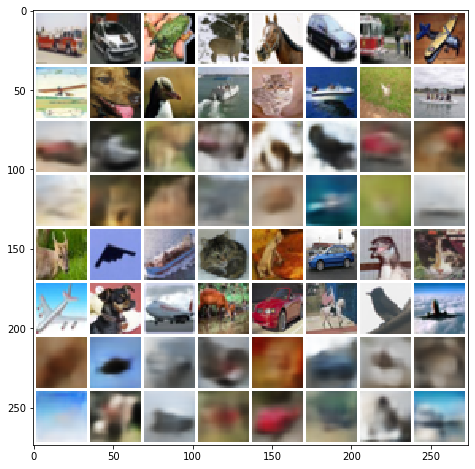

Mean squared dist: 0.04559056
epoch: 126 	 step:0 	 loss: 0.08157
epoch: 126 	 step:100 	 loss: 0.08246
epoch: 126 	 step:200 	 loss: 0.08217
epoch: 126 	 step:300 	 loss: 0.08471
epoch: 126 	 step:400 	 loss: 0.08156
epoch: 126 	 step:500 	 loss: 0.08259
epoch: 126 	 step:600 	 loss: 0.0755
epoch: 126 	 step:700 	 loss: 0.08502
epoch: 126 	 step:800 	 loss: 0.0773
epoch: 126 	 step:900 	 loss: 0.08091
epoch: 126 	 step:1000 	 loss: 0.08181
epoch: 126 	 step:1100 	 loss: 0.09585
epoch: 126 	 step:1200 	 loss: 0.08369
epoch: 126 	 step:1300 	 loss: 0.08513
epoch: 126 	 step:1400 	 loss: 0.08251
epoch: 126 	 step:1500 	 loss: 0.08581


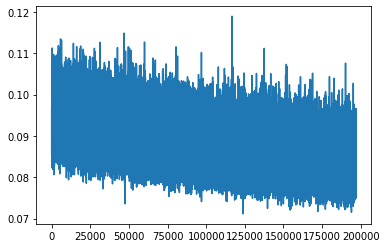

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


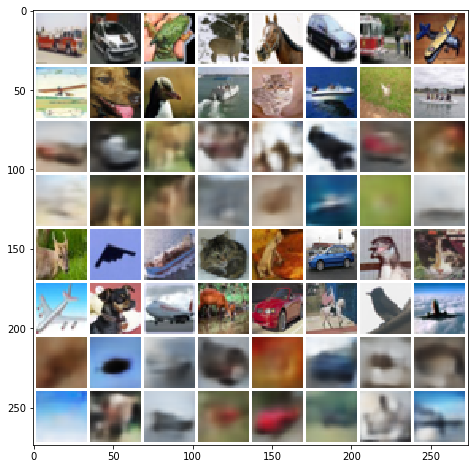

Mean squared dist: 0.04616626
epoch: 127 	 step:0 	 loss: 0.09062
epoch: 127 	 step:100 	 loss: 0.08409
epoch: 127 	 step:200 	 loss: 0.08344
epoch: 127 	 step:300 	 loss: 0.08002
epoch: 127 	 step:400 	 loss: 0.08243
epoch: 127 	 step:500 	 loss: 0.08036
epoch: 127 	 step:600 	 loss: 0.08111
epoch: 127 	 step:700 	 loss: 0.08272
epoch: 127 	 step:800 	 loss: 0.08873
epoch: 127 	 step:900 	 loss: 0.07683
epoch: 127 	 step:1000 	 loss: 0.08182
epoch: 127 	 step:1100 	 loss: 0.08308
epoch: 127 	 step:1200 	 loss: 0.08361
epoch: 127 	 step:1300 	 loss: 0.0811
epoch: 127 	 step:1400 	 loss: 0.0839
epoch: 127 	 step:1500 	 loss: 0.08498


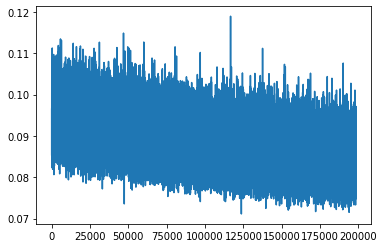

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


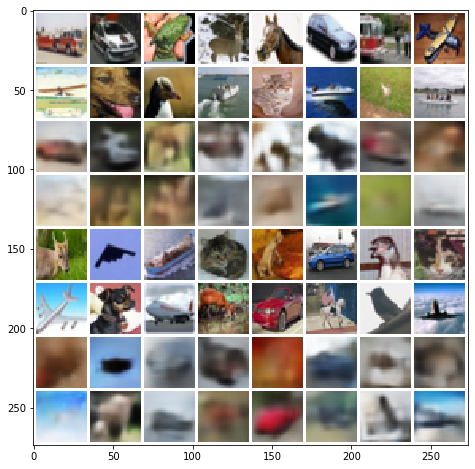

Mean squared dist: 0.046176497
epoch: 128 	 step:0 	 loss: 0.0803
epoch: 128 	 step:100 	 loss: 0.08458
epoch: 128 	 step:200 	 loss: 0.08829
epoch: 128 	 step:300 	 loss: 0.08843
epoch: 128 	 step:400 	 loss: 0.08242
epoch: 128 	 step:500 	 loss: 0.07774
epoch: 128 	 step:600 	 loss: 0.08474
epoch: 128 	 step:700 	 loss: 0.0787
epoch: 128 	 step:800 	 loss: 0.08423
epoch: 128 	 step:900 	 loss: 0.08813
epoch: 128 	 step:1000 	 loss: 0.08584
epoch: 128 	 step:1100 	 loss: 0.08298
epoch: 128 	 step:1200 	 loss: 0.08613
epoch: 128 	 step:1300 	 loss: 0.08997
epoch: 128 	 step:1400 	 loss: 0.08037
epoch: 128 	 step:1500 	 loss: 0.08956


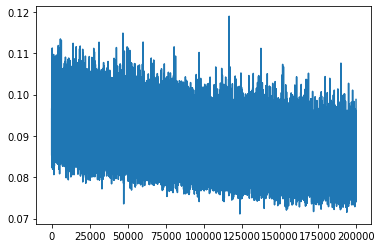

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


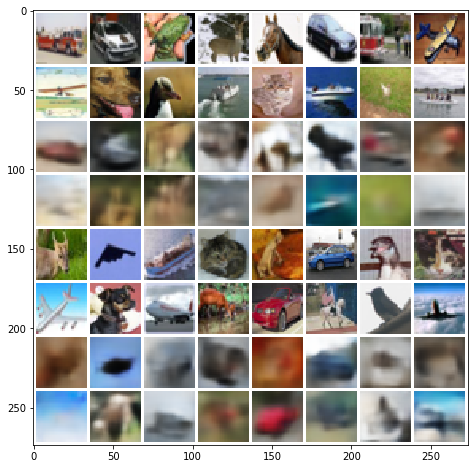

Mean squared dist: 0.046060394
epoch: 129 	 step:0 	 loss: 0.08801
epoch: 129 	 step:100 	 loss: 0.0864
epoch: 129 	 step:200 	 loss: 0.08337
epoch: 129 	 step:300 	 loss: 0.08028
epoch: 129 	 step:400 	 loss: 0.08198
epoch: 129 	 step:500 	 loss: 0.08297
epoch: 129 	 step:600 	 loss: 0.08745
epoch: 129 	 step:700 	 loss: 0.08277
epoch: 129 	 step:800 	 loss: 0.08268
epoch: 129 	 step:900 	 loss: 0.08741
epoch: 129 	 step:1000 	 loss: 0.08467
epoch: 129 	 step:1100 	 loss: 0.07878
epoch: 129 	 step:1200 	 loss: 0.08089
epoch: 129 	 step:1300 	 loss: 0.08336
epoch: 129 	 step:1400 	 loss: 0.0808
epoch: 129 	 step:1500 	 loss: 0.0871


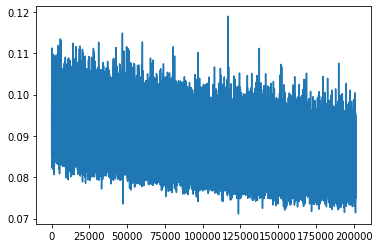

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


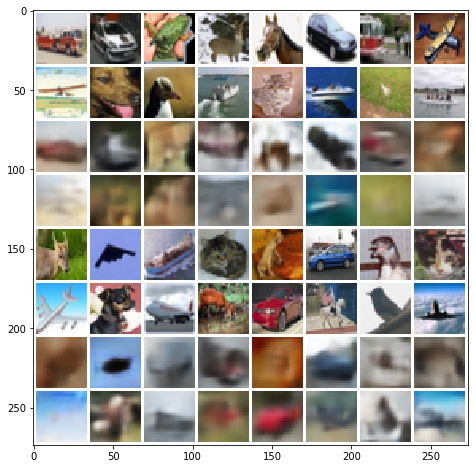

Mean squared dist: 0.045755293
epoch: 130 	 step:0 	 loss: 0.08263
epoch: 130 	 step:100 	 loss: 0.07875
epoch: 130 	 step:200 	 loss: 0.08608
epoch: 130 	 step:300 	 loss: 0.09038
epoch: 130 	 step:400 	 loss: 0.08474
epoch: 130 	 step:500 	 loss: 0.07888
epoch: 130 	 step:600 	 loss: 0.08998
epoch: 130 	 step:700 	 loss: 0.08177
epoch: 130 	 step:800 	 loss: 0.08451
epoch: 130 	 step:900 	 loss: 0.08683
epoch: 130 	 step:1000 	 loss: 0.08336
epoch: 130 	 step:1100 	 loss: 0.08529
epoch: 130 	 step:1200 	 loss: 0.08143
epoch: 130 	 step:1300 	 loss: 0.08266
epoch: 130 	 step:1400 	 loss: 0.0805
epoch: 130 	 step:1500 	 loss: 0.0874


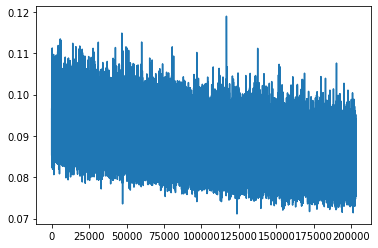

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


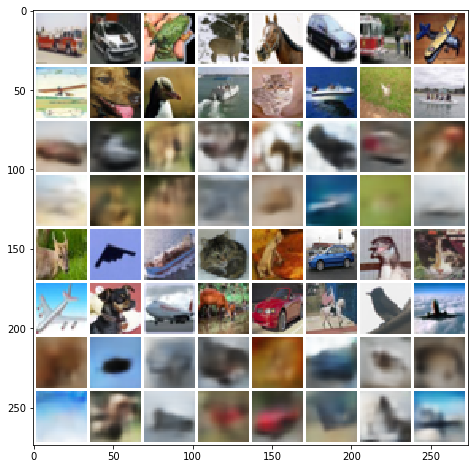

Mean squared dist: 0.04582929
epoch: 131 	 step:0 	 loss: 0.08492
epoch: 131 	 step:100 	 loss: 0.07831
epoch: 131 	 step:200 	 loss: 0.08645
epoch: 131 	 step:300 	 loss: 0.08202
epoch: 131 	 step:400 	 loss: 0.0876
epoch: 131 	 step:500 	 loss: 0.08193
epoch: 131 	 step:600 	 loss: 0.08825
epoch: 131 	 step:700 	 loss: 0.07541
epoch: 131 	 step:800 	 loss: 0.08129
epoch: 131 	 step:900 	 loss: 0.08333
epoch: 131 	 step:1000 	 loss: 0.08843
epoch: 131 	 step:1100 	 loss: 0.08483
epoch: 131 	 step:1200 	 loss: 0.07893
epoch: 131 	 step:1300 	 loss: 0.0756
epoch: 131 	 step:1400 	 loss: 0.07977
epoch: 131 	 step:1500 	 loss: 0.08325


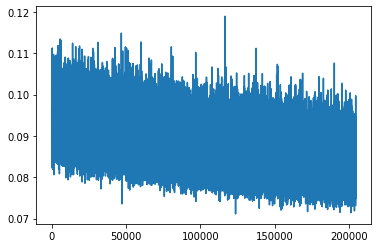

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


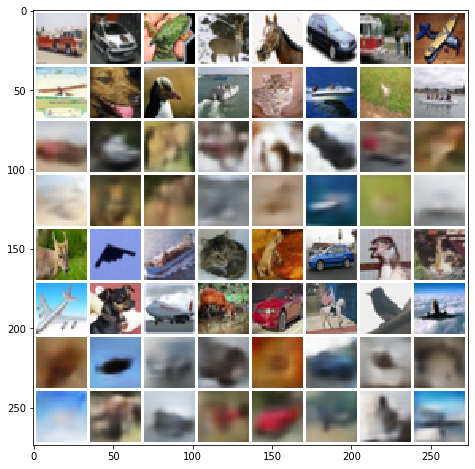

Mean squared dist: 0.045701772
epoch: 132 	 step:0 	 loss: 0.08194
epoch: 132 	 step:100 	 loss: 0.08556
epoch: 132 	 step:200 	 loss: 0.08241
epoch: 132 	 step:300 	 loss: 0.0806
epoch: 132 	 step:400 	 loss: 0.08473
epoch: 132 	 step:500 	 loss: 0.07627
epoch: 132 	 step:600 	 loss: 0.08512
epoch: 132 	 step:700 	 loss: 0.08162
epoch: 132 	 step:800 	 loss: 0.08708
epoch: 132 	 step:900 	 loss: 0.08293
epoch: 132 	 step:1000 	 loss: 0.08439
epoch: 132 	 step:1100 	 loss: 0.08276
epoch: 132 	 step:1200 	 loss: 0.08414
epoch: 132 	 step:1300 	 loss: 0.08293
epoch: 132 	 step:1400 	 loss: 0.08399
epoch: 132 	 step:1500 	 loss: 0.08402


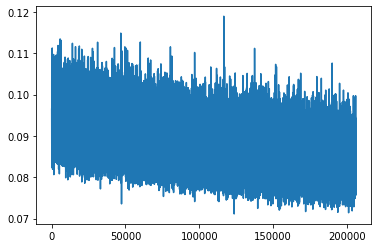

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


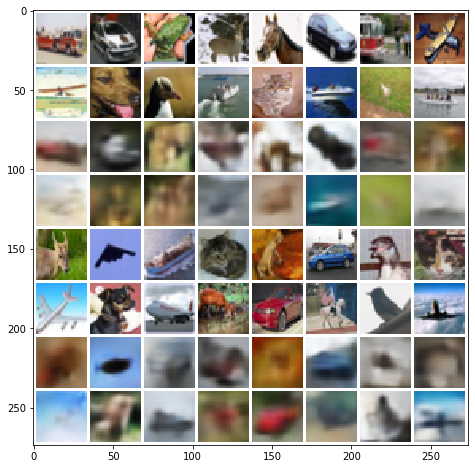

Mean squared dist: 0.04643841
epoch: 133 	 step:0 	 loss: 0.08381
epoch: 133 	 step:100 	 loss: 0.07512
epoch: 133 	 step:200 	 loss: 0.09005
epoch: 133 	 step:300 	 loss: 0.08611
epoch: 133 	 step:400 	 loss: 0.09141
epoch: 133 	 step:500 	 loss: 0.08354
epoch: 133 	 step:600 	 loss: 0.08155
epoch: 133 	 step:700 	 loss: 0.08425
epoch: 133 	 step:800 	 loss: 0.0811
epoch: 133 	 step:900 	 loss: 0.09127
epoch: 133 	 step:1000 	 loss: 0.08632
epoch: 133 	 step:1100 	 loss: 0.08845
epoch: 133 	 step:1200 	 loss: 0.09359
epoch: 133 	 step:1300 	 loss: 0.08829
epoch: 133 	 step:1400 	 loss: 0.08072
epoch: 133 	 step:1500 	 loss: 0.09235


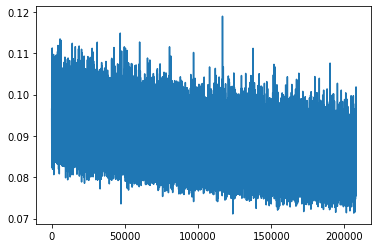

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


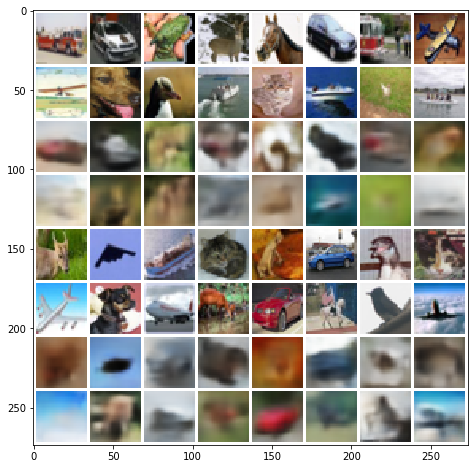

Mean squared dist: 0.046259638
epoch: 134 	 step:0 	 loss: 0.08041
epoch: 134 	 step:100 	 loss: 0.07834
epoch: 134 	 step:200 	 loss: 0.07728
epoch: 134 	 step:300 	 loss: 0.08106
epoch: 134 	 step:400 	 loss: 0.0871
epoch: 134 	 step:500 	 loss: 0.0845
epoch: 134 	 step:600 	 loss: 0.08516
epoch: 134 	 step:700 	 loss: 0.08193
epoch: 134 	 step:800 	 loss: 0.09728
epoch: 134 	 step:900 	 loss: 0.08662
epoch: 134 	 step:1000 	 loss: 0.08912
epoch: 134 	 step:1100 	 loss: 0.08399
epoch: 134 	 step:1200 	 loss: 0.08564
epoch: 134 	 step:1300 	 loss: 0.07929
epoch: 134 	 step:1400 	 loss: 0.07941
epoch: 134 	 step:1500 	 loss: 0.08004


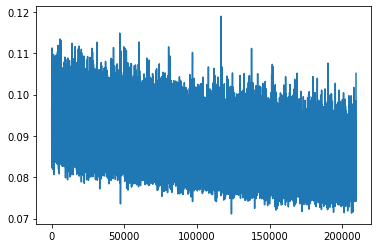

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


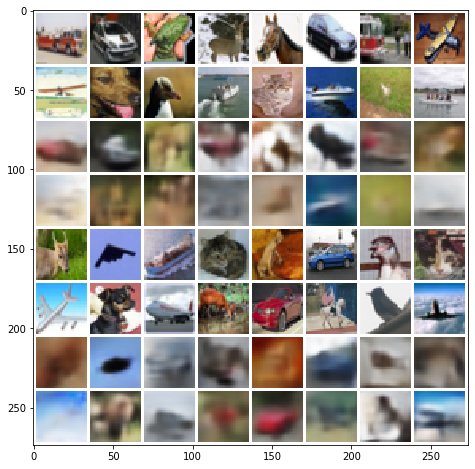

Mean squared dist: 0.046137884
epoch: 135 	 step:0 	 loss: 0.07832
epoch: 135 	 step:100 	 loss: 0.07963
epoch: 135 	 step:200 	 loss: 0.08969
epoch: 135 	 step:300 	 loss: 0.0815
epoch: 135 	 step:400 	 loss: 0.08
epoch: 135 	 step:500 	 loss: 0.08959
epoch: 135 	 step:600 	 loss: 0.08324
epoch: 135 	 step:700 	 loss: 0.08379
epoch: 135 	 step:800 	 loss: 0.07956
epoch: 135 	 step:900 	 loss: 0.08412
epoch: 135 	 step:1000 	 loss: 0.08581
epoch: 135 	 step:1100 	 loss: 0.08627
epoch: 135 	 step:1200 	 loss: 0.08707
epoch: 135 	 step:1300 	 loss: 0.07988
epoch: 135 	 step:1400 	 loss: 0.07863
epoch: 135 	 step:1500 	 loss: 0.08713


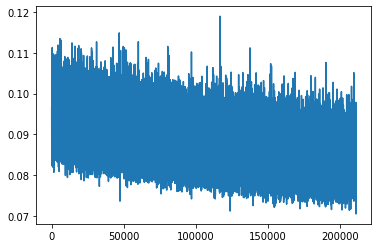

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


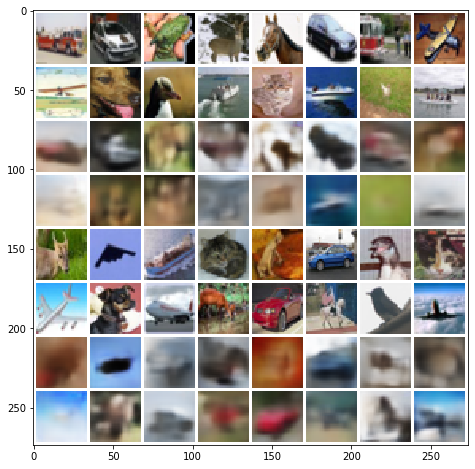

Mean squared dist: 0.046189565
epoch: 136 	 step:0 	 loss: 0.08289
epoch: 136 	 step:100 	 loss: 0.08764
epoch: 136 	 step:200 	 loss: 0.07983
epoch: 136 	 step:300 	 loss: 0.08394
epoch: 136 	 step:400 	 loss: 0.08151
epoch: 136 	 step:500 	 loss: 0.07748
epoch: 136 	 step:600 	 loss: 0.08604
epoch: 136 	 step:700 	 loss: 0.07887
epoch: 136 	 step:800 	 loss: 0.0792
epoch: 136 	 step:900 	 loss: 0.08341
epoch: 136 	 step:1000 	 loss: 0.08142
epoch: 136 	 step:1100 	 loss: 0.0857
epoch: 136 	 step:1200 	 loss: 0.0834
epoch: 136 	 step:1300 	 loss: 0.08288
epoch: 136 	 step:1400 	 loss: 0.08859
epoch: 136 	 step:1500 	 loss: 0.08276


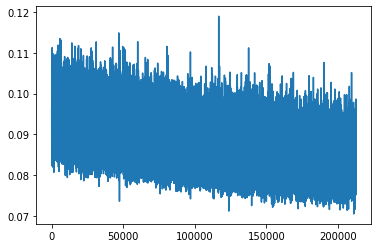

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


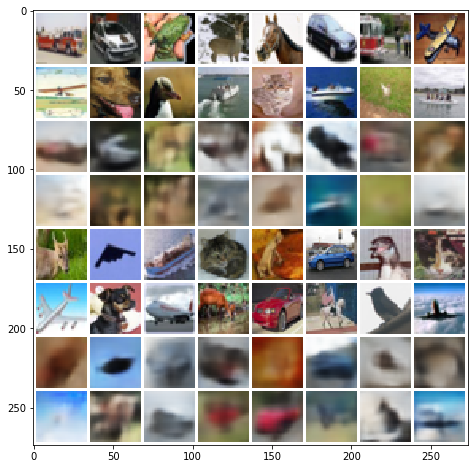

Mean squared dist: 0.046438828
epoch: 137 	 step:0 	 loss: 0.08604
epoch: 137 	 step:100 	 loss: 0.08095
epoch: 137 	 step:200 	 loss: 0.08377
epoch: 137 	 step:300 	 loss: 0.07922
epoch: 137 	 step:400 	 loss: 0.08416
epoch: 137 	 step:500 	 loss: 0.08028
epoch: 137 	 step:600 	 loss: 0.08478
epoch: 137 	 step:700 	 loss: 0.07877
epoch: 137 	 step:800 	 loss: 0.08465
epoch: 137 	 step:900 	 loss: 0.08898
epoch: 137 	 step:1000 	 loss: 0.08005
epoch: 137 	 step:1100 	 loss: 0.0815
epoch: 137 	 step:1200 	 loss: 0.08422
epoch: 137 	 step:1300 	 loss: 0.08358
epoch: 137 	 step:1400 	 loss: 0.08415
epoch: 137 	 step:1500 	 loss: 0.08535


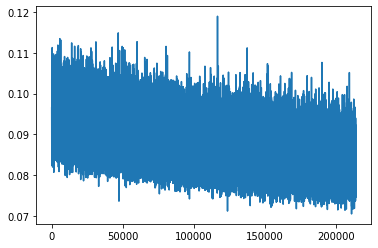

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


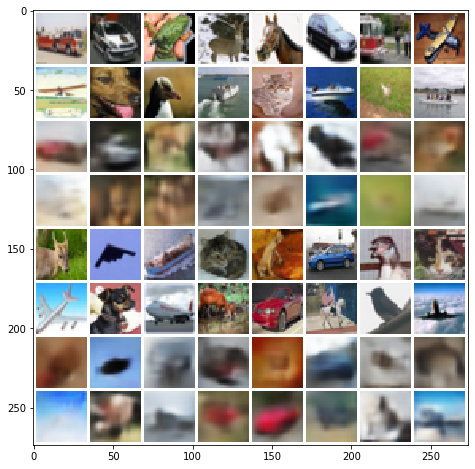

Mean squared dist: 0.046822857
epoch: 138 	 step:0 	 loss: 0.08087
epoch: 138 	 step:100 	 loss: 0.08685
epoch: 138 	 step:200 	 loss: 0.08754
epoch: 138 	 step:300 	 loss: 0.08303
epoch: 138 	 step:400 	 loss: 0.07977
epoch: 138 	 step:500 	 loss: 0.08339
epoch: 138 	 step:600 	 loss: 0.08156
epoch: 138 	 step:700 	 loss: 0.08154
epoch: 138 	 step:800 	 loss: 0.08297
epoch: 138 	 step:900 	 loss: 0.0866
epoch: 138 	 step:1000 	 loss: 0.08881
epoch: 138 	 step:1100 	 loss: 0.0834
epoch: 138 	 step:1200 	 loss: 0.0825
epoch: 138 	 step:1300 	 loss: 0.07974
epoch: 138 	 step:1400 	 loss: 0.08863
epoch: 138 	 step:1500 	 loss: 0.079


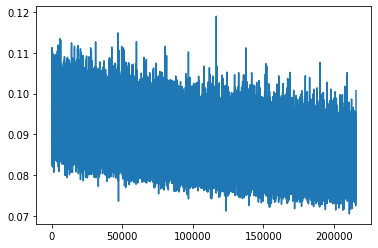

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


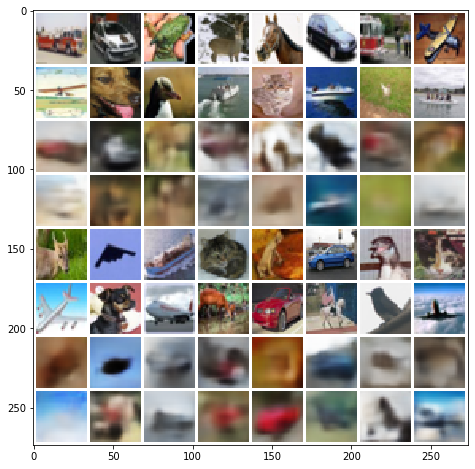

Mean squared dist: 0.04600149
epoch: 139 	 step:0 	 loss: 0.08614
epoch: 139 	 step:100 	 loss: 0.07808
epoch: 139 	 step:200 	 loss: 0.0925
epoch: 139 	 step:300 	 loss: 0.08765
epoch: 139 	 step:400 	 loss: 0.08688
epoch: 139 	 step:500 	 loss: 0.08261
epoch: 139 	 step:600 	 loss: 0.08294
epoch: 139 	 step:700 	 loss: 0.08425
epoch: 139 	 step:800 	 loss: 0.08152
epoch: 139 	 step:900 	 loss: 0.09042
epoch: 139 	 step:1000 	 loss: 0.08122
epoch: 139 	 step:1100 	 loss: 0.08666
epoch: 139 	 step:1200 	 loss: 0.08206
epoch: 139 	 step:1300 	 loss: 0.08802
epoch: 139 	 step:1400 	 loss: 0.08062
epoch: 139 	 step:1500 	 loss: 0.09021


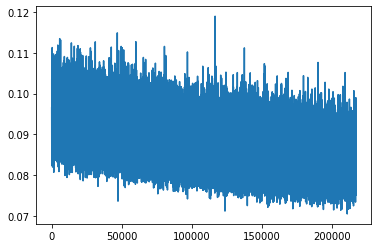

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


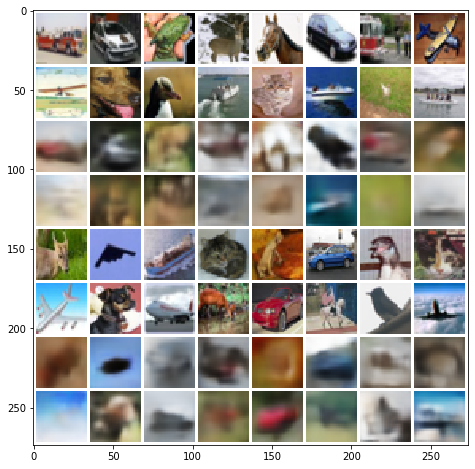

Mean squared dist: 0.04608264
epoch: 140 	 step:0 	 loss: 0.08025
epoch: 140 	 step:100 	 loss: 0.08118
epoch: 140 	 step:200 	 loss: 0.07973
epoch: 140 	 step:300 	 loss: 0.08157
epoch: 140 	 step:400 	 loss: 0.08742
epoch: 140 	 step:500 	 loss: 0.08785
epoch: 140 	 step:600 	 loss: 0.08952
epoch: 140 	 step:700 	 loss: 0.0837
epoch: 140 	 step:800 	 loss: 0.0773
epoch: 140 	 step:900 	 loss: 0.07721
epoch: 140 	 step:1000 	 loss: 0.08117
epoch: 140 	 step:1100 	 loss: 0.08692
epoch: 140 	 step:1200 	 loss: 0.08655
epoch: 140 	 step:1300 	 loss: 0.07611
epoch: 140 	 step:1400 	 loss: 0.08321
epoch: 140 	 step:1500 	 loss: 0.08291


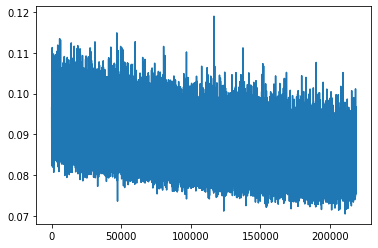

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


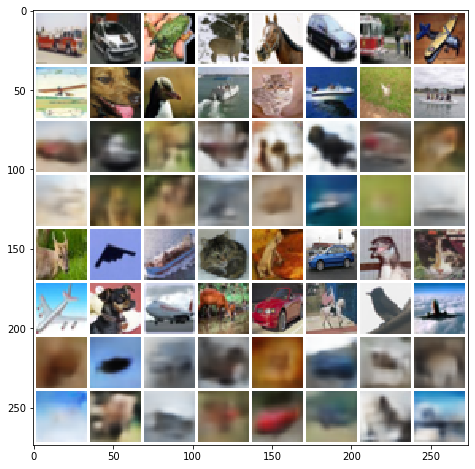

Mean squared dist: 0.045918345
epoch: 141 	 step:0 	 loss: 0.07972
epoch: 141 	 step:100 	 loss: 0.08002
epoch: 141 	 step:200 	 loss: 0.08397
epoch: 141 	 step:300 	 loss: 0.08354
epoch: 141 	 step:400 	 loss: 0.08387
epoch: 141 	 step:500 	 loss: 0.08169
epoch: 141 	 step:600 	 loss: 0.08334
epoch: 141 	 step:700 	 loss: 0.08355
epoch: 141 	 step:800 	 loss: 0.08104
epoch: 141 	 step:900 	 loss: 0.08262
epoch: 141 	 step:1000 	 loss: 0.08328
epoch: 141 	 step:1100 	 loss: 0.08812
epoch: 141 	 step:1200 	 loss: 0.08017
epoch: 141 	 step:1300 	 loss: 0.08286
epoch: 141 	 step:1400 	 loss: 0.08703
epoch: 141 	 step:1500 	 loss: 0.08522


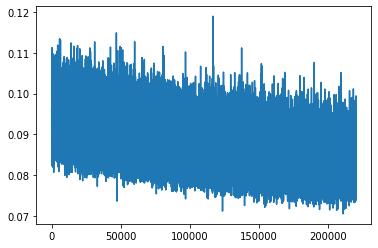

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


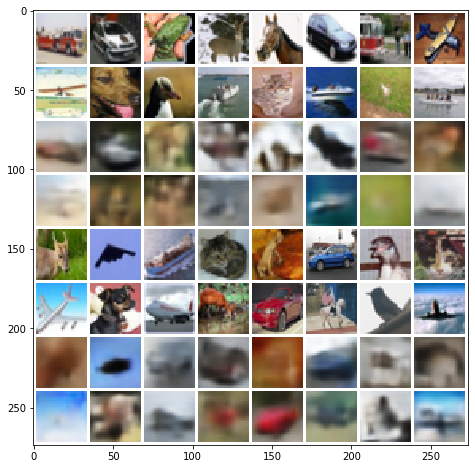

Mean squared dist: 0.046631377
epoch: 142 	 step:0 	 loss: 0.08101
epoch: 142 	 step:100 	 loss: 0.07616
epoch: 142 	 step:200 	 loss: 0.08004
epoch: 142 	 step:300 	 loss: 0.07594
epoch: 142 	 step:400 	 loss: 0.08685
epoch: 142 	 step:500 	 loss: 0.08706
epoch: 142 	 step:600 	 loss: 0.09185
epoch: 142 	 step:700 	 loss: 0.08452
epoch: 142 	 step:800 	 loss: 0.08586
epoch: 142 	 step:900 	 loss: 0.08275
epoch: 142 	 step:1000 	 loss: 0.08808
epoch: 142 	 step:1100 	 loss: 0.08534
epoch: 142 	 step:1200 	 loss: 0.08296
epoch: 142 	 step:1300 	 loss: 0.08222
epoch: 142 	 step:1400 	 loss: 0.08046
epoch: 142 	 step:1500 	 loss: 0.08852


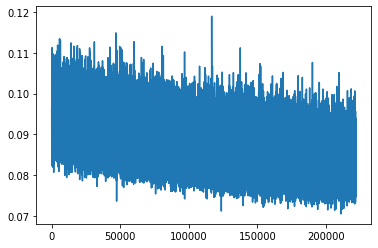

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


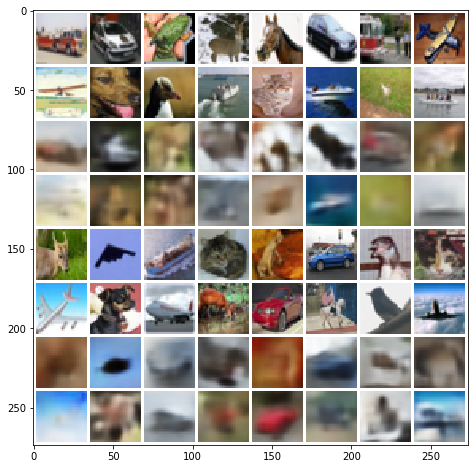

Mean squared dist: 0.045900118
epoch: 143 	 step:0 	 loss: 0.08181
epoch: 143 	 step:100 	 loss: 0.08146
epoch: 143 	 step:200 	 loss: 0.0783
epoch: 143 	 step:300 	 loss: 0.08296
epoch: 143 	 step:400 	 loss: 0.08223
epoch: 143 	 step:500 	 loss: 0.07943
epoch: 143 	 step:600 	 loss: 0.08302
epoch: 143 	 step:700 	 loss: 0.08138
epoch: 143 	 step:800 	 loss: 0.08407
epoch: 143 	 step:900 	 loss: 0.08389
epoch: 143 	 step:1000 	 loss: 0.07899
epoch: 143 	 step:1100 	 loss: 0.08957
epoch: 143 	 step:1200 	 loss: 0.08419
epoch: 143 	 step:1300 	 loss: 0.08535
epoch: 143 	 step:1400 	 loss: 0.08501
epoch: 143 	 step:1500 	 loss: 0.08829


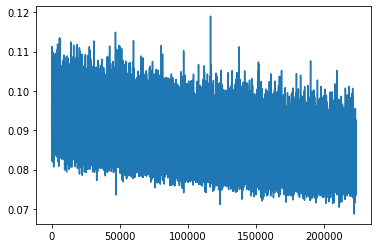

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


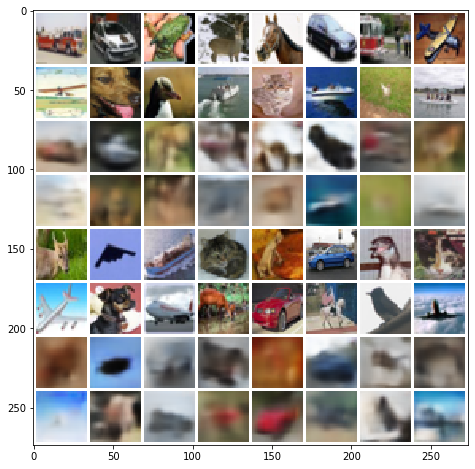

Mean squared dist: 0.045897834
epoch: 144 	 step:0 	 loss: 0.08828
epoch: 144 	 step:100 	 loss: 0.08478
epoch: 144 	 step:200 	 loss: 0.07844
epoch: 144 	 step:300 	 loss: 0.0808
epoch: 144 	 step:400 	 loss: 0.08327
epoch: 144 	 step:500 	 loss: 0.08485
epoch: 144 	 step:600 	 loss: 0.08545
epoch: 144 	 step:700 	 loss: 0.08121
epoch: 144 	 step:800 	 loss: 0.08545
epoch: 144 	 step:900 	 loss: 0.087
epoch: 144 	 step:1000 	 loss: 0.08327
epoch: 144 	 step:1100 	 loss: 0.08319
epoch: 144 	 step:1200 	 loss: 0.08458
epoch: 144 	 step:1300 	 loss: 0.08041
epoch: 144 	 step:1400 	 loss: 0.08323
epoch: 144 	 step:1500 	 loss: 0.08131


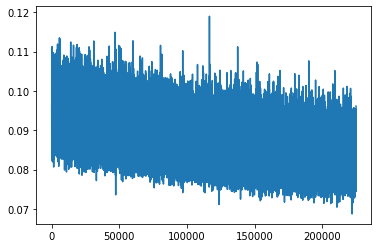

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


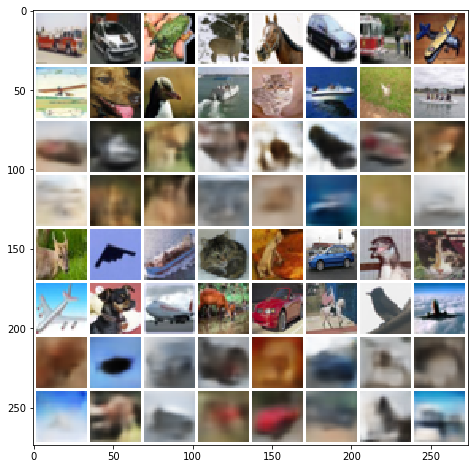

Mean squared dist: 0.04633419
epoch: 145 	 step:0 	 loss: 0.08335
epoch: 145 	 step:100 	 loss: 0.08301
epoch: 145 	 step:200 	 loss: 0.0812
epoch: 145 	 step:300 	 loss: 0.08065
epoch: 145 	 step:400 	 loss: 0.08103
epoch: 145 	 step:500 	 loss: 0.08297
epoch: 145 	 step:600 	 loss: 0.07982
epoch: 145 	 step:700 	 loss: 0.08192
epoch: 145 	 step:800 	 loss: 0.08135
epoch: 145 	 step:900 	 loss: 0.08082
epoch: 145 	 step:1000 	 loss: 0.09123
epoch: 145 	 step:1100 	 loss: 0.07838
epoch: 145 	 step:1200 	 loss: 0.07496
epoch: 145 	 step:1300 	 loss: 0.09078
epoch: 145 	 step:1400 	 loss: 0.08243
epoch: 145 	 step:1500 	 loss: 0.09335


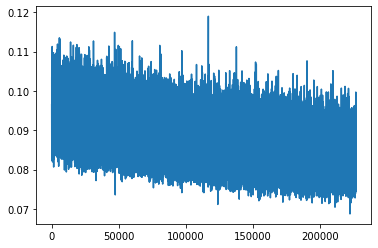

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


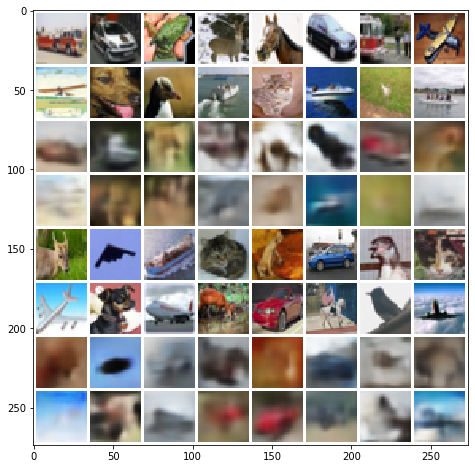

Mean squared dist: 0.04596039
epoch: 146 	 step:0 	 loss: 0.08883
epoch: 146 	 step:100 	 loss: 0.08362
epoch: 146 	 step:200 	 loss: 0.08464
epoch: 146 	 step:300 	 loss: 0.0812
epoch: 146 	 step:400 	 loss: 0.08641
epoch: 146 	 step:500 	 loss: 0.08698
epoch: 146 	 step:600 	 loss: 0.08139
epoch: 146 	 step:700 	 loss: 0.0846
epoch: 146 	 step:800 	 loss: 0.08723
epoch: 146 	 step:900 	 loss: 0.08312
epoch: 146 	 step:1000 	 loss: 0.08164
epoch: 146 	 step:1100 	 loss: 0.08221
epoch: 146 	 step:1200 	 loss: 0.07518
epoch: 146 	 step:1300 	 loss: 0.08884
epoch: 146 	 step:1400 	 loss: 0.07754
epoch: 146 	 step:1500 	 loss: 0.08393


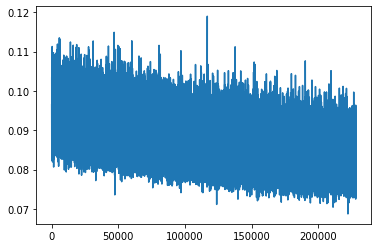

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


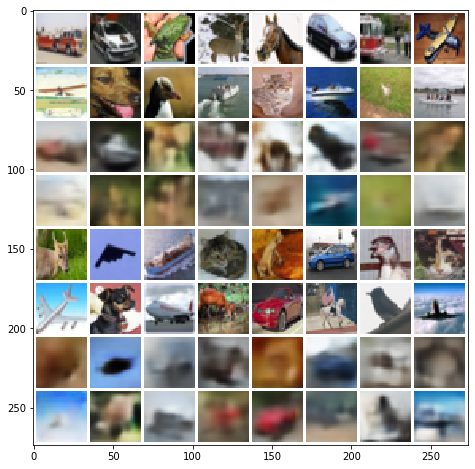

Mean squared dist: 0.04634515
epoch: 147 	 step:0 	 loss: 0.08133
epoch: 147 	 step:100 	 loss: 0.08399
epoch: 147 	 step:200 	 loss: 0.08127
epoch: 147 	 step:300 	 loss: 0.08309
epoch: 147 	 step:400 	 loss: 0.08711
epoch: 147 	 step:500 	 loss: 0.07961
epoch: 147 	 step:600 	 loss: 0.08157
epoch: 147 	 step:700 	 loss: 0.07565
epoch: 147 	 step:800 	 loss: 0.0815
epoch: 147 	 step:900 	 loss: 0.09007
epoch: 147 	 step:1000 	 loss: 0.08301
epoch: 147 	 step:1100 	 loss: 0.08876
epoch: 147 	 step:1200 	 loss: 0.08392
epoch: 147 	 step:1300 	 loss: 0.08484
epoch: 147 	 step:1400 	 loss: 0.08287
epoch: 147 	 step:1500 	 loss: 0.0828


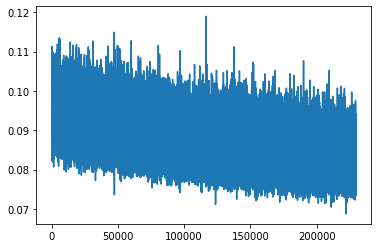

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


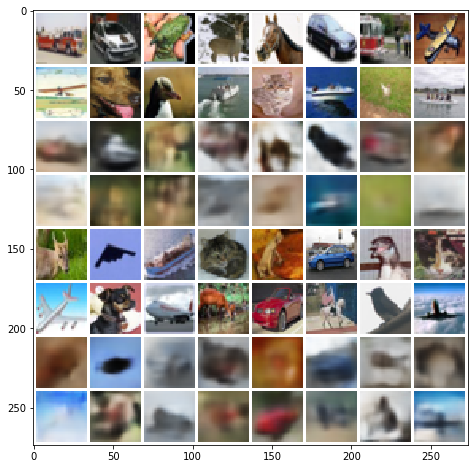

Mean squared dist: 0.04538643
epoch: 148 	 step:0 	 loss: 0.08149
epoch: 148 	 step:100 	 loss: 0.08182
epoch: 148 	 step:200 	 loss: 0.09132
epoch: 148 	 step:300 	 loss: 0.08302
epoch: 148 	 step:400 	 loss: 0.08047
epoch: 148 	 step:500 	 loss: 0.08458
epoch: 148 	 step:600 	 loss: 0.08302
epoch: 148 	 step:700 	 loss: 0.08169
epoch: 148 	 step:800 	 loss: 0.08347
epoch: 148 	 step:900 	 loss: 0.07946
epoch: 148 	 step:1000 	 loss: 0.07919
epoch: 148 	 step:1100 	 loss: 0.07982
epoch: 148 	 step:1200 	 loss: 0.09067
epoch: 148 	 step:1300 	 loss: 0.08842
epoch: 148 	 step:1400 	 loss: 0.07774
epoch: 148 	 step:1500 	 loss: 0.08015


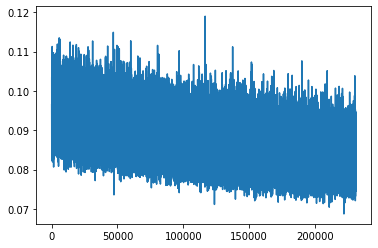

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


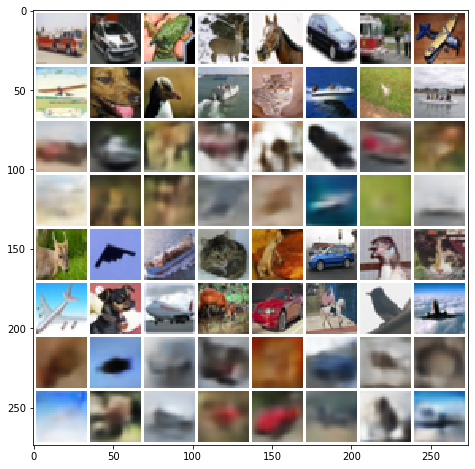

Mean squared dist: 0.04596478
epoch: 149 	 step:0 	 loss: 0.0817
epoch: 149 	 step:100 	 loss: 0.08124
epoch: 149 	 step:200 	 loss: 0.08677
epoch: 149 	 step:300 	 loss: 0.08075
epoch: 149 	 step:400 	 loss: 0.0797
epoch: 149 	 step:500 	 loss: 0.07752
epoch: 149 	 step:600 	 loss: 0.08735
epoch: 149 	 step:700 	 loss: 0.08327
epoch: 149 	 step:800 	 loss: 0.08428
epoch: 149 	 step:900 	 loss: 0.08233
epoch: 149 	 step:1000 	 loss: 0.081
epoch: 149 	 step:1100 	 loss: 0.07813
epoch: 149 	 step:1200 	 loss: 0.08218
epoch: 149 	 step:1300 	 loss: 0.08078
epoch: 149 	 step:1400 	 loss: 0.08568
epoch: 149 	 step:1500 	 loss: 0.08091


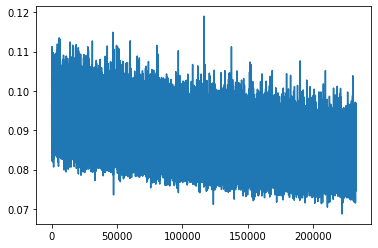

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


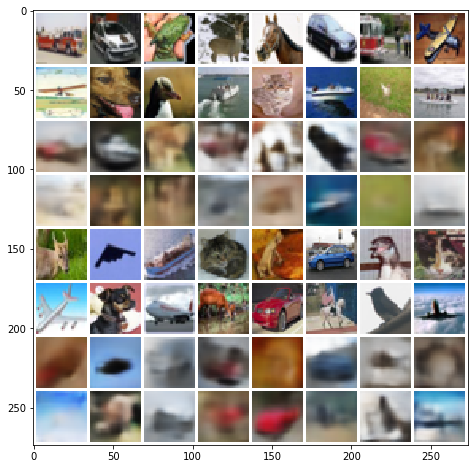

Mean squared dist: 0.04620858
epoch: 150 	 step:0 	 loss: 0.0771
epoch: 150 	 step:100 	 loss: 0.07906
epoch: 150 	 step:200 	 loss: 0.08717
epoch: 150 	 step:300 	 loss: 0.08753
epoch: 150 	 step:400 	 loss: 0.08191
epoch: 150 	 step:500 	 loss: 0.0796
epoch: 150 	 step:600 	 loss: 0.08261
epoch: 150 	 step:700 	 loss: 0.07569
epoch: 150 	 step:800 	 loss: 0.08473
epoch: 150 	 step:900 	 loss: 0.07986
epoch: 150 	 step:1000 	 loss: 0.07975
epoch: 150 	 step:1100 	 loss: 0.07999
epoch: 150 	 step:1200 	 loss: 0.08269
epoch: 150 	 step:1300 	 loss: 0.08389
epoch: 150 	 step:1400 	 loss: 0.08534
epoch: 150 	 step:1500 	 loss: 0.08751


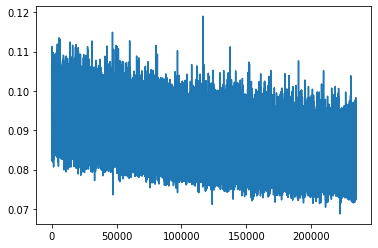

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


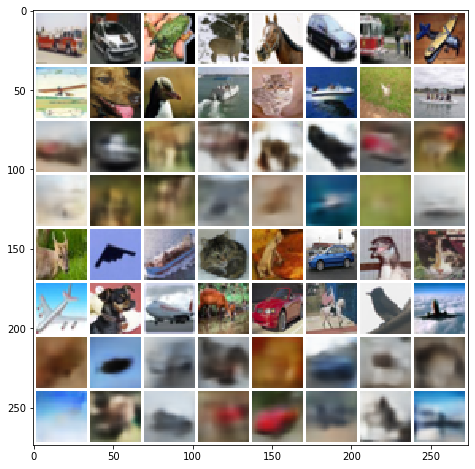

Mean squared dist: 0.0462226


In [23]:
### TRAIN MODEL ###

import time
num_epochs = 150

train_model(gen, opt, device, dataloader['train'], epochs=num_epochs)

gen_weights = gen.state_dict().copy()

torch.save(gen_weights, "../cache/CNN/ConvNet64Cifar10_{0:04d}_{1}.sd".format(num_epochs, time.strftime("%Y%m%d_%H%M%S")))

In [19]:
### LOAD MODEL ####

gen = models.ConvNet(imsize=imsize, outsize=imsize, s=64)

gen.load_state_dict(torch.load("/home/shared/phase-retrieval/models/CNNnet_CelebA/ConvNet64Cifar10_1.sd", map_location={'cuda:1': device.__str__()}));
gen.eval();

Version 0.6
Additional padding to fit 2 exp: (0, 0)
Kern size: 4096


In [24]:
# Calculate test predictions #

test_original, test_predicted = test_generator(gen, device, dataloader['test'])
print(test_predicted.shape)

/home/alobe101/.local/lib/python3.6/site-packages/torch/nn/modules/upsampling.py:129: UserWarning: nn.UpsamplingNearest2d is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.{} is deprecated. Use nn.functional.interpolate instead.".format(self.name))


(8000, 3, 32, 32)


In [25]:
### CACHE RESULTS ###

import pickle
pickle.dump(test_original, open( "/home/shared/phase-retrieval/test/CNNnet_Cifar10/original_2.p", "wb" ))
pickle.dump(test_predicted, open( "/home/shared/phase-retrieval/test/CNNnet_Cifar10/predicted_2.p", "wb" ) )

In [31]:
### LOAD RESULTS ###
import pickle

test_original = pickle.load(open( "/home/shared/phase-retrieval/test/CNNnet_Cifar10/original_1.p", "rb" ))
test_predicted = pickle.load(open( "/home/shared/phase-retrieval/test/CNNnet_Cifar10/predicted_1.p", "rb" ))

In [32]:
# Benchmark test predictions #

benchmark(pred=test_predicted[:1024], true=test_original[:1024], check_all=True)

Signal error:
  MSE: 0.04458231383364364, std: 0.03569284960234843
  MAE: 0.15403045766106516, std: 0.06463308911895192
  SSIM: 0.3210388499894884, std: 0.16710277814782631
  FASI-MSE: 0.04578806713652739, std: 0.0335807735801875
  FASI-MAE: 0.1570668714466592, std: 0.05962703349449717
  COCO-MSE: 0.027302934766712382, std: 0.015193516366639351

Magnitude error:
  MSE Magnitude: 14.672042942231714, std: 7.090735831294476

Image constraints:
  Imag part = 0.0 - should be very close to 0
  Real part is in [0.00, 1.00] - should be in [0, 1]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


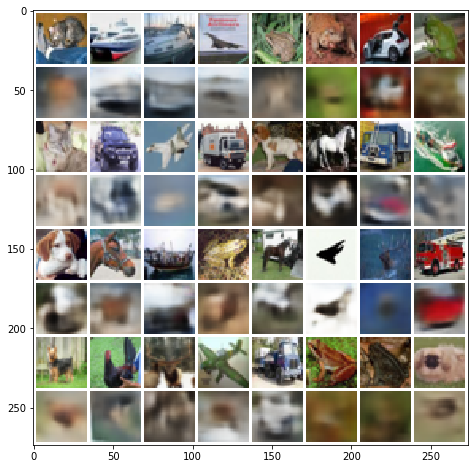

In [27]:
# Print test predictions 2 #
to_plot = np.stack([test_original[:32].reshape(4, 8*3, 32, 32), 
                    test_predicted[:32].reshape(4, 8*3, 32, 32)], axis=1).reshape(-1, 3, 32, 32)

plot_grid(to_plot, figsize=(8,8), file="../out/e2e/cifar10/ConvNet64Cifar10_2.png")

## Evaluation for different CNN  (1024 samples)

| Nr | Loss | Size | epochs | MSE | MAE | SSIM | FASI-MSE | FASI-MAE | COCO-MSE | MSE Magn
| --- | --- | --- | --- | --- | --- | --- | --- |
| 1 | MAE | 64 | 100 | 0.04458 | 0.1540 | 0.3210 | 0.04579 | 0.1571 | 0.02730 | 14.67
| 2 | MAE | 64 | 250 | 0.04598 | 0.1573 | 0.3055 | 0.04633 | 0.1592 | 0.02835 | 13.85


In [33]:
### Exchange original phase with FC Net computed phase ###

orig_fft = np.fft.fft2(test_original[:1024])
orig_magn = np.abs(orig_fft)
orig_phase = np.angle(orig_fft)
test_fft = np.fft.fft2(test_predicted[:1024])
test_magn = np.abs(test_fft)
test_Phase = np.angle(test_fft)

Combined = orig_magn * np.exp(1j * test_Phase)
combined = np.fft.ifft2(Combined)

In [34]:
# Benchmark predicted phase with original magnitude #

benchmark(pred=combined, true=test_original[:1024], check_all=True)

Signal error:
  MSE: 0.060267238520175306, std: 0.0442631500958149
  MAE: 0.18085927709380417, std: 0.07053386821340905


/home/alobe101/.local/lib/python3.6/site-packages/skimage/measure/_structural_similarity.py:155: UserWarning: Inputs have mismatched dtype.  Setting data_range based on X.dtype.
  warn("Inputs have mismatched dtype.  Setting data_range based on "


  SSIM: 0.24653536453424085, std: 0.16582968412793847
  FASI-MSE: 0.05844716089817283, std: 0.03825799645449187
  FASI-MAE: 0.17976004659330547, std: 0.06266129795694923
  COCO-MSE: 0.034155745350096994, std: 0.01864352333195906

Magnitude error:
  MSE Magnitude: 7.139791787852201e-30, std: 2.9785364892391462e-30

Image constraints:
  Imag part = -3.5711518377981094e-35 - should be very close to 0
  Real part is in [-0.87, 2.06] - should be in [0, 1]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


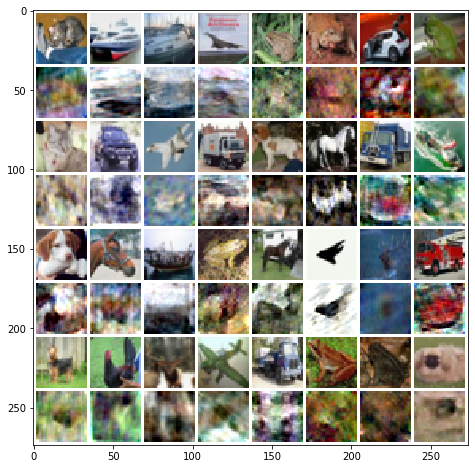

In [30]:
# Print test predictions with original magnitue #
to_plot = np.stack([test_original[:32].reshape(4, 8*3, 32, 32), 
                    np.real(combined)[:32].reshape(4, 8*3, 32, 32)], axis=1).reshape(-1, 3, 32, 32)
                
plot_grid(to_plot, figsize=(8,8), file="../out/e2e/cifar10/ConvNet64Cifar10_2_origMagn.png")


## Evaluation for different CNN models with original magnitudes (first 1024 test samples)

| Type | MSE | MAE | SSIM | FASI-MSE | FASI-MAE | COCO-MSE | MSE Magn | \[min,max\]
| --- | --- | --- | --- | --- | --- |
| 1 | 
| 2 | 0.06172 | 0.18360 | 0.2323 | 0.05842 | 0.1802 | 0.03455 | ~0 | 

Signal error:
  MSE: 0.060267238520175306, std: 0.0442631500958149
  MAE: 0.18085927709380417, std: 0.07053386821340905

/home/alobe101/.local/lib/python3.6/site-packages/skimage/measure/_structural_similarity.py:155: UserWarning: Inputs have mismatched dtype.  Setting data_range based on X.dtype.
  warn("Inputs have mismatched dtype.  Setting data_range based on "

  SSIM: 0.24653536453424085, std: 0.16582968412793847
  FASI-MSE: 0.05844716089817283, std: 0.03825799645449187
  FASI-MAE: 0.17976004659330547, std: 0.06266129795694923
  COCO-MSE: 0.034155745350096994, std: 0.01864352333195906

Magnitude error:
  MSE Magnitude: 7.139791787852201e-30, std: 2.9785364892391462e-30

Image constraints:
  Imag part = -3.5711518377981094e-35 - should be very close to 0
  Real part is in [-0.87, 2.06] - should be in [0, 1]
